### 📦 Importar librerías

In [ ]:
# =========================
# 📦 INSTALACIÓN DE PAQUETES (si es necesario)
# =========================
# !pip install pandas seaborn matplotlib scikit-learn scipy hdbscan

# =========================
# 🔧 SISTEMA Y UTILIDADES
# =========================
import importlib
import os
import sys

# =========================
# 📦 MANIPULACIÓN DE DATOS
# =========================
import pandas as pd
import numpy as np

# =========================
# 📊 VISUALIZACIÓN
# =========================
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import matplotlib.cm as cm
from matplotlib.ticker import FixedLocator, FixedFormatter

# =========================
# ⚙️ PREPROCESAMIENTO
# =========================
from sklearn.preprocessing import (
    LabelEncoder, StandardScaler, OneHotEncoder, RobustScaler
)

# =========================
# 📉 REDUCCIÓN DE DIMENSIONALIDAD
# =========================
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# =========================
# 🔍 CLUSTERING
# =========================
from sklearn.cluster import (
    KMeans, AgglomerativeClustering, Birch,
    MiniBatchKMeans, SpectralClustering
)
from sklearn.mixture import GaussianMixture
import hdbscan

# =========================
# 🌳 CLASIFICACIÓN
# =========================
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# =========================
# 📈 EVALUACIÓN DE CLUSTERING
# =========================
from sklearn.metrics import (
    silhouette_score, silhouette_samples,
    davies_bouldin_score, calinski_harabasz_score,
    pairwise_distances
)
from scipy.spatial.distance import cdist, euclidean
from scipy.stats import entropy

# =========================
# 🌿 JERARQUÍA / DENDROGRAMA
# =========================
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy.cluster.hierarchy as sch


### 🧹 Carga y Limpieza de datos


In [ ]:
from google.colab import drive
drive.mount('/content/Drive')

#Ruta nico
ventas = pd.read_excel('/content/Drive/MyDrive/Bases/Ventas Gnrl V1.xlsx', sheet_name='Hoja2')
clientes=pd.read_excel('/content/Drive/MyDrive/Bases/Clientes.xlsx')

#Ruta cami
#ventas = pd.read_excel('/content/Drive/MyDrive/Maestria/3er Semestre/Trabajo de grado I/Bases/Ventas Gnrl V1.xlsx', sheet_name='Hoja2')
#clientes = pd.read_excel('/content/Drive/MyDrive/Maestria/3er Semestre/Trabajo de grado I/Bases/Clientes.xlsx')

Mounted at /content/Drive


In [ ]:
# LIMPIEZA Y PREPROCESAMIENTO
# Identificar valores faltantes
def check_missing(data):
    return data.isnull().sum()

missing_summary = check_missing(ventas)
print("Valores faltantes por columna:")
print(missing_summary)

# Manejo de valores nulos
categorical_columns = ventas.select_dtypes(include=['object']).columns
for col in categorical_columns:
    ventas[col] = ventas[col].fillna('NA')

numerical_columns = ventas.select_dtypes(include=['float64', 'int64']).columns
for col in numerical_columns:
    ventas[col] = ventas[col].fillna(0)

# Conversión de tipos de datos
ventas['Valor plan'] = ventas['Valor plan'].astype(str).str.replace('.', '', regex=False)
ventas['Valor plan'] = pd.to_numeric(ventas['Valor plan'], errors='coerce')

# Conversión de fechas
fecha_columns = [col for col in ventas.columns if 'fecha' in col]
for col in fecha_columns:
    ventas[col] = pd.to_datetime(ventas[col], errors='coerce')

# Eliminación de duplicados
ventas.drop_duplicates(inplace=True)

# Asegurar que el campo 'rut' sea categórico
if 'rut' in ventas.columns:
    ventas['rut'] = ventas['rut'].astype(str)

# Identificar categorías raras
def consolidate_categories(column, threshold=10):
    freqs = ventas[column].value_counts()
    return ventas[column].apply(lambda x: 'Otros' if freqs[x] < threshold else x)

if 'Canal' in ventas.columns:
    ventas['Canal'] = consolidate_categories('Canal')

# Filtrar fechas fuera de rango esperado
if 'Fecha ingresada' in ventas.columns:
    ventas = ventas[(ventas['Fecha ingresada'] > '2020-01-01') & (ventas['Fecha ingresada'] < pd.Timestamp('today'))]

# 3️⃣ TRANSFORMACIÓN DE FECHAS
ventas['dias_desde_ingreso'] = (pd.Timestamp('today') - ventas['Fecha ingresada']).dt.days
ventas['duracion estado actual'] = (ventas['Fecha estado actual'] - ventas['Fecha ingresada']).dt.days

# Eliminar valores negativos en 'duracion estado actual'
ventas['duracion estado actual'] = np.where(ventas['duracion estado actual'] < 0, np.nan, ventas['duracion estado actual'])

# 4️⃣ CREACIÓN DE VARIABLES ADICIONALES
ventas['churn potencial'] = ventas['Estado actual'].apply(lambda x: 1 if x in ['Cancelado', 'Prospecto'] else 0)

ventas['indice descuento'] = ventas['Descuento'].astype(str).str.lower().apply(lambda x: 1 if 'dscto' in x else 0)

ventas['clv estimado'] = ventas['Valor plan'] * 24

# Extrae solo el número sin el "GB"
ventas['segmento plan'] = ventas['Plan'].str.extract(r'(\d+)')

# Llena los valores nulos con la moda (ya como número)
ventas['segmento plan'].fillna(ventas['segmento plan'].mode()[0], inplace=True)

# Convierte la columna a tipo numérico
ventas['segmento plan'] = ventas['segmento plan'].astype(int)


segment_avg = ventas.groupby('segmento plan')['Valor plan'].mean().reset_index()
segment_avg.columns = ['segmento plan', 'Promedio gasto segmento']
ventas = ventas.merge(segment_avg, on='segmento plan', how='left')

# 5️⃣ MANEJO DE OUTLIERS
for col in numerical_columns:
    Q1 = ventas[col].quantile(0.25)
    Q3 = ventas[col].quantile(0.75)
    lower_bound = ventas[col].quantile(0.05)
    upper_bound = ventas[col].quantile(0.95)
    ventas[col] = np.where(ventas[col] < lower_bound, lower_bound,
                           np.where(ventas[col] > upper_bound, upper_bound, ventas[col]))

Valores faltantes por columna:
Orden                        0
Rut                          0
Estado actual                0
Fecha estado actual          0
Sub estado actual         4607
Canal                        0
Fecha ingresada              0
Fecha documento/pago      1893
Empresa despacho          1725
Bodega logistica             0
Nombre region                4
Nombre provincia             4
Nombre comuna                4
Nombre localidad           719
Nombre calle                 9
Numero calle                 0
Ejecutivo venta              0
Tipo venta                   0
Vertical                     4
Limite credito               0
Script                       4
Origen llamada               0
Campana                      0
Valor total inicial          0
Modalidad contrato           0
Cantidad cuotas              0
Portabilidad                 0
Nombre operadora          5531
Nombre modalidad pago     5531
Deuda portabilidad       10695
Plan                         0
Valor pl

<ipython-input-4-aae00584e215>:65: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  ventas['segmento plan'].fillna(ventas['segmento plan'].mode()[0], inplace=True)


In [ ]:
ventas[['segmento plan', 'Plan']].value_counts()

segmento plan  Plan                             
250            Plan Mas 250GB                       7412
400            Plan Mas 400GB                       1296
250            Plan Mas 250 GB                       733
125            Plan WOM 125 GB                       370
250            Plan Mas GB Libre                     323
150            Plan WOM 150 Gigas                    235
400            Plan Mas 400 GB                        88
250            Plan Mas Libre                         34
               Plan Mas MSM 250GB                     29
150            Plan T 150 GB B                        18
               Plan MSM 150GB                         17
360            Plan Internet Movil 360 GB             16
250            Plan Mas GB Libre                      13
120            Plan Internet Movil 120 GB             13
70             Plan T 70 GB B                         10
250            Plan T 250 GB B                        10
400            Plan Mas MSM 400GB                      9
250            Plan 250GB T                            9
125            Plan WOM T 125 GB                       5
400            Plan T 400 GB B                         3
250            Plan Mas MSM GB Libre                   2
               Plan T 250 GB                           2
40             Plan WOM 40 GB                          1
250            Plan Internet Multilinea Libre          1
               Plan Internet Movil Libre               1
150            Plan 150GB T                            1
125            Plan WOM MSM 125 GB                     1
120            Plan Retail Internet Movil 120 GB       1
250            Plan Mas MSM 250 GB                     1
               Plan Mas MSM GB Libre                   1
               Plan Solo Datos 250GB                   1
Name: count, dtype: int64

In [ ]:
#os.chdir('/content/Drive/MyDrive/Maestria/3er Semestre/Trabajo de grado I/Bases')
#ventas.to_excel('Ventas Gnrl V2.xlsx', index=False)

#os.chdir('/content/Drive/MyDrive/Bases')
#ventas.to_excel('Ventas Gnrl V2.xlsx', index=False)

In [ ]:
!pip install -q ydata-profiling sweetviz dtale scikit-learn

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 642.7/642.7 kB 13.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 16.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 34.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.9/14.9 MB 31.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 31.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.3/229.3 kB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 30.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Ver versión de Python
print(f"Python version: {sys.version}")

# Categorizar librerías clave
libs = {
    "Análisis Exploratorio": ["ydata-profiling", "sweetviz", "dtale"],
    "Procesamiento de Datos": ["pandas", "numpy"],
    "Visualización": ["seaborn", "matplotlib"],
    "Machine Learning": ["scikit-learn"]
}

# Verificar versiones de librerías
for category, lib_list in libs.items():
    print(f"\n📌 {category}:")
    for lib in lib_list:
        try:
            module = importlib.import_module(lib)
            version = getattr(module, '__version__', 'Versión no disponible')
            print(f"✅ {lib}: {version}")
        except ImportError:
            print(f"⚠️ {lib} no está instalado. Puedes instalarlo con: pip install {lib}")

Python version: 3.11.12 (main, Apr  9 2025, 08:55:54) [GCC 11.4.0]

📌 Análisis Exploratorio:
⚠️ ydata-profiling no está instalado. Puedes instalarlo con: pip install ydata-profiling
✅ sweetviz: 2.3.1
✅ dtale: 3.17.0

📌 Procesamiento de Datos:
✅ pandas: 2.2.2
✅ numpy: 2.0.2

📌 Visualización:
✅ seaborn: 0.13.2
✅ matplotlib: 3.10.0

📌 Machine Learning:
⚠️ scikit-learn no está instalado. Puedes instalarlo con: pip install scikit-learn


In [ ]:
!pip install ydata-profiling
!pip install scikit-learn

In [ ]:
#from ydata_profiling import ProfileReport
#profile = ProfileReport(ventas, explorative=True)
#profile.to_notebook_iframe()

In [ ]:
# LIMPIEZA Y PREPROCESAMIENTO DE CLIENTES
# Identificar valores faltantes
def check_missing(data):
    return data.isnull().sum()

missing_summary_clientes = check_missing(clientes)
print("Valores faltantes por columna en clientes:")
print(missing_summary_clientes)

# Manejo de valores nulos en clientes (solo tiene variables categóricas)
categorical_columns_clientes = clientes.select_dtypes(include=['object']).columns
for col in categorical_columns_clientes:
    clientes[col] = clientes[col].fillna('Desconocido')

# Asegurar que 'rut' sea tratado como categórico y no numérico
if 'rut' in clientes.columns:
    clientes['rut'] = clientes['rut'].astype(str)

# Convertir columnas no categóricas a string antes de aplicar .str
for col in clientes.columns:
    if clientes[col].dtype != 'object' and col != 'rut':  # Evitar afectar 'rut'
        clientes[col] = clientes[col].astype(str)

# Eliminación de duplicados
clientes.drop_duplicates(inplace=True)

# 3️⃣ TRANSFORMACIÓN DE VARIABLES EN CLIENTES
# Agrupación de valores poco frecuentes en 'operador_donante'
if 'Operador donante' in clientes.columns:
    operadores_frecuentes = clientes['Operador donante'].value_counts()
    clientes['Operador donante'] = clientes['Operador donante'].apply(lambda x: x if operadores_frecuentes.get(x, 0) > 10 else 'Otros')


clientes['Lim crediticio'] = (
    clientes['Lim crediticio']
    .astype(str)                      # Convertimos a texto por si hay números o nulos
    .str.replace('$', '', regex=False)  # Quitamos el símbolo $
    .str.replace('.', '', regex=False)  # Quitamos los puntos
    .str.strip()                       # Quitamos espacios
    .astype(float)                    # Convertimos a número
)

# Extrae solo el número sin el "GB"
clientes['Plan'] = clientes['Plan'].str.extract(r'(\d+)')

# Crear categorías para 'Limite credito'
if 'Lim crediticio' in clientes.columns:
    clientes['categoria_lim_crediticio'] = pd.qcut(clientes['Lim crediticio'].astype(str).str.extract('(\d+)')[0].astype(float), q=3, labels=["Bajo", "Medio", "Alto"])

Valores faltantes por columna en clientes:
Genero                  0
Rut                     0
Nombre region           0
Nombre provincia        0
Nombre comuna           0
Lim crediticio          0
Operador donante        0
Plan                    0
Valor                   0
Nivel academico         0
Propietarios de casa    0
dtype: int64


### 🧮 Consolidado información


In [ ]:
# LIMPIEZA Y PREPROCESAMIENTO DE CLIENTES
# Eliminar columnas duplicadas en clientes antes de la unión
cols_to_remove = ['Nombre region', 'Nombre provincia', 'Nombre comuna', 'Plan','Valor','Lim crediticio']
clientes = clientes.drop(columns=[col for col in cols_to_remove if col in clientes.columns])

# UNIÓN DE BASES DE DATOS
consolidado = pd.merge(ventas, clientes, on='Rut', how='left')

# Manejar duplicados generados en la unión
for col in consolidado.columns:
    if col.endswith('_y'):
        base_col = col[:-2]  # Obtener nombre base (sin _y)
        if base_col + '_x' in consolidado.columns:  # Si existe la versión _x, eliminamos _y
            consolidado.drop(columns=[col], inplace=True)
        else:  # Si solo existe la versión _y, renombramos sin sufijo
            consolidado.rename(columns={col: base_col}, inplace=True)

base_incial= consolidado.copy()

In [ ]:
# Definir los valores considerados como blancos manuales
valores_blancos = ['na', 'n/a', 'null', 'none', '']

# Contar cuántos valores blancos tiene cada columna
conteo_blancos = base_incial.apply(
    lambda x: x.astype(str).str.strip().str.lower().isin(valores_blancos).sum()
)

# Mostrar en tabla
conteo_blancos = conteo_blancos.reset_index()
conteo_blancos.columns = ['Variable', 'Blancos']

print(conteo_blancos)

                    Variable  Blancos
0                      Orden        0
1                        Rut        0
2              Estado actual        0
3        Fecha estado actual        0
4          Sub estado actual     4573
5                      Canal        0
6            Fecha ingresada        0
7       Fecha documento/pago        0
8           Empresa despacho     1716
9           Bodega logistica        0
10             Nombre region        5
11          Nombre provincia        5
12             Nombre comuna        5
13          Nombre localidad      722
14              Nombre calle       11
15              Numero calle        0
16           Ejecutivo venta        0
17                Tipo venta        0
18                  Vertical        5
19            Limite credito        0
20                    Script        5
21            Origen llamada        0
22                   Campana        0
23       Valor total inicial        0
24        Modalidad contrato        0
25          

In [ ]:
consolidado.shape[0]

10919

In [ ]:
# Contar valores exactamente iguales a 0
conteo_ceros = (base_incial == 0).sum()

# Convertir en tabla legible
conteo_ceros = conteo_ceros.reset_index()
conteo_ceros.columns = ['Variable', 'Ceros']

print(conteo_ceros)

                    Variable  Ceros
0                      Orden      0
1                        Rut      0
2              Estado actual      0
3        Fecha estado actual      0
4          Sub estado actual      0
5                      Canal      0
6            Fecha ingresada      0
7       Fecha documento/pago      0
8           Empresa despacho      0
9           Bodega logistica      0
10             Nombre region      0
11          Nombre provincia      0
12             Nombre comuna      0
13          Nombre localidad      0
14              Nombre calle      9
15              Numero calle      0
16           Ejecutivo venta      0
17                Tipo venta      0
18                  Vertical      0
19            Limite credito      0
20                    Script      0
21            Origen llamada      0
22                   Campana      0
23       Valor total inicial  10919
24        Modalidad contrato      0
25           Cantidad cuotas  10180
26              Portabilidad

In [ ]:
# Ver nombre de columnas y tipo de dato
tipos_variables = consolidado.dtypes.reset_index()
tipos_variables.columns = ['Variable', 'Tipo']

print(tipos_variables)

                    Variable            Tipo
0                      Orden         float64
1                        Rut          object
2              Estado actual          object
3        Fecha estado actual  datetime64[ns]
4          Sub estado actual          object
5                      Canal          object
6            Fecha ingresada  datetime64[ns]
7       Fecha documento/pago  datetime64[ns]
8           Empresa despacho          object
9           Bodega logistica          object
10             Nombre region          object
11          Nombre provincia          object
12             Nombre comuna          object
13          Nombre localidad          object
14              Nombre calle          object
15              Numero calle         float64
16           Ejecutivo venta          object
17                Tipo venta          object
18                  Vertical          object
19            Limite credito         float64
20                    Script          object
21        

### 📊 Análisis descriptivo general

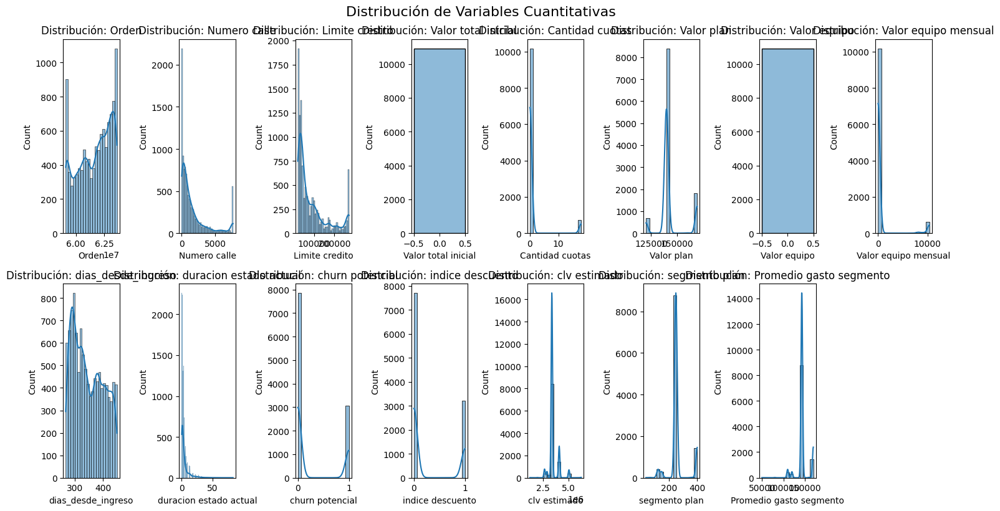

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns



# 1. Variables Cuantitativas 📊
variables_cuantitativas = consolidado.select_dtypes(include=['float64', 'int64'])
plt.figure(figsize=(15, 8))
for i, col in enumerate(variables_cuantitativas.columns):
    plt.subplot(2, (len(variables_cuantitativas.columns) + 1) // 2, i + 1)
    sns.histplot(consolidado[col], kde=True)
    plt.title(f'Distribución: {col}')
plt.tight_layout()
plt.suptitle("Distribución de Variables Cuantitativas", fontsize=16, y=1.02)
plt.show()



<ipython-input-20-03f97197f414>:21: UserWarning:

Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.



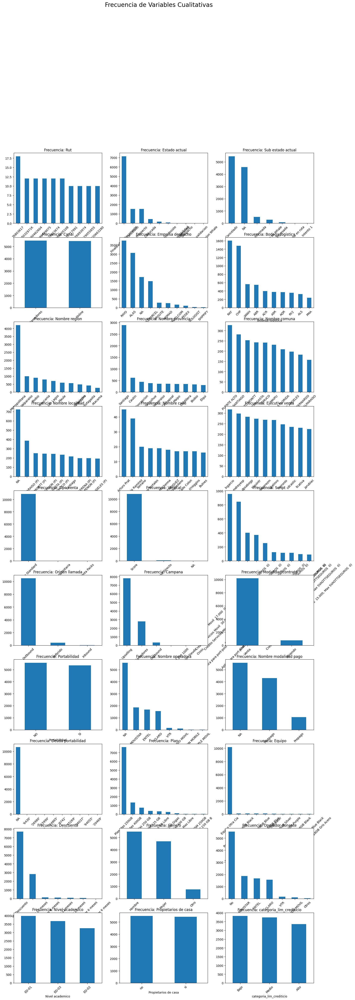

In [ ]:
import math

# Variables cualitativas
variables_cualitativas = consolidado.select_dtypes(include=['object', 'category'])

# Definir número de columnas por fila en la visualización
columnas_por_fila = 3
total_vars = len(variables_cualitativas.columns)
filas = math.ceil(total_vars / columnas_por_fila)

# Crear figura
plt.figure(figsize=(6 * columnas_por_fila, 5 * filas))

# Graficar cada variable cualitativa
for i, col in enumerate(variables_cualitativas.columns):
    plt.subplot(filas, columnas_por_fila, i + 1)
    consolidado[col].value_counts().head(10).plot(kind='bar')  # Top 10 categorías más frecuentes
    plt.title(f'Frecuencia: {col}')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.suptitle("Frecuencia de Variables Cualitativas", fontsize=20, y=1.02)
plt.show()


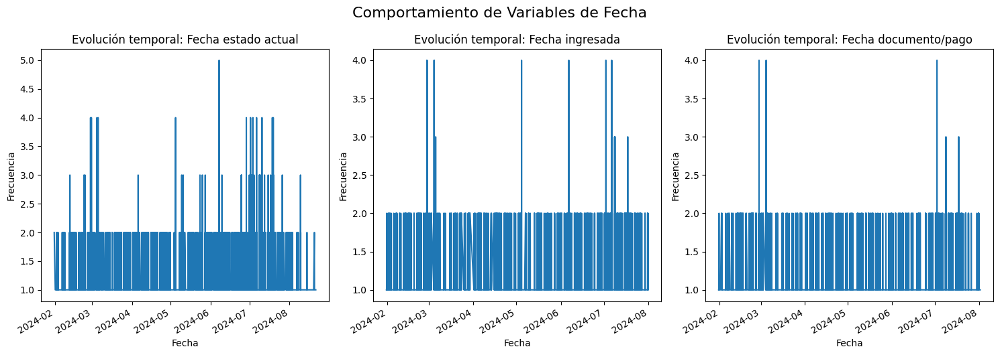

In [ ]:
# 3. Variables de Fecha 📅
variables_fecha = consolidado.select_dtypes(include=['datetime64[ns]'])
plt.figure(figsize=(15, 5))
for i, col in enumerate(variables_fecha.columns):
    plt.subplot(1, len(variables_fecha.columns), i + 1)
    consolidado[col].value_counts().sort_index().plot()
    plt.title(f'Evolución temporal: {col}')
    plt.xlabel('Fecha')
    plt.ylabel('Frecuencia')
plt.tight_layout()
plt.suptitle("Comportamiento de Variables de Fecha", fontsize=16, y=1.05)
plt.show()




===== INFORMACIÓN GENERAL DEL DATAFRAME =====
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10919 entries, 0 to 10918
Data columns (total 48 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Orden                     10919 non-null  float64       
 1   Rut                       10919 non-null  object        
 2   Estado actual             10919 non-null  object        
 3   Fecha estado actual       10919 non-null  datetime64[ns]
 4   Sub estado actual         10919 non-null  object        
 5   Canal                     10919 non-null  object        
 6   Fecha ingresada           10919 non-null  datetime64[ns]
 7   Fecha documento/pago      8913 non-null   datetime64[ns]
 8   Empresa despacho          10919 non-null  object        
 9   Bodega logistica          10919 non-null  object        
 10  Nombre region             10919 non-null  object        
 11  Nombre provincia          10919 

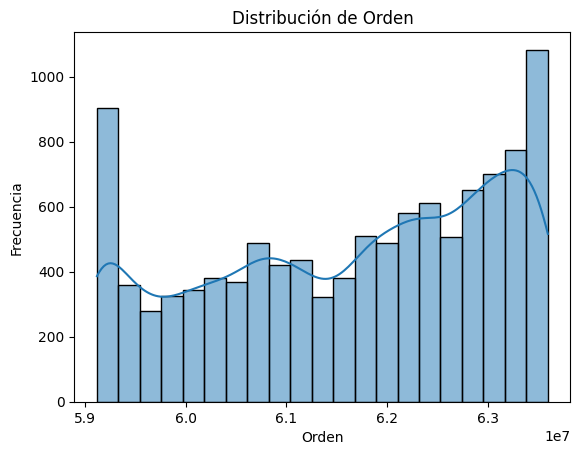

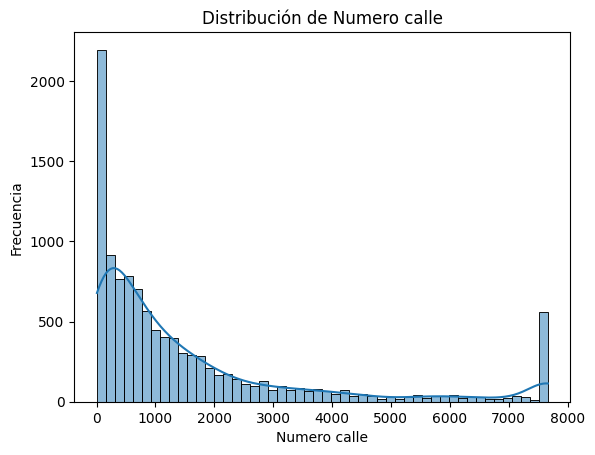

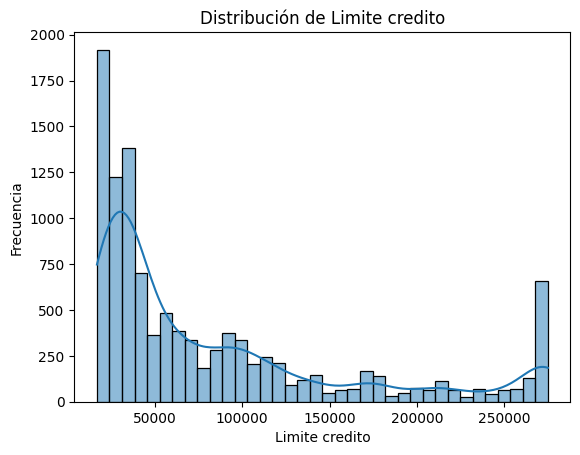

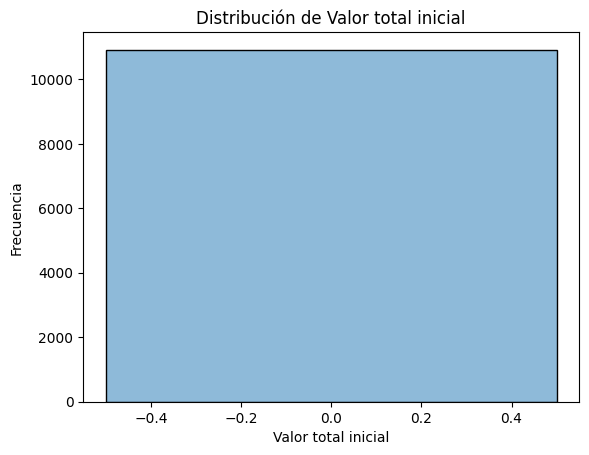

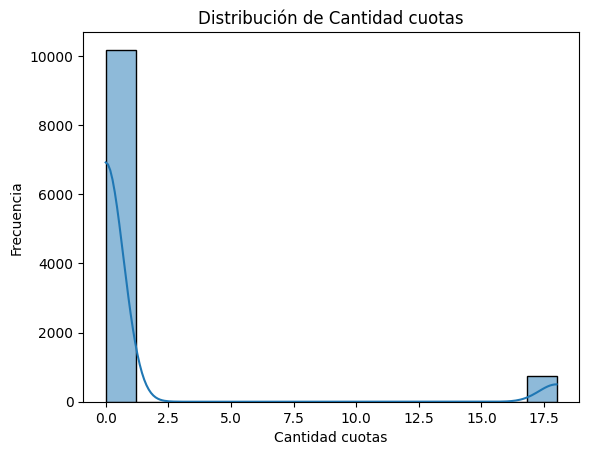

...

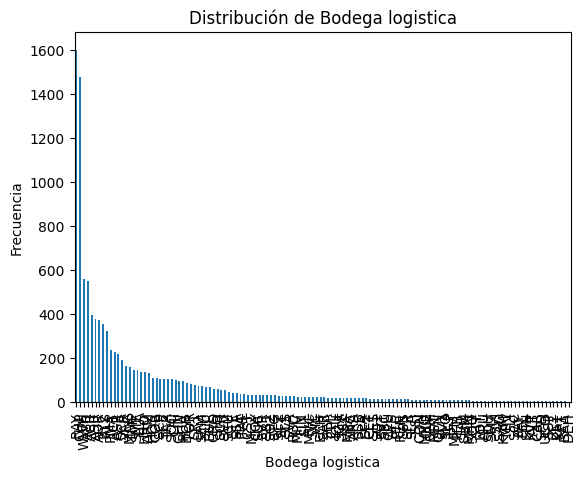

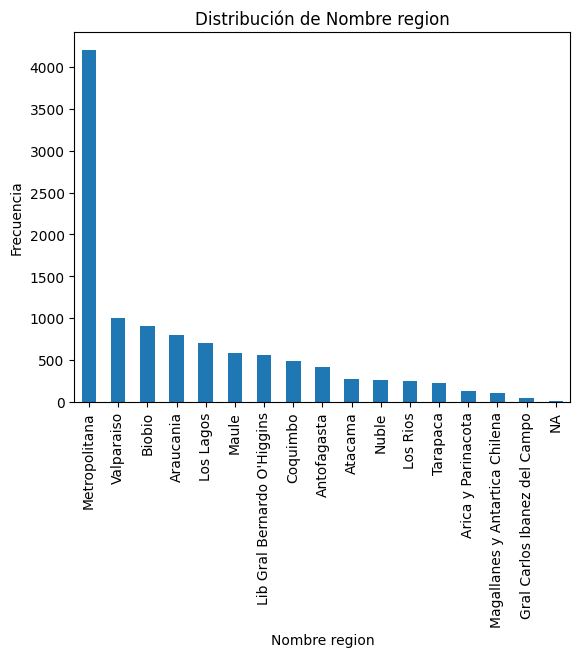

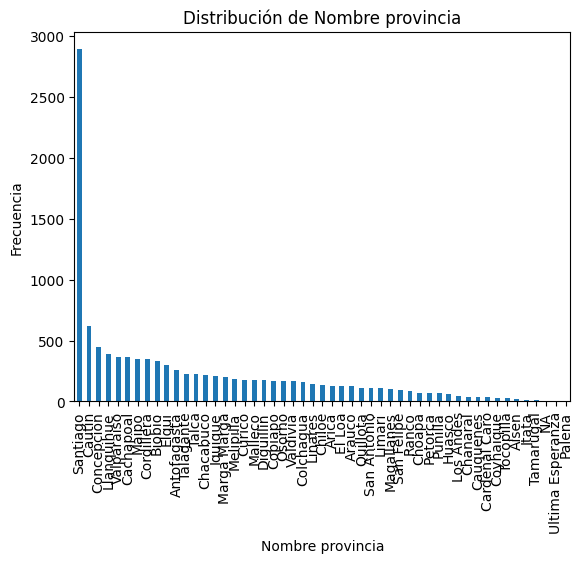

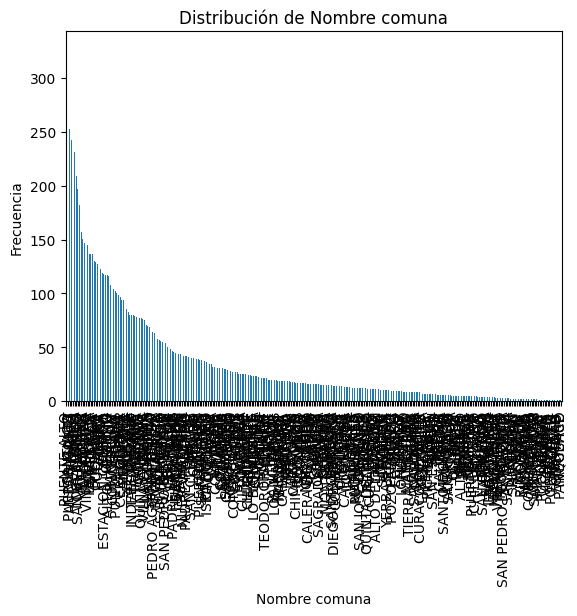

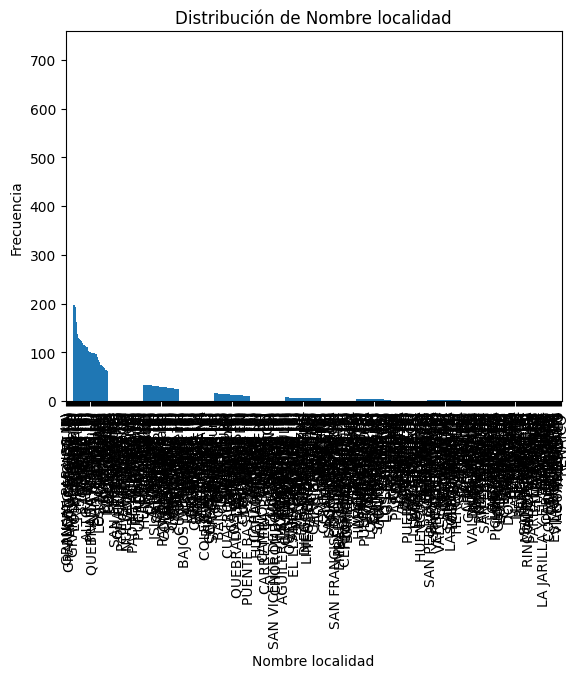

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


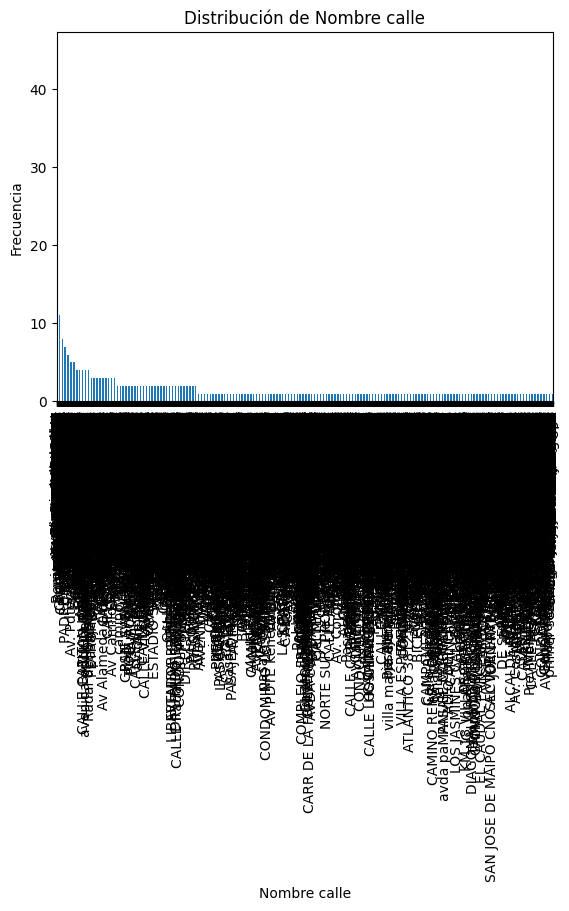

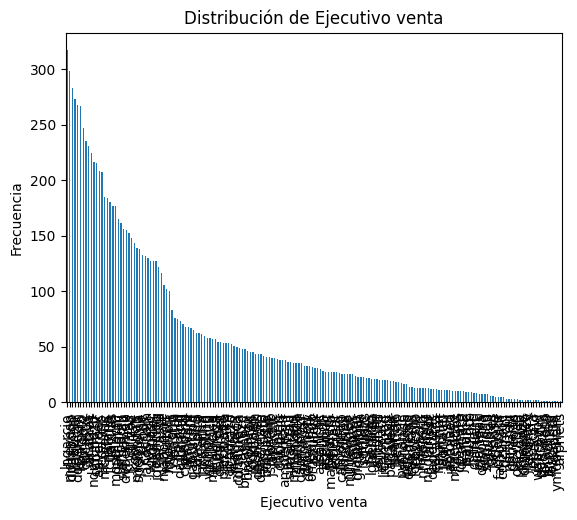

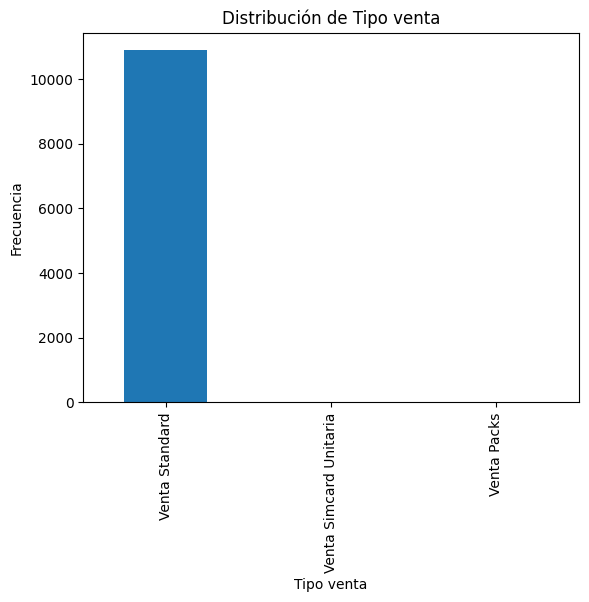

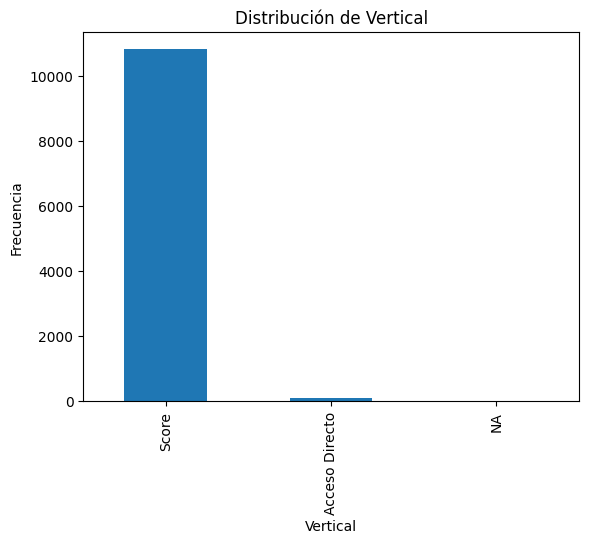

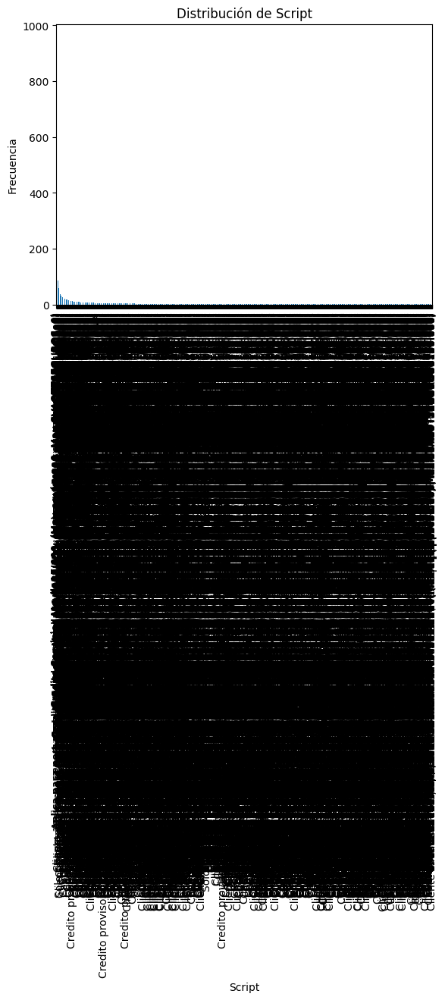

...

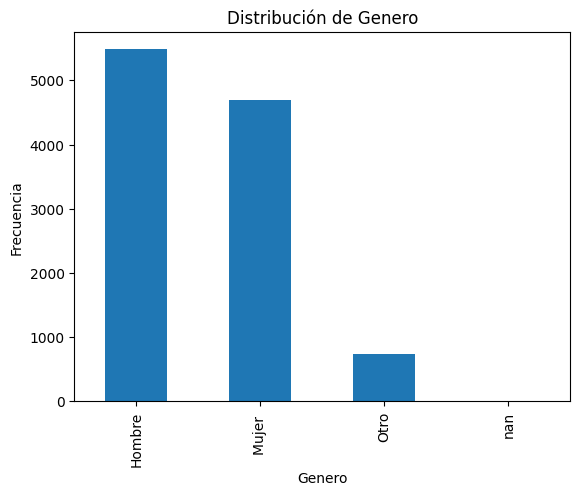

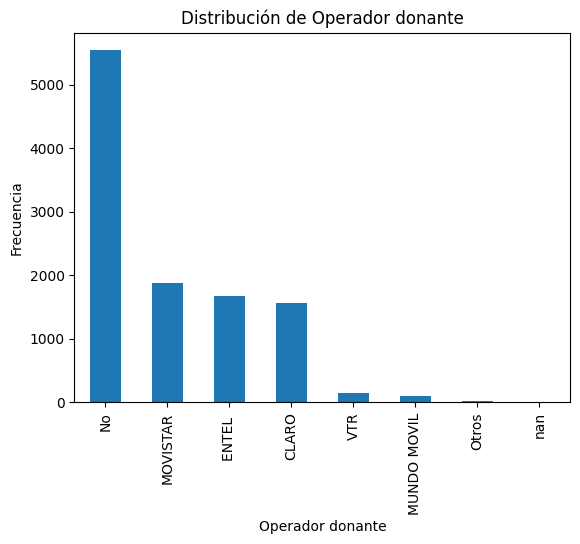

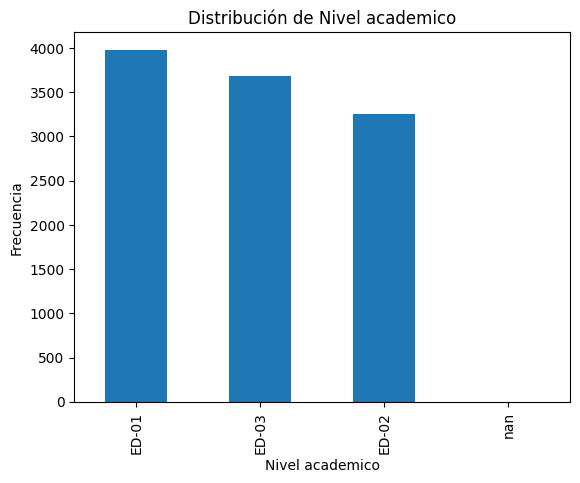

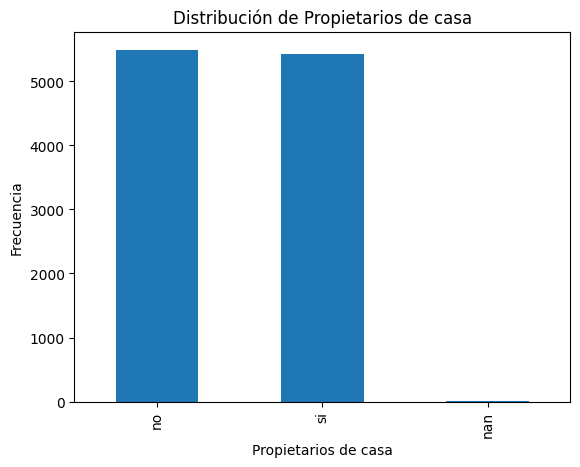

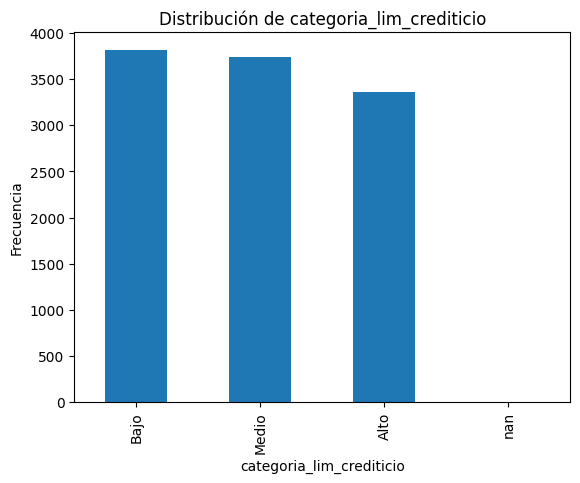



===== ANÁLISIS DESCRIPTIVO COMPLETADO =====


In [ ]:
# --- Comienza el Análisis ---

print("\n\n===== INFORMACIÓN GENERAL DEL DATAFRAME =====")
print(consolidado.info())

print("\n\n===== DESCRIPTIVO VARIABLES NUMÉRICAS =====")
print(consolidado.select_dtypes(include=['int64', 'float64']).describe().transpose())

print("\n\n===== DESCRIPTIVO VARIABLES CATEGÓRICAS =====")
for col in consolidado.select_dtypes(include=['object', 'category']).columns:
    print(f"\n>>> {col}")
    print(consolidado[col].value_counts(dropna=False))

print("\n\n===== DESCRIPTIVO VARIABLES FECHAS =====")
for col in consolidado.select_dtypes(include=['datetime64[ns]']).columns:
    print(f"\n>>> {col}")
    print(f"Mínima: {consolidado[col].min()} | Máxima: {consolidado[col].max()}")

# Opcional: Mostrar gráficos básicos de variables numéricas y categóricas

# Histograma para variables numéricas
numeric_cols = consolidado.select_dtypes(include=['float64', 'int64']).columns
for col in numeric_cols:
    plt.figure()
    sns.histplot(consolidado[col], kde=True)
    plt.title(f"Distribución de {col}")
    plt.xlabel(col)
    plt.ylabel("Frecuencia")
    plt.show()

# Barras para variables categóricas
categorical_cols = consolidado.select_dtypes(include=['object', 'category']).columns
for col in categorical_cols:
    plt.figure()
    consolidado[col].value_counts(dropna=False).plot(kind='bar')
    plt.title(f"Distribución de {col}")
    plt.xlabel(col)
    plt.ylabel("Frecuencia")
    plt.show()

print("\n\n===== ANÁLISIS DESCRIPTIVO COMPLETADO =====")

### 🔍 Hipertuneo V2.0

In [ ]:
# Preparación de datos
# Copia de la base original
consolidado2 = consolidado.copy()

# Variables para aplicar log10
log_vars = [
    'Limite credito', 'dias_desde_ingreso', 'duracion estado actual',
    'Valor plan', 'clv estimado', 'segmento plan', 'Promedio gasto segmento'
]

# Aplicar log10 (con reemplazo de ceros)
for col in log_vars:
    nueva_col = 'log_' + col.lower().replace(' ', '_')
    consolidado2[nueva_col] = np.log10(consolidado2[col].replace(0, np.nan))

# Imputar valores nulos con la mediana
consolidado2.fillna(consolidado2.median(numeric_only=True), inplace=True)



# Codificación One-Hot
categoricas = [
    'churn potencial', 'categoria_lim_crediticio', 'Genero',
    'Propietarios de casa', 'Nivel academico', 'Portabilidad',
    'Descuento', 'indice descuento'
]

ohe = OneHotEncoder(sparse_output=False, drop='first')
encoded = ohe.fit_transform(consolidado2[categoricas])
encoded_df = pd.DataFrame(encoded, columns=ohe.get_feature_names_out(categoricas), index=consolidado2.index)

# Concatenar y eliminar columnas originales
consolidado2 = pd.concat([consolidado2.drop(columns=categoricas), encoded_df], axis=1)

### ---- LABEL ENCODING (EN PARALELO) ----
label_mappings = {}  # Aquí guardamos los diccionarios de mapeo

for col in categoricas:
    le = LabelEncoder()
    consolidado2[col + '_label'] = le.fit_transform(consolidado[col])

    # Guardamos el mapeo inverso
    mapping = dict(zip(le.transform(le.classes_), le.classes_))
    label_mappings[col] = mapping


#Saber a que categoria corresponde cada variable con '_label'
# valor_codificado = 1
# categoria_original = label_mappings['Genero'][valor_codificado]
# print(categoria_original)

In [ ]:
list(consolidado2.columns)

['Orden',
 'Rut',
 'Estado actual',
 'Fecha estado actual',
 'Sub estado actual',
 'Canal',
 'Fecha ingresada',
 'Fecha documento/pago',
 'Empresa despacho',
 'Bodega logistica',
 'Nombre region',
 'Nombre provincia',
 'Nombre comuna',
 'Nombre localidad',
 'Nombre calle',
 'Numero calle',
 'Ejecutivo venta',
 'Tipo venta',
 'Vertical',
 'Limite credito',
 'Script',
 'Origen llamada',
 'Campana',
 'Valor total inicial',
 'Modalidad contrato',
 'Cantidad cuotas',
 'Nombre operadora',
 'Nombre modalidad pago',
 'Deuda portabilidad',
 'Plan',
 'Valor plan',
 'Equipo',
 'Valor equipo',
 'Valor equipo mensual',
 'dias_desde_ingreso',
 'duracion estado actual',
 'clv estimado',
 'segmento plan',
 'Promedio gasto segmento',
 'Operador donante',
 'log_limite_credito',
 'log_dias_desde_ingreso',
 'log_duracion_estado_actual',
 'log_valor_plan',
 'log_clv_estimado',
 'log_segmento_plan',
 'log_promedio_gasto_segmento',
 'churn potencial_1',
 'categoria_lim_crediticio_Bajo',
 'categoria_lim_credi

In [ ]:
consolidado2['churn potencial_label'].value_counts()

,count
churn potencial_label,
0,7854
1,3065


In [ ]:
# Escalamiento de variables
# 1. Crear una copia para no tocar el DataFrame original
df = consolidado2.copy()

# 2. Opcional pero recomendado: eliminar variables que ya no se usan si aún están (como 'Orden')
if 'Orden' in consolidado2.columns:
    consolidado2 = consolidado2.drop(columns=['Orden'])

# 3. Definir variables numéricas a escalar (excluyendo 'Rut')
llaves = ['Rut']
variables_numericas = consolidado2.select_dtypes(include=['int64', 'float64']).columns.difference(llaves)

# 4. Escalar con RobustScaler
scaler = RobustScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(consolidado2[variables_numericas]), columns=variables_numericas, index=df.index)

# 5. Reconstruir el DataFrame escalado con 'Rut'
consolidado2_escalado = pd.concat([
    df[llaves],
    scaled_df
], axis=1)

# 6. Guardar copia final para clustering o modelos
consolidado_hiper2 = consolidado2_escalado.copy()

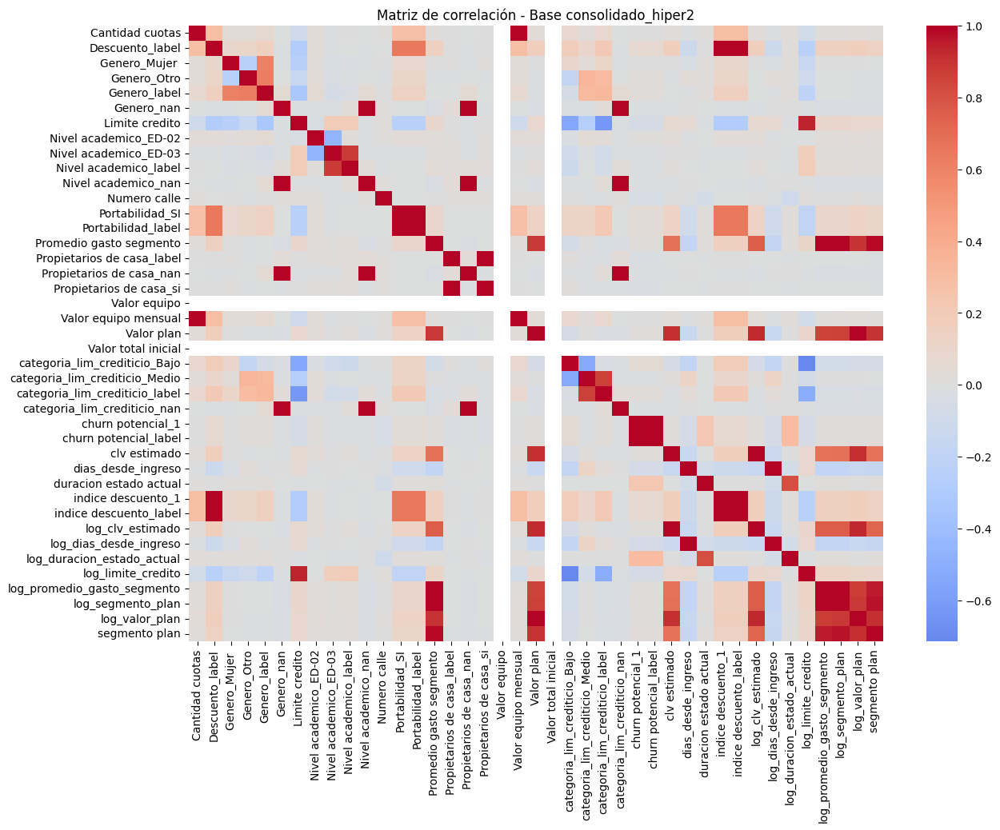

In [ ]:
# Análisis exploratorio
plt.figure(figsize=(14, 10))
sns.heatmap(consolidado_hiper2.drop(columns=llaves).corr(), cmap='coolwarm', center=0)
plt.title('Matriz de correlación - Base consolidado_hiper2')
plt.show()


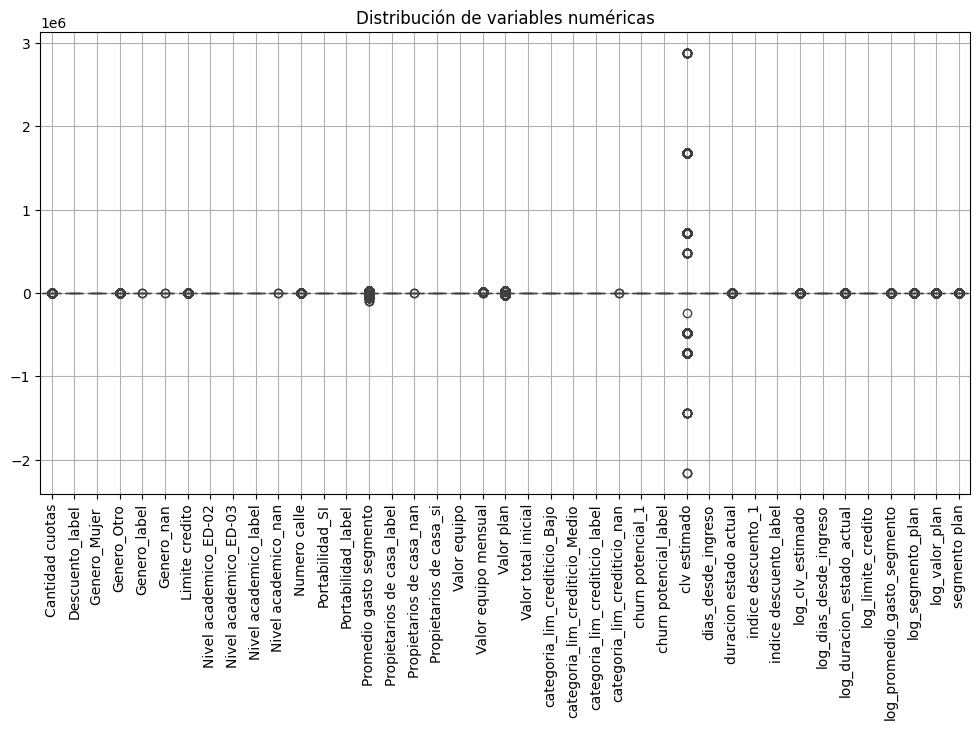

In [ ]:
# Antes del PCA, revisa distribución y escala
datos_numericos = consolidado_hiper2.select_dtypes(include='number')

plt.figure(figsize=(12, 6))
sns.boxplot(data=datos_numericos)
plt.xticks(rotation=90)
plt.title("Distribución de variables numéricas")
plt.grid(True)
plt.show()


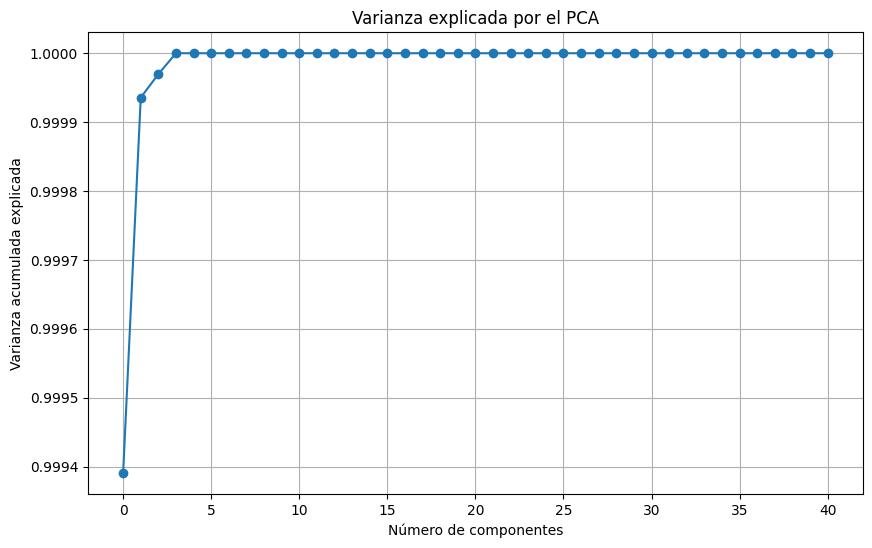

In [ ]:
X = consolidado_hiper2.drop(columns=['Rut'])
pca = PCA()
pca.fit(X)

plt.figure(figsize=(10,6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel('Número de componentes')
plt.ylabel('Varianza acumulada explicada')
plt.title('Varianza explicada por el PCA')
plt.grid(True)
plt.show()


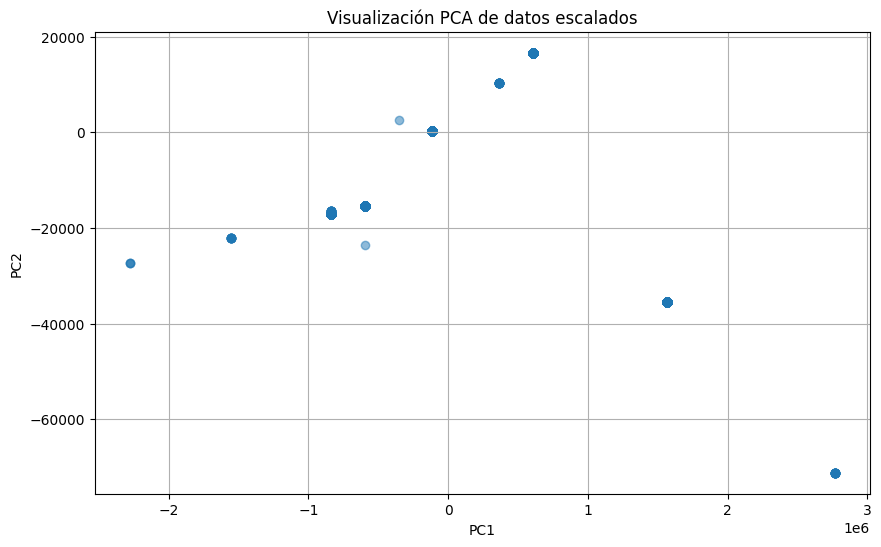

In [ ]:
# Visualización con PCA
pca = PCA(n_components=2)
pca_resultado = pca.fit_transform(consolidado_hiper2.drop(columns=llaves))

plt.figure(figsize=(10, 6))
plt.scatter(pca_resultado[:, 0], pca_resultado[:, 1], alpha=0.5)
plt.title('Visualización PCA de datos escalados')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.grid(True)
plt.show()


In [ ]:
consolidado2[variables_numericas].describe()

,Cantidad cuotas,Descuento_label,Genero_Mujer,Genero_Otro,Genero_label,Genero_nan,Limite credito,Nivel academico_ED-02,Nivel academico_ED-03,Nivel academico_label,...,indice descuento_1,indice descuento_label,log_clv_estimado,log_dias_desde_ingreso,log_duracion_estado_actual,log_limite_credito,log_promedio_gasto_segmento,log_segmento_plan,log_valor_plan,segmento plan
count,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,...,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000,10919.000000
mean,1.218243,0.294624,0.429343,0.068413,0.566719,0.000183,83893.192600,0.298196,0.337119,0.972983,...,0.294624,0.294624,6.537543,2.532816,0.513924,4.761556,5.158931,2.407687,5.155669,262.572580
std,4.521741,0.455894,0.495005,0.252465,0.619281,0.013533,76404.392228,0.457487,0.472747,0.837668,...,0.455894,0.455894,0.050564,0.066274,0.383761,0.371631,0.038284,0.102137,0.037042,60.701867
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17000.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,6.078312,2.423246,0.000000,4.230449,4.698101,1.602060,5.078819,40.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,30000.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,6.526029,2.474216,0.301030,4.477121,5.155501,2.397940,5.145818,250.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,48000.000000,0.000000,0.000000,1.000000,...,0.000000,0.000000,6.526029,2.526339,0.477121,4.681241,5.155501,2.397940,5.145818,250.000000
75%,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,111020.000000,1.000000,1.000000,2.000000,...,1.000000,1.000000,6.526029,2.591065,0.698970,5.045401,5.155501,2.397940,5.145818,250.000000
max,18.000000,1.000000,1.000000,1.000000,3.000000,1.000000,274880.000000,1.000000,1.000000,3.000000,...,1.000000,1.000000,6.795018,2.650308,1.919078,5.439143,5.230193,2.602060,5.230193,400.000000


In [ ]:
print("Variables usadas para clustering:")
list(consolidado_hiper2.drop(columns=['Rut']).columns.tolist())

Variables usadas para clustering:


['Cantidad cuotas',
 'Descuento_label',
 'Genero_Mujer ',
 'Genero_Otro',
 'Genero_label',
 'Genero_nan',
 'Limite credito',
 'Nivel academico_ED-02',
 'Nivel academico_ED-03',
 'Nivel academico_label',
 'Nivel academico_nan',
 'Numero calle',
 'Portabilidad_SI',
 'Portabilidad_label',
 'Promedio gasto segmento',
 'Propietarios de casa_label',
 'Propietarios de casa_nan',
 'Propietarios de casa_si',
 'Valor equipo',
 'Valor equipo mensual',
 'Valor plan',
 'Valor total inicial',
 'categoria_lim_crediticio_Bajo',
 'categoria_lim_crediticio_Medio',
 'categoria_lim_crediticio_label',
 'categoria_lim_crediticio_nan',
 'churn potencial_1',
 'churn potencial_label',
 'clv estimado',
 'dias_desde_ingreso',
 'duracion estado actual',
 'indice descuento_1',
 'indice descuento_label',
 'log_clv_estimado',
 'log_dias_desde_ingreso',
 'log_duracion_estado_actual',
 'log_limite_credito',
 'log_promedio_gasto_segmento',
 'log_segmento_plan',
 'log_valor_plan',
 'segmento plan']

In [ ]:
# Variables que no se van a incluir por concentración en un solo bucket

#consolidado2['log_valor_plan'].value_counts()
# 'Cantidad cuotas'
# 'Genero_nan'
# 'Nivel academico_nan'
# 'Numero calle'
# 'Propietarios de casa_nan'
# 'Valor equipo'
# 'Valor total inicial'
# 'categoria_lim_crediticio_nan'

In [ ]:
# Copiar la base original para no afectar la original
df_filtrado = consolidado_hiper2.copy()

# Lista original de variables usadas
variables_usadas = [
  'Cantidad cuotas',
 'Descuento_label',
 'Genero_Mujer ',
 'Genero_Otro',
 'Genero_label',
 'Genero_nan',
 'Limite credito',
 'Nivel academico_ED-02',
 'Nivel academico_ED-03',
 'Nivel academico_label',
 'Nivel academico_nan',
 'Numero calle',
 'Portabilidad_SI',
 'Portabilidad_label',
 'Promedio gasto segmento',
 'Propietarios de casa_label',
 'Propietarios de casa_nan',
 'Propietarios de casa_si',
 'Valor equipo',
 'Valor equipo mensual',
 'Valor plan',
 'Valor total inicial',
 'categoria_lim_crediticio_Bajo',
 'categoria_lim_crediticio_Medio',
 'categoria_lim_crediticio_label',
 'categoria_lim_crediticio_nan',
 'churn potencial_1',
 'churn potencial_label',
 'clv estimado',
 'dias_desde_ingreso',
 'duracion estado actual',
 'indice descuento_1',
 'indice descuento_label',
 'log_clv_estimado',
 'log_dias_desde_ingreso',
 'log_duracion_estado_actual',
 'log_limite_credito',
 'log_promedio_gasto_segmento',
 'log_segmento_plan',
 'log_valor_plan',
 'segmento plan']

# Variables que deseas eliminar explícitamente
variables_a_eliminar = [
    'Cantidad cuotas', 'Genero_nan', 'Nivel academico_nan', 'Numero calle',
    'Propietarios de casa_nan', 'Valor equipo', 'Valor total inicial',
    'categoria_lim_crediticio_nan'
]

# Variables originales que tienen versión logarítmica, por lo tanto se eliminan
variables_con_log = {
    'Limite credito': 'log_limite_credito',
    'clv estimado': 'log_clv_estimado',
    'dias_desde_ingreso': 'log_dias_desde_ingreso',
    'duracion estado actual': 'log_duracion_estado_actual',
    'Promedio gasto segmento': 'log_promedio_gasto_segmento',
    'segmento plan': 'log_segmento_plan',
    'Valor plan': 'log_valor_plan'
}

# Construir conjunto final:
# - Partimos de todas las variables usadas
# - Quitamos las no deseadas
# - Quitamos las originales que tienen log
variables_finales = [
    v for v in variables_usadas
    if v not in variables_a_eliminar and v not in variables_con_log
]

# Aseguramos que se incluyan las transformadas log
variables_finales += list(variables_con_log.values())

# Filtramos el DataFrame
df_filtrado = df_filtrado[variables_finales]

# Guardamos o reemplazamos en consolidado_hiper2
consolidado_hiper2 = df_filtrado.copy()

# Confirmamos las variables finales
print(f"Variables finales para clustering: {list(consolidado_hiper2.columns)}")

Variables finales para clustering: ['Descuento_label', 'Genero_Mujer ', 'Genero_Otro', 'Genero_label', 'Nivel academico_ED-02', 'Nivel academico_ED-03', 'Nivel academico_label', 'Portabilidad_SI', 'Portabilidad_label', 'Propietarios de casa_label', 'Propietarios de casa_si', 'Valor equipo mensual', 'categoria_lim_crediticio_Bajo', 'categoria_lim_crediticio_Medio', 'categoria_lim_crediticio_label', 'churn potencial_1', 'churn potencial_label', 'indice descuento_1', 'indice descuento_label', 'log_clv_estimado', 'log_dias_desde_ingreso', 'log_duracion_estado_actual', 'log_limite_credito', 'log_promedio_gasto_segmento', 'log_segmento_plan', 'log_valor_plan', 'log_limite_credito', 'log_clv_estimado', 'log_dias_desde_ingreso', 'log_duracion_estado_actual', 'log_promedio_gasto_segmento', 'log_segmento_plan', 'log_valor_plan']


In [ ]:
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, davies_bouldin_score
import pandas as pd

# Tus subsets
subsets = {
    'Subset 1 - Básico': [
        'Genero_Mujer ', 'Nivel academico_ED-02', 'Portabilidad_SI',
        'indice descuento_1','log_clv_estimado'
    ],
    'Subset 2 - Alternativo': [
        'Genero_Mujer ', 'Genero_Otro', 'log_promedio_gasto_segmento',
        'log_segmento_plan', 'categoria_lim_crediticio_Bajo', 'log_duracion_estado_actual','log_clv_estimado'
    ],
    'Subset 3 - con logs y sin variables redundantes': [
        'Genero_Mujer ', 'Portabilidad_SI',
        'log_promedio_gasto_segmento', 'log_clv_estimado', 'log_segmento_plan',
        'Propietarios de casa_si', 'indice descuento_1', 'log_dias_desde_ingreso','log_limite_credito'
    ],
    'Subset 4 - Enfocado en ingresos y permanencia': [
        'log_dias_desde_ingreso', 'log_clv_estimado', 'log_duracion_estado_actual',
        'indice descuento_1', 'log_segmento_plan','log_clv_estimado'
    ],
    'Subset 5 - Copia sub2 variables encoder': [
        'Genero_label',  'log_promedio_gasto_segmento',
        'log_segmento_plan', 'categoria_lim_crediticio_label', 'log_duracion_estado_actual','log_clv_estimado'
    ]
}

# Evaluación por modelo y número de clusters
for nombre, columnas in subsets.items():
    print(f"\n🔍 Evaluando subset: {nombre}")
    df_subset = consolidado_hiper2[columnas].copy()
    df_scaled = StandardScaler().fit_transform(df_subset)
    total_obs = df_subset.shape[0]

    print("📌 KMeans:")
    for k in range(2, 5):
        kmeans = KMeans(n_clusters=k, random_state=42)
        labels_kmeans = kmeans.fit_predict(df_scaled)

        sil_k = silhouette_score(df_scaled, labels_kmeans)
        db_k = davies_bouldin_score(df_scaled, labels_kmeans)

        print(f"  k = {k} | Silhouette = {sil_k:.3f} | Davies-Bouldin = {db_k:.3f}")

        # Distribución por cluster
        dist_kmeans = pd.Series(labels_kmeans).value_counts().sort_index()
        for cluster_id, count in dist_kmeans.items():
            perc = count / total_obs * 100
            print(f"    Cluster {cluster_id} → {count} clientes ({perc:.2f}%)")

    print("📌 Clustering Jerárquico:")
    for k in range(2, 5):
        agglo = AgglomerativeClustering(n_clusters=k)
        labels_agglo = agglo.fit_predict(df_scaled)

        sil_a = silhouette_score(df_scaled, labels_agglo)
        db_a = davies_bouldin_score(df_scaled, labels_agglo)

        print(f"  k = {k} | Silhouette = {sil_a:.3f} | Davies-Bouldin = {db_a:.3f}")

        # Distribución por cluster
        dist_agglo = pd.Series(labels_agglo).value_counts().sort_index()
        for cluster_id, count in dist_agglo.items():
            perc = count / total_obs * 100
            print(f"    Cluster {cluster_id} → {count} clientes ({perc:.2f}%)")


🔍 Evaluando subset: Subset 1 - Básico
📌 KMeans:
  k = 2 | Silhouette = 0.309 | Davies-Bouldin = 1.595
    Cluster 0 → 6586 clientes (60.32%)
    Cluster 1 → 4333 clientes (39.68%)
  k = 3 | Silhouette = 0.322 | Davies-Bouldin = 1.417
    Cluster 0 → 5194 clientes (47.57%)
    Cluster 1 → 3512 clientes (32.16%)
    Cluster 2 → 2213 clientes (20.27%)
  k = 4 | Silhouette = 0.335 | Davies-Bouldin = 1.393
    Cluster 0 → 3980 clientes (36.45%)
    Cluster 1 → 3249 clientes (29.76%)
    Cluster 2 → 2209 clientes (20.23%)
    Cluster 3 → 1481 clientes (13.56%)
📌 Clustering Jerárquico:
  k = 2 | Silhouette = 0.308 | Davies-Bouldin = 1.649
    Cluster 0 → 4223 clientes (38.68%)
    Cluster 1 → 6696 clientes (61.32%)
  k = 3 | Silhouette = 0.339 | Davies-Bouldin = 1.205
    Cluster 0 → 6696 clientes (61.32%)
    Cluster 1 → 1828 clientes (16.74%)
    Cluster 2 → 2395 clientes (21.93%)
  k = 4 | Silhouette = 0.348 | Davies-Bouldin = 1.233
    Cluster 0 → 4948 clientes (45.32%)
    Cluster 1 → 1

In [ ]:
k_kmeans2 = 4
k_jerarquico2 = 3

# Subset que usaste para clustering
columnas_subset = [
    'Genero_label', 'log_promedio_gasto_segmento',
    'log_segmento_plan', 'categoria_lim_crediticio_label',
    'log_duracion_estado_actual', 'log_clv_estimado'
]

# Escalar para clustering
scaler2 = StandardScaler()
df_scaled_kmeans = scaler2.fit_transform(consolidado_hiper2[columnas_subset])
kmeans2 = KMeans(n_clusters=k_kmeans2, random_state=42)
consolidado_hiper2['cluster_kmeans2'] = kmeans2.fit_predict(df_scaled_kmeans)

agglo2 = AgglomerativeClustering(n_clusters=k_jerarquico2)
consolidado_hiper2['cluster_jerarquico2'] = agglo2.fit_predict(df_scaled_kmeans)

In [ ]:
# ======================================
# Consolidación base hipertuneo 2
# ======================================

k_kmeans2 = 4
k_jerarquico2 = 3

# Subset que usaste para clustering
columnas_subset = [
    'Genero_label', 'log_promedio_gasto_segmento',
    'log_segmento_plan', 'categoria_lim_crediticio_label',
    'log_duracion_estado_actual', 'log_clv_estimado'
]

# Escalar para clustering
scaler2 = StandardScaler()
df_scaled_kmeans = scaler2.fit_transform(consolidado_hiper2[columnas_subset])
kmeans2 = KMeans(n_clusters=k_kmeans2, random_state=42)
consolidado_hiper2['cluster_kmeans2'] = kmeans2.fit_predict(df_scaled_kmeans)

agglo2 = AgglomerativeClustering(n_clusters=k_jerarquico2)
consolidado_hiper2['cluster_jerarquico2'] = agglo2.fit_predict(df_scaled_kmeans)

# ======================================
# Reversión de variables para análisis
# ======================================

# Desescalado (si se escaló alguna variable antes del clustering)
# Asegúrate de tener escalador y variables originales
try:
    desescaladas = pd.DataFrame(scaler.inverse_transform(scaled_df), columns=variables_numericas, index=consolidado2.index)
except:
    desescaladas = pd.DataFrame()  # Evita error si no aplica

# Reversión de log10
for col in log_vars:
    col_log = 'log_' + col.lower().replace(' ', '_')
    if col_log in consolidado2.columns:
        consolidado2[col] = 10 ** consolidado2[col_log]

# Reversión de OneHotEncoding (solo para interpretación, puedes quitar si no es necesaria)
encoded_df = pd.DataFrame(encoded, columns=ohe.get_feature_names_out(categoricas), index=consolidado2.index)
decoded_categoricas = pd.DataFrame(ohe.inverse_transform(encoded_df), columns=categoricas, index=consolidado2.index)

# Variables '_label' (codificadas para análisis)
variables_label = consolidado2.filter(like='_label')

# ======================================
# Construcción de base final
# ======================================
consolidado2_final = pd.concat([
    consolidado2[llaves].reset_index(drop=True),         # Llaves identificadoras
    consolidado2[log_vars].reset_index(drop=True),       # Variables revertidas del log
    decoded_categoricas.reset_index(drop=True),          # Categóricas originales (interpretación)
    encoded_df.reset_index(drop=True),                   # Variables codificadas One-Hot (¡las que faltaban!)
    variables_label.reset_index(drop=True),              # Variables codificadas con LabelEncoder
    consolidado_hiper2[['cluster_kmeans2', 'cluster_jerarquico2']].reset_index(drop=True)
], axis=1)

# Limpieza de nombres
consolidado2_final.columns = consolidado2_final.columns.str.strip()

# Opcional: mostrar columnas finales
print("Columnas finales de la base consolidada:")
print(consolidado2_final.columns.tolist())

Columnas finales de la base consolidada:
['Rut', 'Limite credito', 'dias_desde_ingreso', 'duracion estado actual', 'Valor plan', 'clv estimado', 'segmento plan', 'Promedio gasto segmento', 'churn potencial', 'categoria_lim_crediticio', 'Genero', 'Propietarios de casa', 'Nivel academico', 'Portabilidad', 'Descuento', 'indice descuento', 'churn potencial_1', 'categoria_lim_crediticio_Bajo', 'categoria_lim_crediticio_Medio', 'categoria_lim_crediticio_nan', 'Genero_Mujer', 'Genero_Otro', 'Genero_nan', 'Propietarios de casa_si', 'Propietarios de casa_nan', 'Nivel academico_ED-02', 'Nivel academico_ED-03', 'Nivel academico_nan', 'Portabilidad_SI', 'indice descuento_1', 'churn potencial_label', 'categoria_lim_crediticio_label', 'Genero_label', 'Propietarios de casa_label', 'Nivel academico_label', 'Portabilidad_label', 'Descuento_label', 'indice descuento_label', 'cluster_kmeans2', 'cluster_jerarquico2']


In [ ]:
consolidado2_final

,Rut,Limite credito,dias_desde_ingreso,duracion estado actual,Valor plan,clv estimado,segmento plan,Promedio gasto segmento,churn potencial,categoria_lim_crediticio,...,churn potencial_label,categoria_lim_crediticio_label,Genero_label,Propietarios de casa_label,Nivel academico_label,Portabilidad_label,Descuento_label,indice descuento_label,cluster_kmeans2,cluster_jerarquico2
0,77024425,104510.0,447.0,1.0,139900.0,3357600.0,250.0,143054.45637,0,Alto,...,0,0,1,1,2,0,0,0,0,0
1,98013830,17000.0,447.0,21.0,139900.0,3357600.0,250.0,143054.45637,1,Bajo,...,1,1,1,1,1,0,0,0,1,0
2,81989362,274880.0,447.0,2.0,139900.0,3357600.0,250.0,143054.45637,0,Alto,...,0,0,0,1,2,0,0,0,0,0
3,100607522,89010.0,447.0,2.0,169900.0,4077600.0,400.0,169900.00000,1,Medio,...,1,2,0,0,0,0,0,0,3,1
4,59707981,41000.0,447.0,2.0,139900.0,3357600.0,250.0,143054.45637,0,Medio,...,0,2,1,1,0,1,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10914,179172461,17000.0,266.0,3.0,169900.0,4077600.0,400.0,169900.00000,0,Bajo,...,0,1,0,1,1,0,0,0,3,1
10915,134314710,48000.0,265.0,2.0,139900.0,3357600.0,250.0,143054.45637,0,Medio,...,0,2,2,1,1,1,1,1,0,0
10916,143627330,35010.0,266.0,1.0,139900.0,3357600.0,250.0,143054.45637,0,Medio,...,0,2,2,1,1,0,0,0,0,0
10917,184572362,34560.0,265.0,3.0,139900.0,3357600.0,250.0,143054.45637,0,Bajo,...,0,1,1,0,1,1,1,1,0,0


In [ ]:
consolidado2_final['cluster_jerarquico2'].value_counts()

,count
cluster_jerarquico2,
0,8402
1,1828
2,689


In [ ]:
consolidado2_final['Genero_label'].value_counts()

,count
Genero_label,
0,5482
1,4688
2,747
3,2


In [ ]:
# prompt: colocar las etiquetas del cluster cluster_kmeans2	cluster_jerarquico2 en consolidado

# Agregar las etiquetas de cluster al DataFrame 'consolidado'
consolidado['cluster_kmeans2'] = consolidado2_final['cluster_kmeans2']
consolidado['cluster_jerarquico2'] = consolidado2_final['cluster_jerarquico2']


In [ ]:
consolidado.head(2)

,Orden,Rut,Estado actual,Fecha estado actual,Sub estado actual,Canal,Fecha ingresada,Fecha documento/pago,Empresa despacho,Bodega logistica,...,clv estimado,segmento plan,Promedio gasto segmento,Genero,Operador donante,Nivel academico,Propietarios de casa,categoria_lim_crediticio,cluster_kmeans2,cluster_jerarquico2
0,59115315.25,77024425,Finalizada exitosamente,2024-02-01 16:38:57,NA,Llamadores,2024-01-31 13:12:44,2024-01-31 14:35:50,RAYO,TLA,...,3357600,250,143054.45637,Mujer,No,ED-03,si,Alto,0,0
1,59115315.25,98013830,Cancelado,2024-02-21 22:57:23,Cancelado,Llamadores,2024-01-31 17:02:42,2024-01-31 17:45:11,NA,CHN,...,3357600,250,143054.45637,Mujer,No,ED-02,si,Bajo,1,0


In [ ]:
#Nico
#os.chdir('/content/Drive/MyDrive/Bases/Base proyecto')
#consolidado.to_excel('consolidado_final.xlsx', index=False)
# Cami
os.chdir('/content/Drive/MyDrive/Maestria/3er Semestre/Trabajo de grado I/Bases/Base proyecto')
base_incial.to_excel('base_incial.xlsx', index=False)

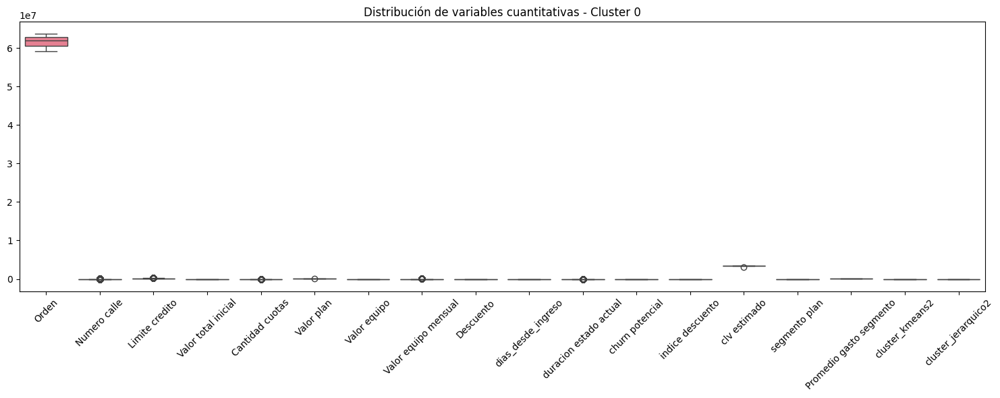

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Filtrar datos para cluster_jerarquico2 == 0
cluster_0 = consolidado[consolidado['cluster_jerarquico2'] == 0]

# Seleccionar solo variables cuantitativas (numéricas)
numericas = cluster_0.select_dtypes(include='number')

# Crear gráfico boxplot
plt.figure(figsize=(15, 6))
sns.boxplot(data=numericas)
plt.xticks(rotation=45)
plt.title('Distribución de variables cuantitativas - Cluster 0')
plt.tight_layout()
plt.show()


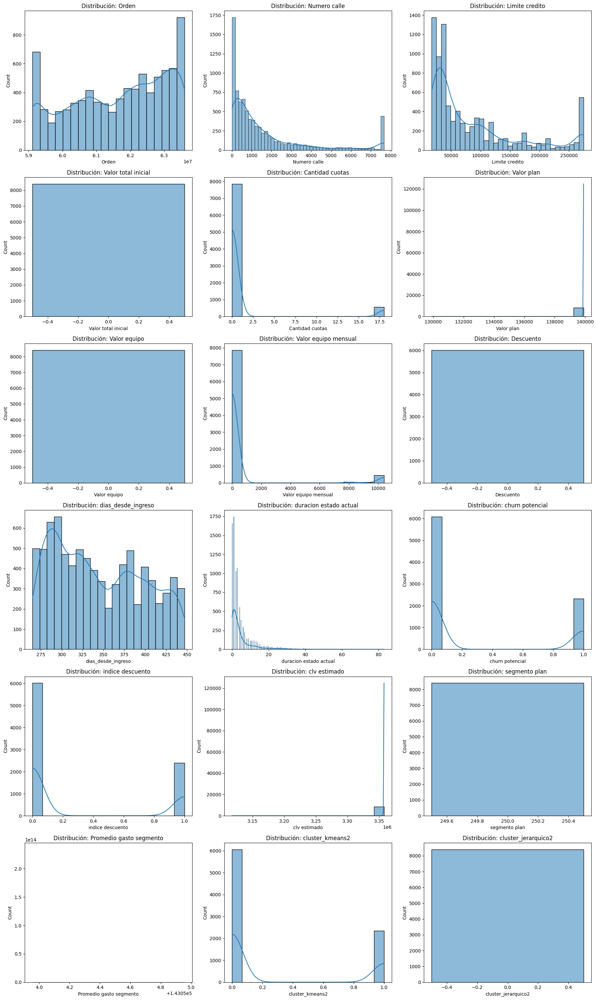

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Paso 1: Filtrar los datos solo para el Cluster 0
cluster_0 = consolidado[consolidado['cluster_jerarquico2'] == 0]

# Paso 2: Seleccionar solo columnas numéricas
numericas = cluster_0.select_dtypes(include='number')

# Paso 3: Calcular cantidad de filas necesarias para el subplot
columnas = numericas.columns
n = len(columnas)
filas = math.ceil(n / 3)

# Paso 4: Crear los subplots
fig, axes = plt.subplots(filas, 3, figsize=(18, 5 * filas))
axes = axes.flatten()

# Paso 5: Graficar cada variable numérica (solo del cluster 0)
for i, col in enumerate(columnas):
    sns.histplot(cluster_0[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribución: {col}')

# Paso 6: Eliminar ejes vacíos si sobran
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


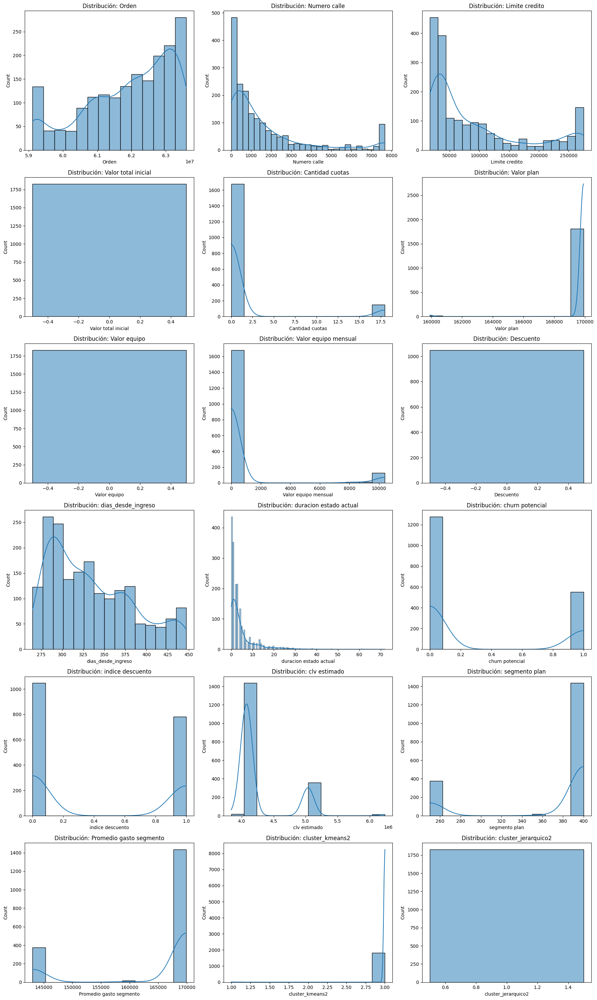

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Paso 1: Filtrar los datos solo para el Cluster 0
cluster_0 = consolidado[consolidado['cluster_jerarquico2'] == 1]

# Paso 2: Seleccionar solo columnas numéricas
numericas = cluster_0.select_dtypes(include='number')

# Paso 3: Calcular cantidad de filas necesarias para el subplot
columnas = numericas.columns
n = len(columnas)
filas = math.ceil(n / 3)

# Paso 4: Crear los subplots
fig, axes = plt.subplots(filas, 3, figsize=(18, 5 * filas))
axes = axes.flatten()

# Paso 5: Graficar cada variable numérica (solo del cluster 0)
for i, col in enumerate(columnas):
    sns.histplot(cluster_0[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribución: {col}')

# Paso 6: Eliminar ejes vacíos si sobran
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


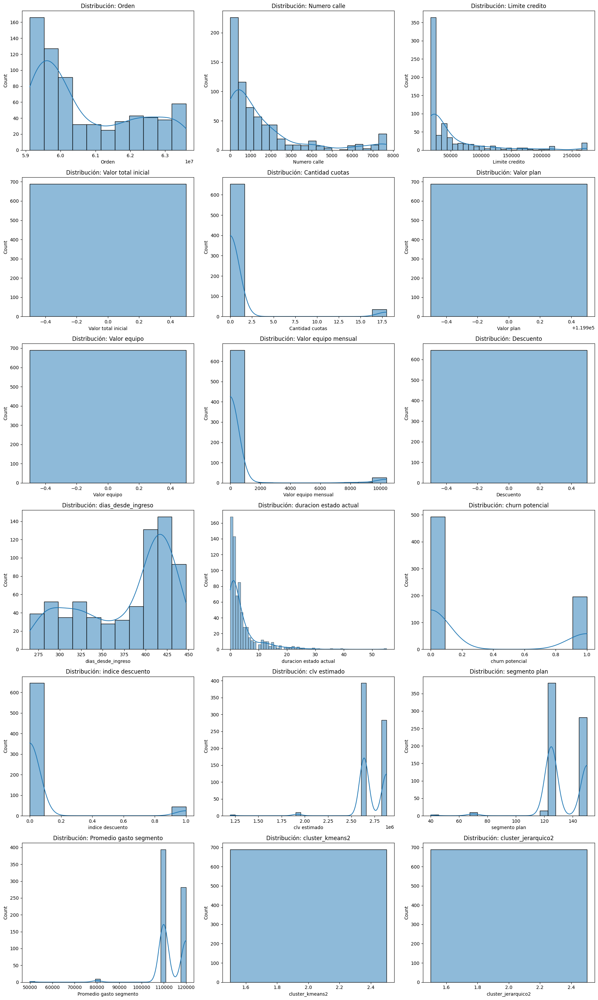

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Paso 1: Filtrar los datos solo para el Cluster 0
cluster_0 = consolidado[consolidado['cluster_jerarquico2'] == 2]

# Paso 2: Seleccionar solo columnas numéricas
numericas = cluster_0.select_dtypes(include='number')

# Paso 3: Calcular cantidad de filas necesarias para el subplot
columnas = numericas.columns
n = len(columnas)
filas = math.ceil(n / 3)

# Paso 4: Crear los subplots
fig, axes = plt.subplots(filas, 3, figsize=(18, 5 * filas))
axes = axes.flatten()

# Paso 5: Graficar cada variable numérica (solo del cluster 0)
for i, col in enumerate(columnas):
    sns.histplot(cluster_0[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribución: {col}')

# Paso 6: Eliminar ejes vacíos si sobran
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()



--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 0) ---

                          count          mean           std           min  \
Orden                    6058.0  6.161594e+07  1.423995e+06  5.911532e+07   
Numero calle             6058.0  1.716471e+03  2.088181e+03  7.000000e+00   
Limite credito           6058.0  8.517238e+04  7.653718e+04  1.700000e+04   
Valor total inicial      6058.0  0.000000e+00  0.000000e+00  0.000000e+00   
Cantidad cuotas          6058.0  1.126114e+00  4.359479e+00  0.000000e+00   
Valor plan               6058.0  1.398983e+05  1.284800e+02  1.299000e+05   
Valor equipo             6058.0  0.000000e+00  0.000000e+00  0.000000e+00   
Valor equipo mensual     6058.0  6.285078e+02  2.438011e+03  0.000000e+00   
Descuento                4326.0  0.000000e+00  0.000000e+00  0.000000e+00   
dias_desde_ingreso       6058.0  3.458055e+02  5.345334e+01  2.650000e+02   
duracion estado actual   6058.0  1.524761e+00  1.304213e+00  0.000000e+0

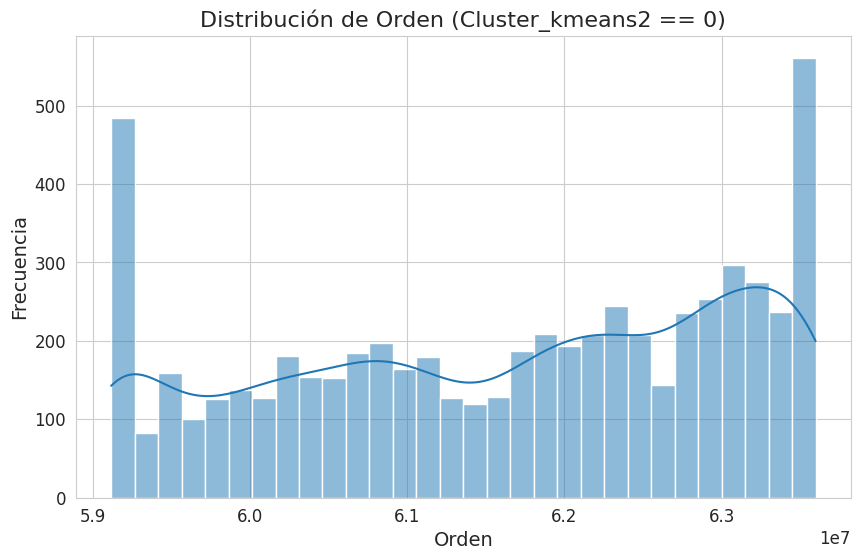

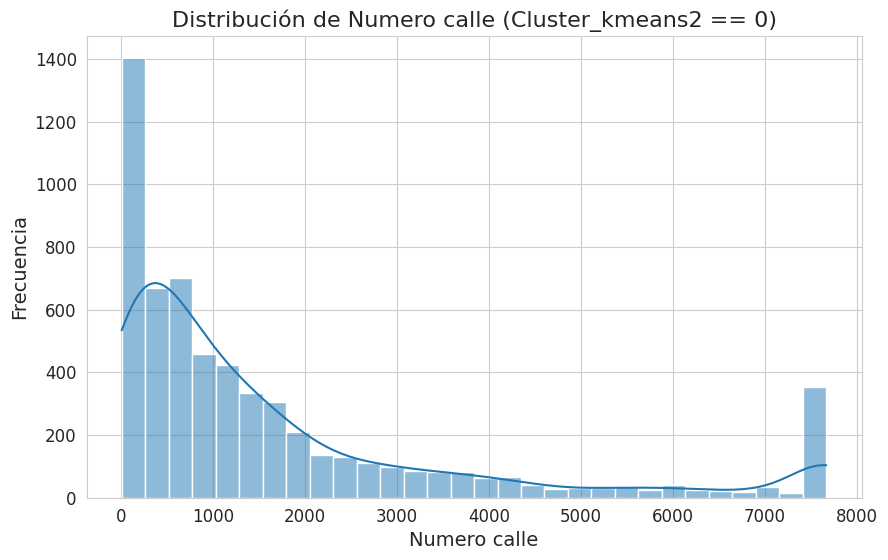

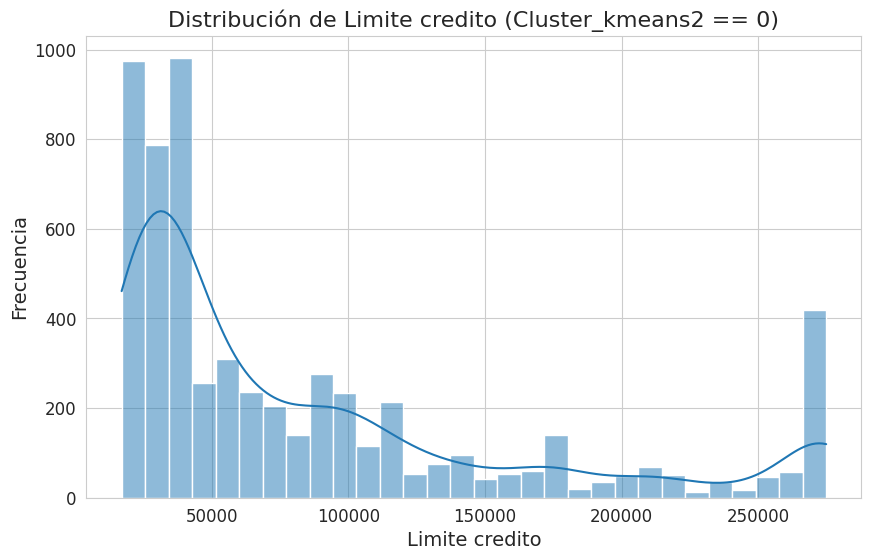

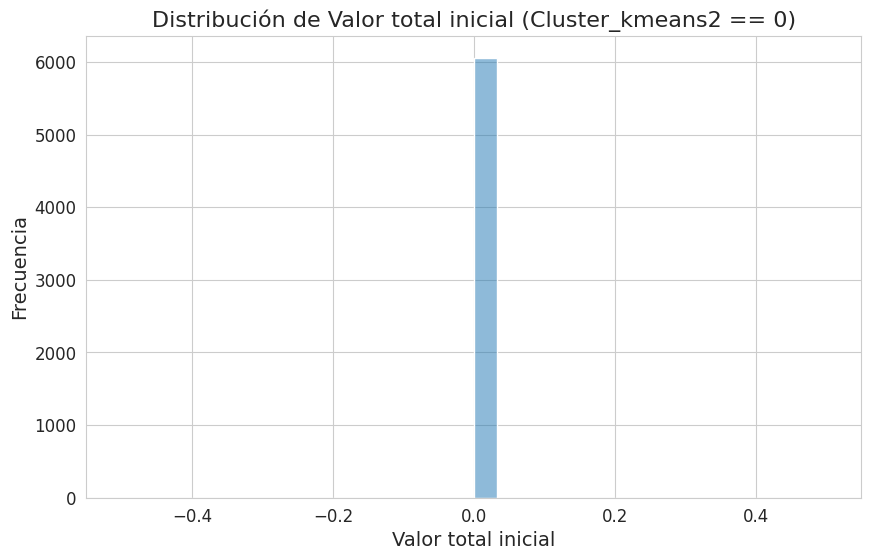

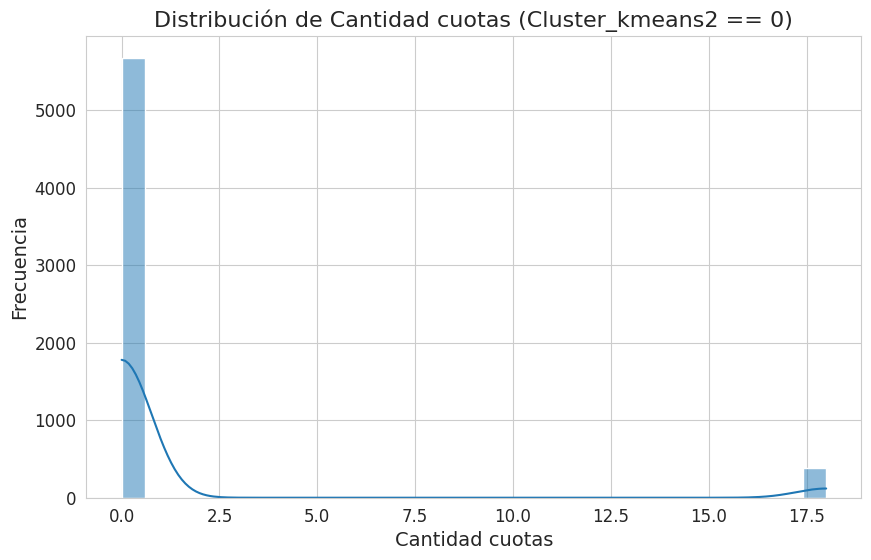

...

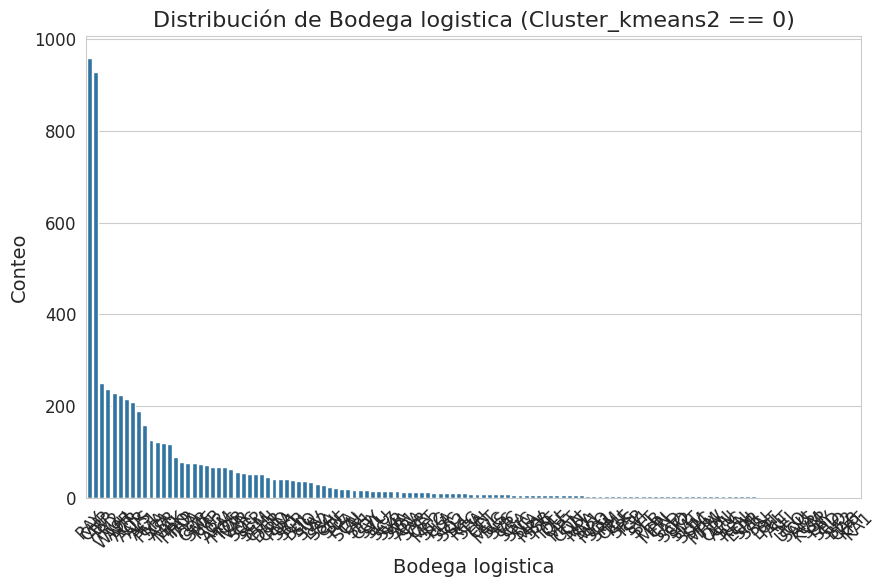

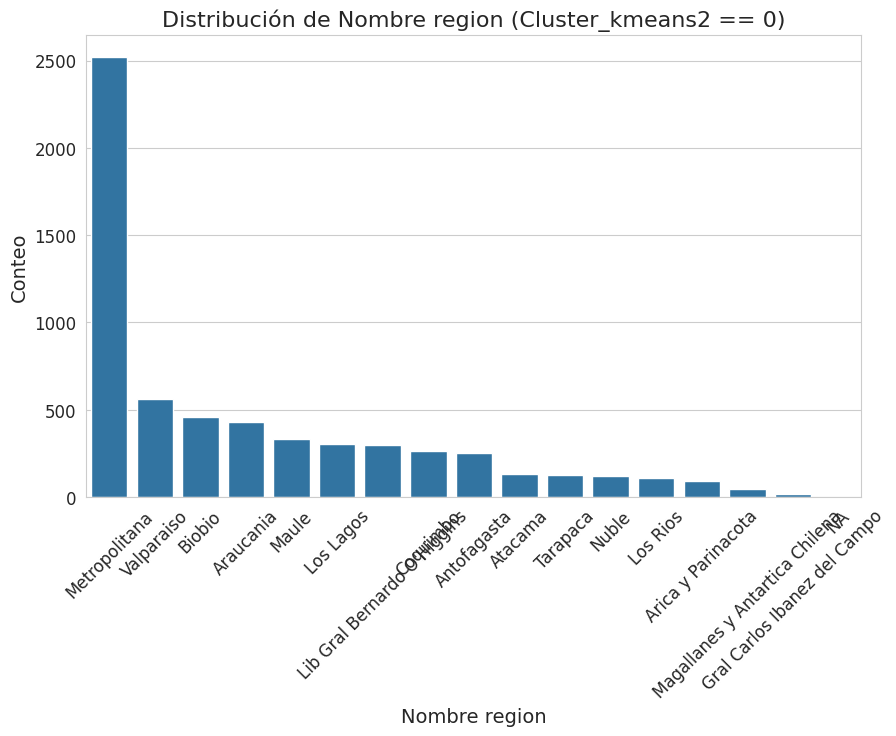

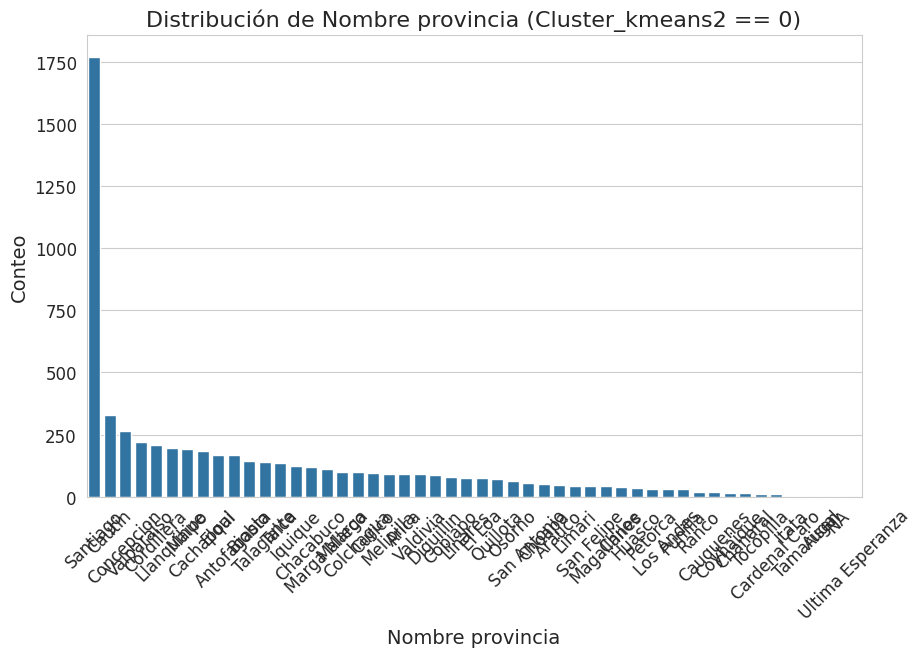

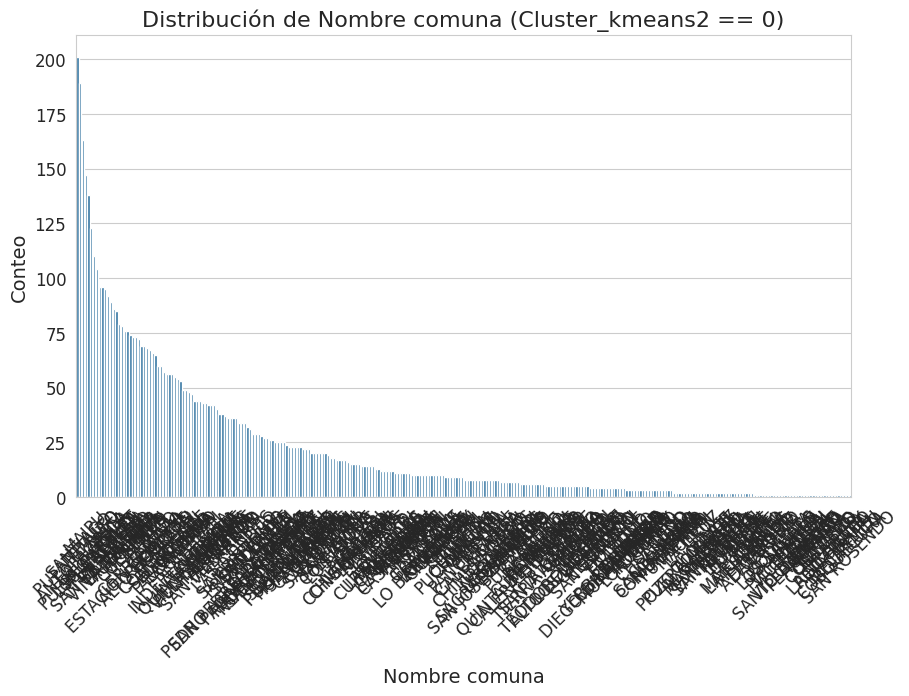

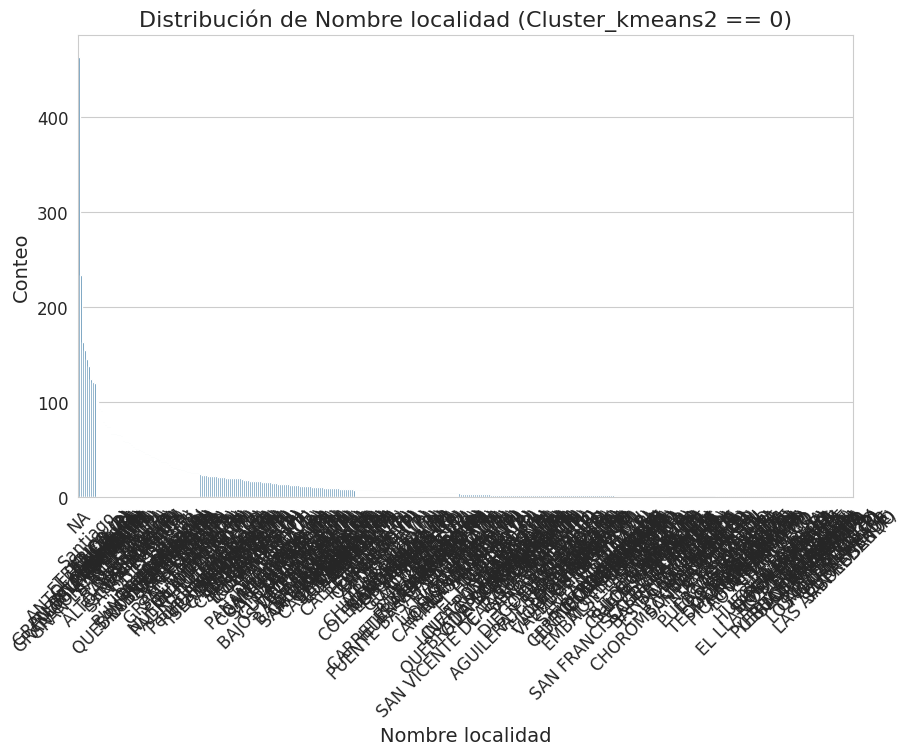

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


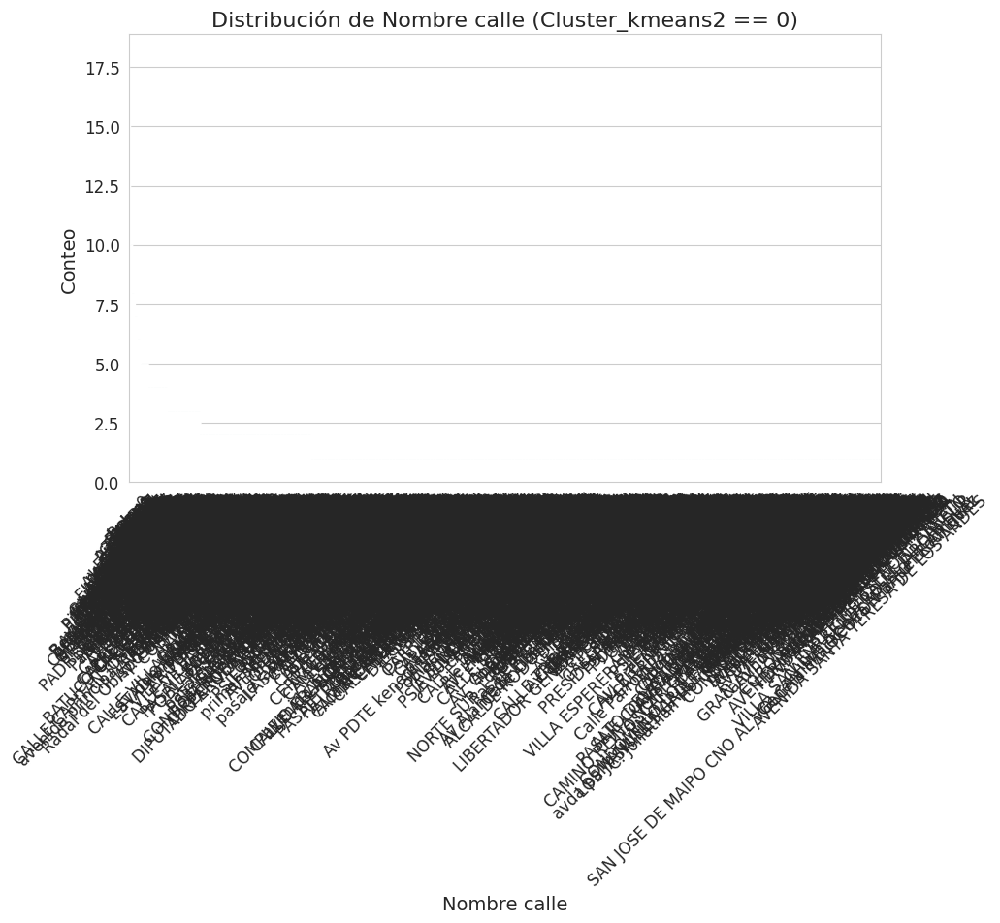

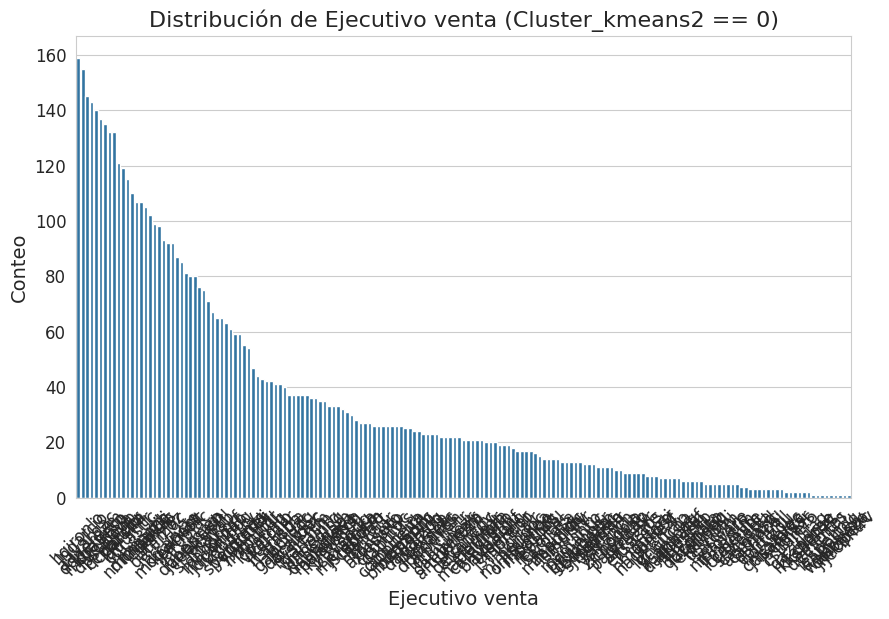

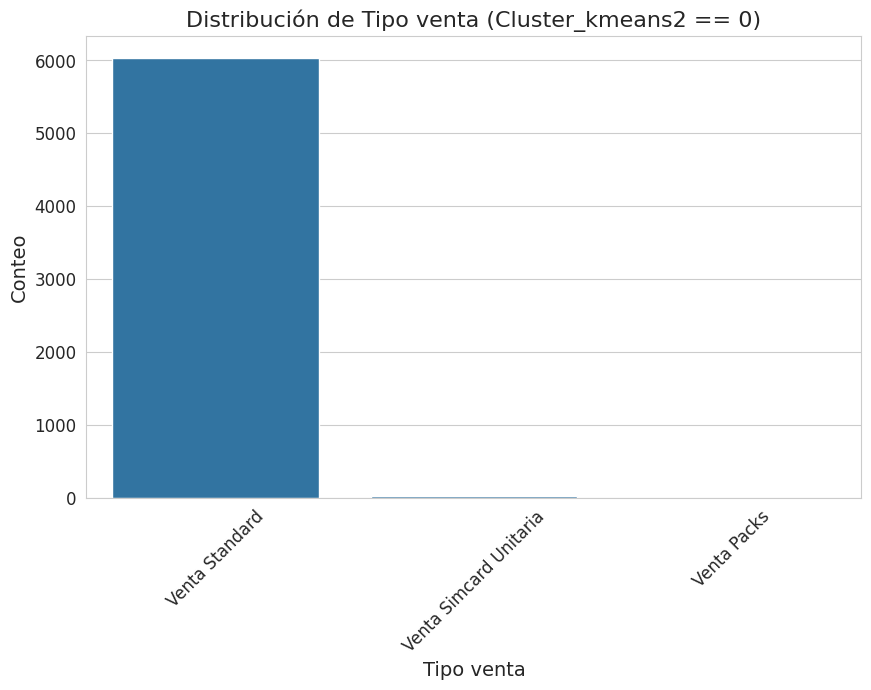

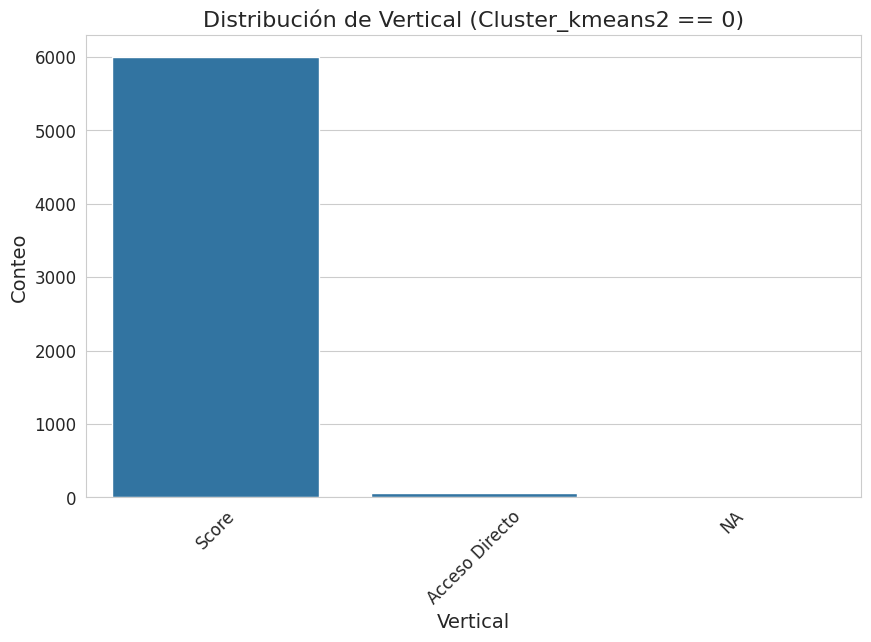

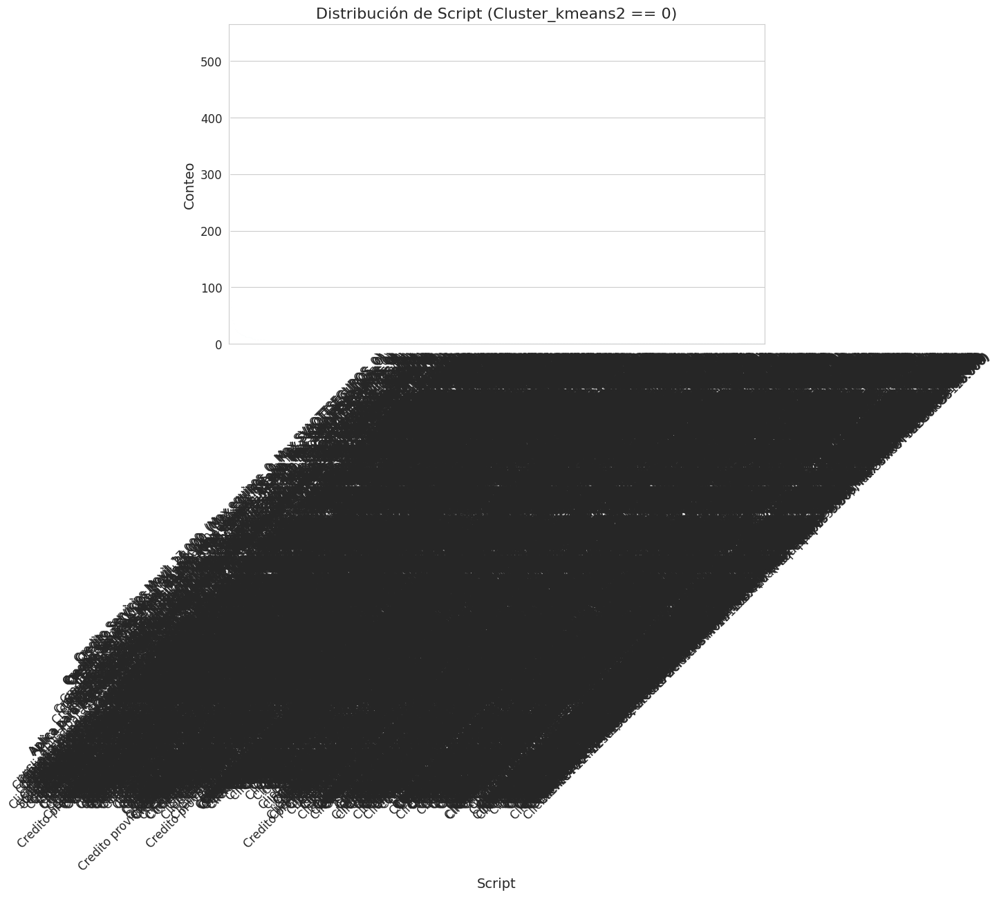

...

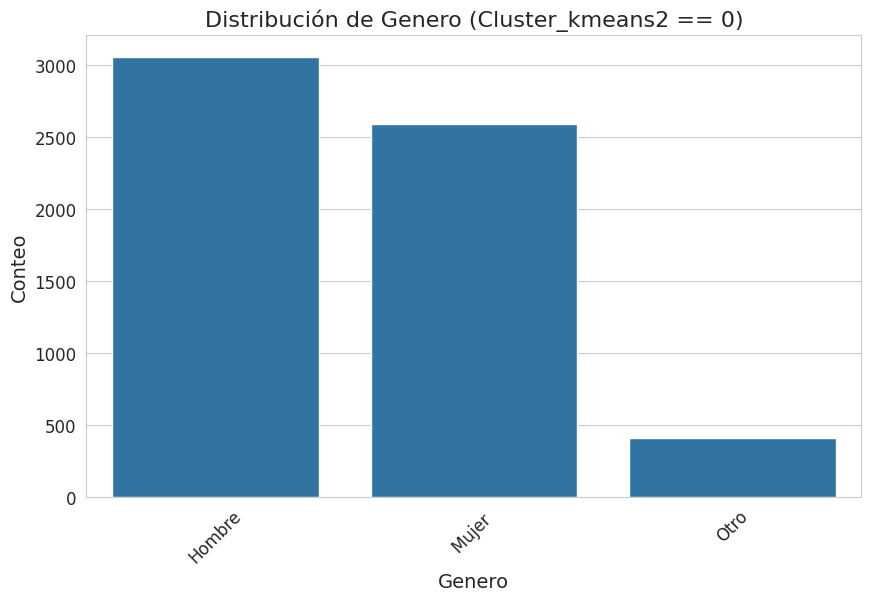

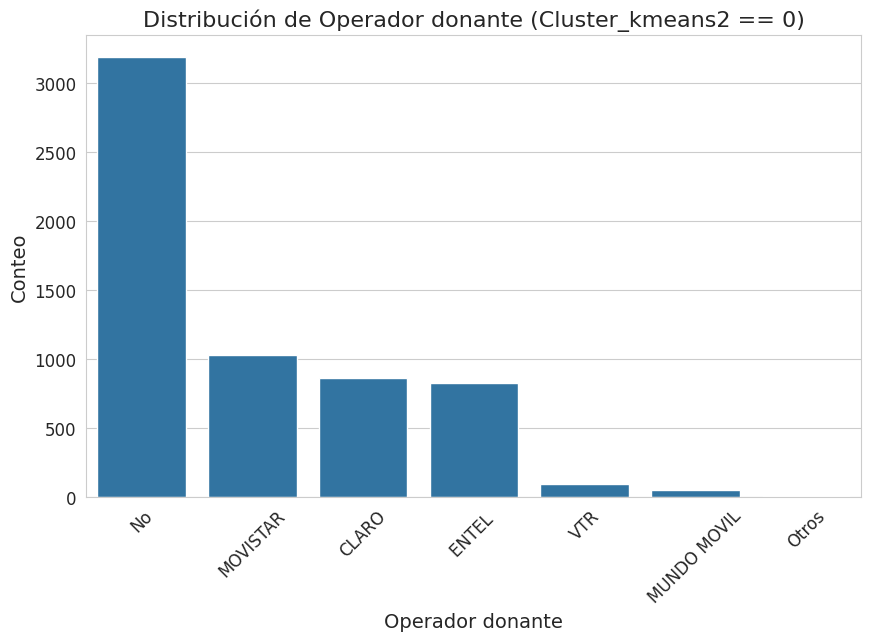

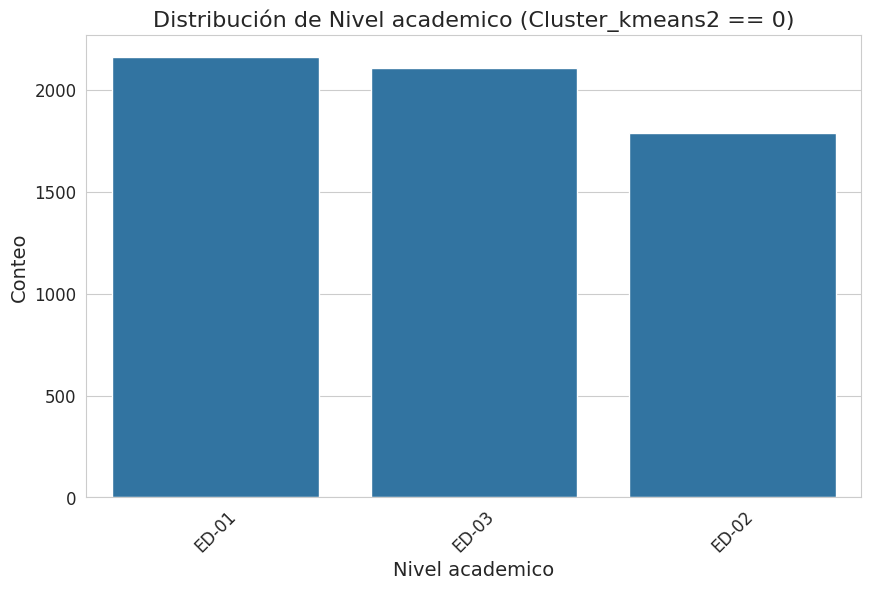

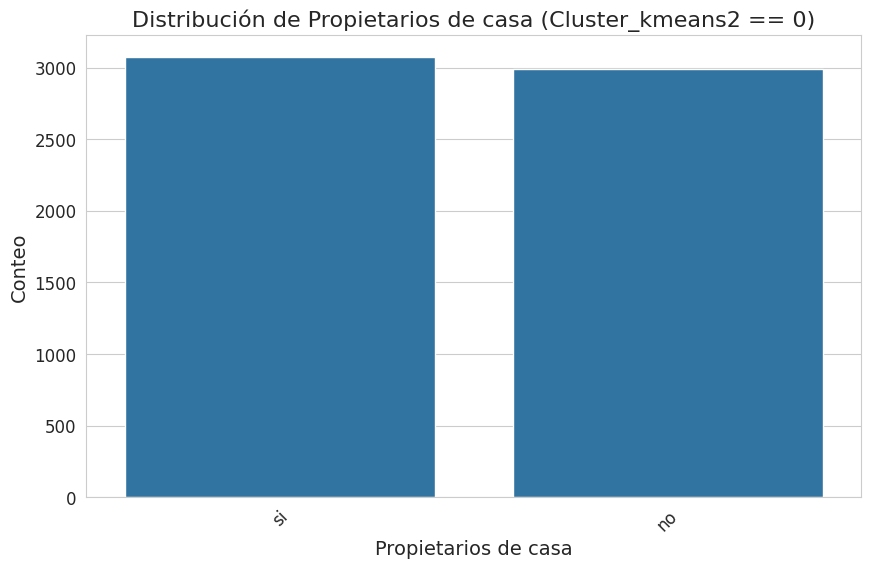

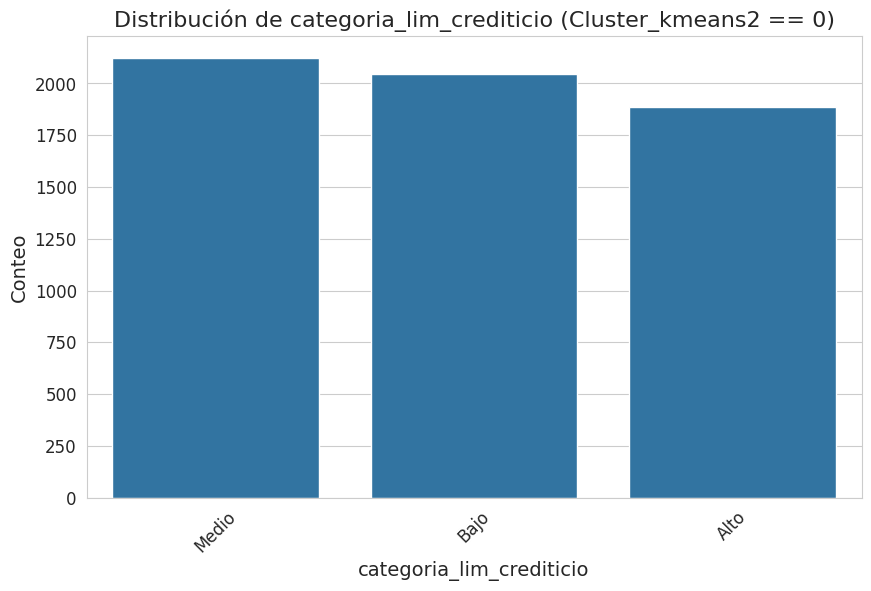

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar estilo bonito para los gráficos
plt.rcParams.update({
    'axes.titlesize': 16,
    'axes.labelsize': 14,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 12,
    'figure.figsize': (10, 6),
    'axes.grid': True
})
sns.set_style("whitegrid")

# Cargar tu base de datos (reemplazar con tu ruta si es necesario)
# consolidado = pd.read_csv('tu_archivo.csv')

# Filtrar los datos del cluster_kmeans2 == 0
cluster_0_kmeans = consolidado[consolidado['cluster_kmeans2'] == 0]

# Identificar variables cualitativas y cuantitativas
cualitativas = cluster_0_kmeans.select_dtypes(include=['object', 'category']).columns.tolist()
cuantitativas = cluster_0_kmeans.select_dtypes(include=['number']).drop(columns=['cluster_kmeans2']).columns.tolist()

### ANALISIS DESCRIPTIVO ###

# Variables cuantitativas
print("\n--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 0) ---\n")
print(cluster_0_kmeans[cuantitativas].describe().T)

# Variables cualitativas
print("\n--- Análisis descriptivo de variables cualitativas (cluster_kmeans2 == 0) ---\n")
for col in cualitativas:
    print(f"\nFrecuencias para {col}:")
    print(cluster_0_kmeans[col].value_counts(normalize=True) * 100)

### GRAFICOS ###

# Graficar variables cuantitativas: Histogramas
for col in cuantitativas:
    plt.figure(figsize=(10,6))
    sns.histplot(cluster_0_kmeans[col], kde=True, bins=30)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 0)')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.show()

# Graficar variables cualitativas: Barras
for col in cualitativas:
    plt.figure(figsize=(10,6))
    orden = cluster_0_kmeans[col].value_counts().index
    sns.countplot(data=cluster_0_kmeans, x=col, order=orden)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 0)')
    plt.xlabel(col)
    plt.ylabel('Conteo')
    plt.xticks(rotation=45)
    plt.show()


--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 1) ---

                          count          mean           std           min  \
Orden                    2346.0  6.172657e+07  1.353153e+06  5.911532e+07   
Numero calle             2346.0  1.268612e+03  1.854059e+03  7.000000e+00   
Limite credito           2346.0  8.428008e+04  7.437744e+04  1.700000e+04   
Valor total inicial      2346.0  0.000000e+00  0.000000e+00  0.000000e+00   
Cantidad cuotas          2346.0  1.358056e+00  4.755032e+00  0.000000e+00   
Valor plan               2346.0  1.399256e+05  8.757490e+02  1.399000e+05   
Valor equipo             2346.0  0.000000e+00  0.000000e+00  0.000000e+00   
Valor equipo mensual     2346.0  7.625959e+02  2.683709e+03  0.000000e+00   
Descuento                1685.0  0.000000e+00  0.000000e+00  0.000000e+00   
dias_desde_ingreso       2346.0  3.417502e+02  5.078077e+01  2.650000e+02   
duracion estado actual   2346.0  1.252984e+01  9.005291e+00  5.000000e+0

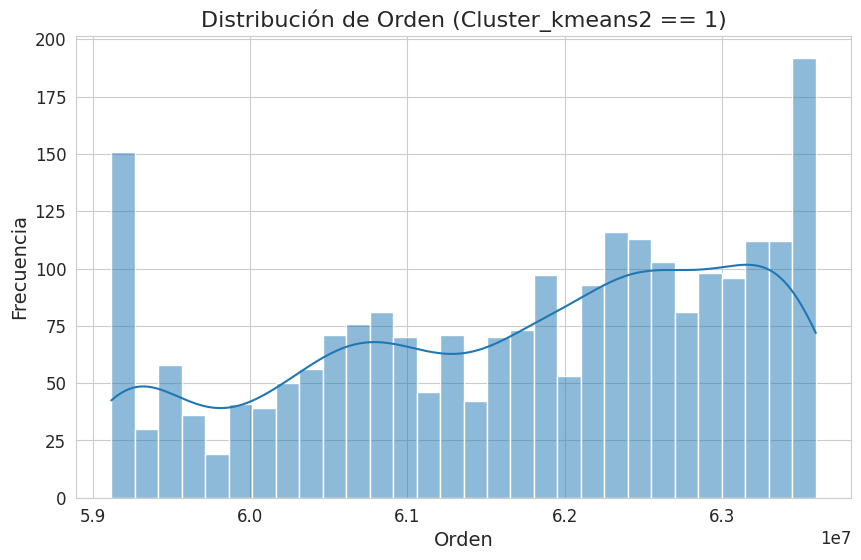

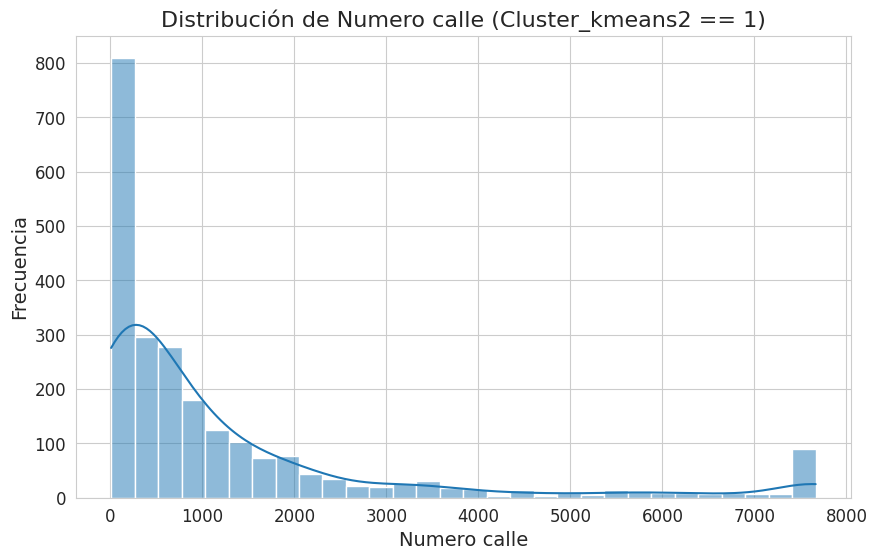

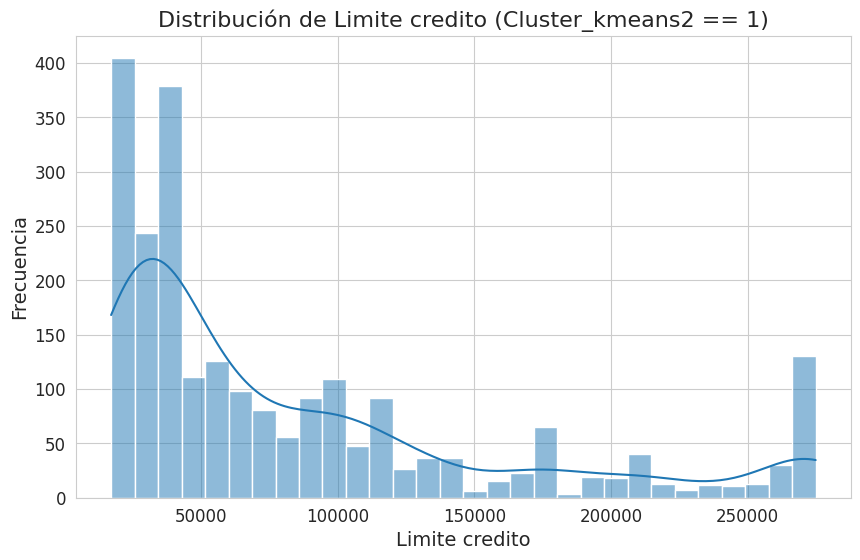

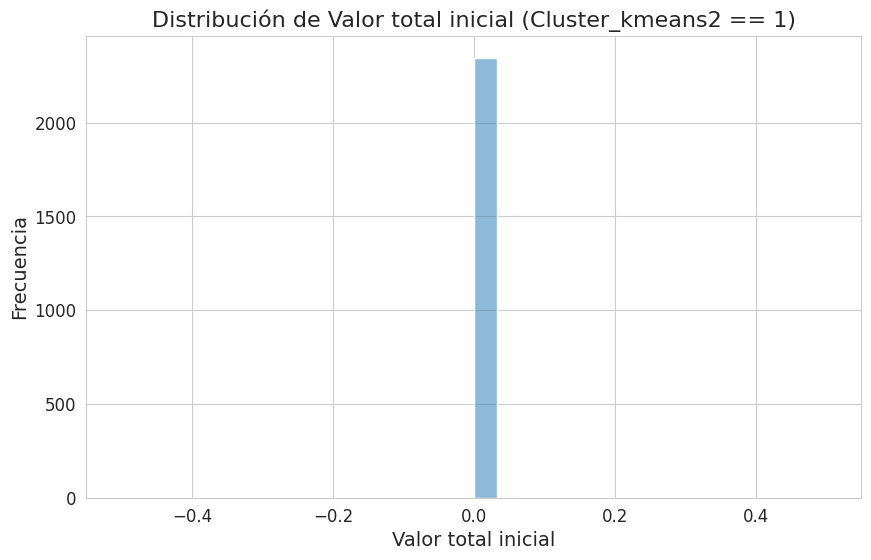

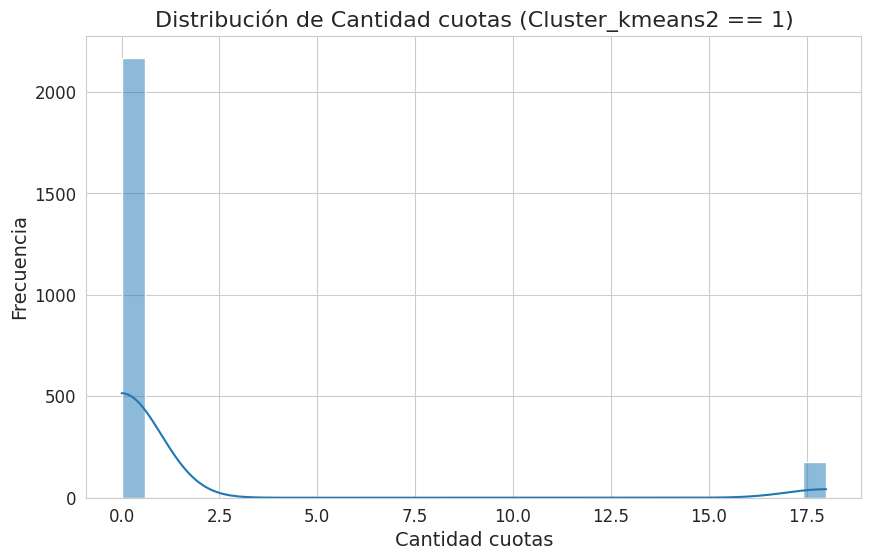

...

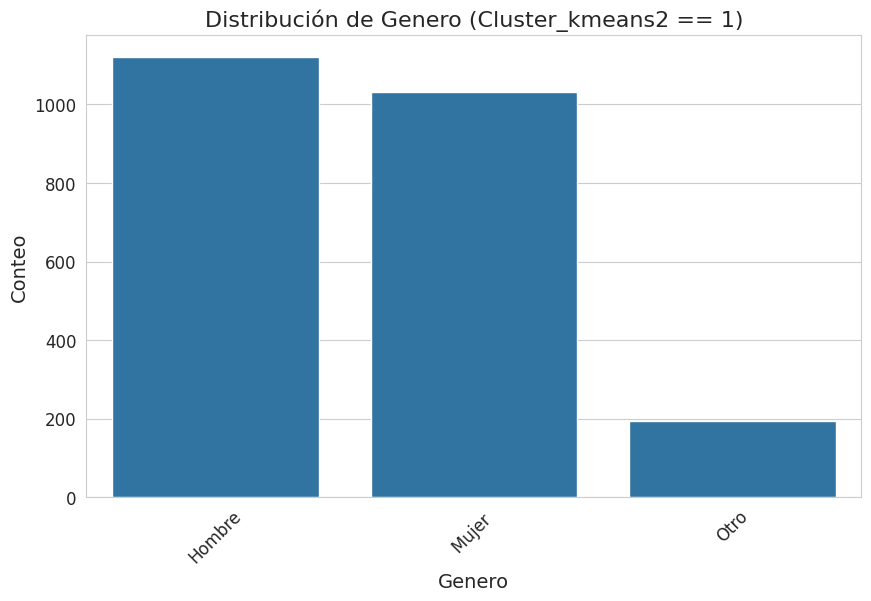

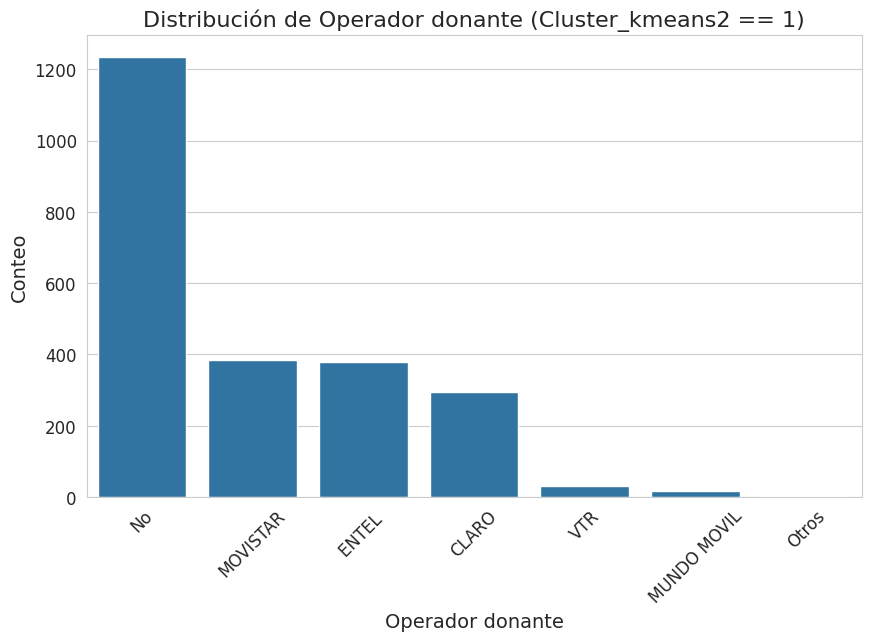

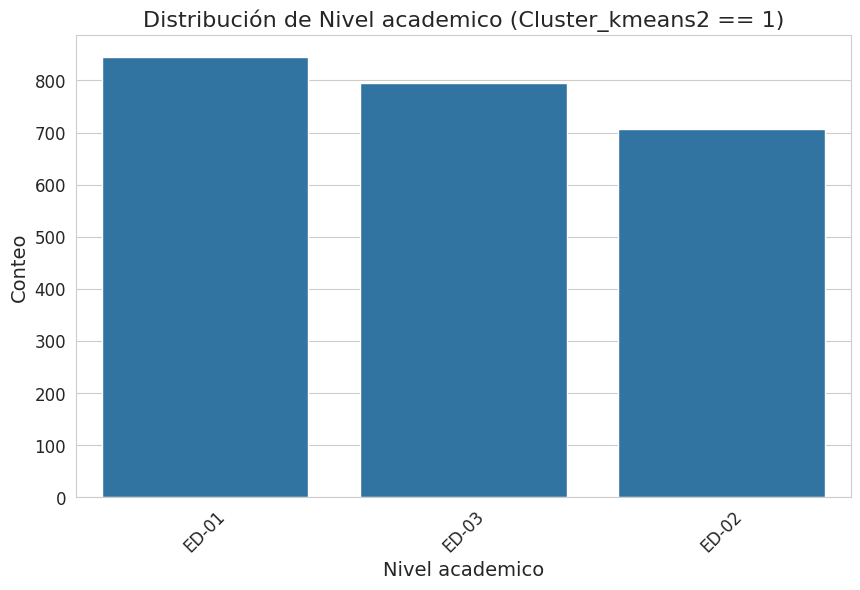

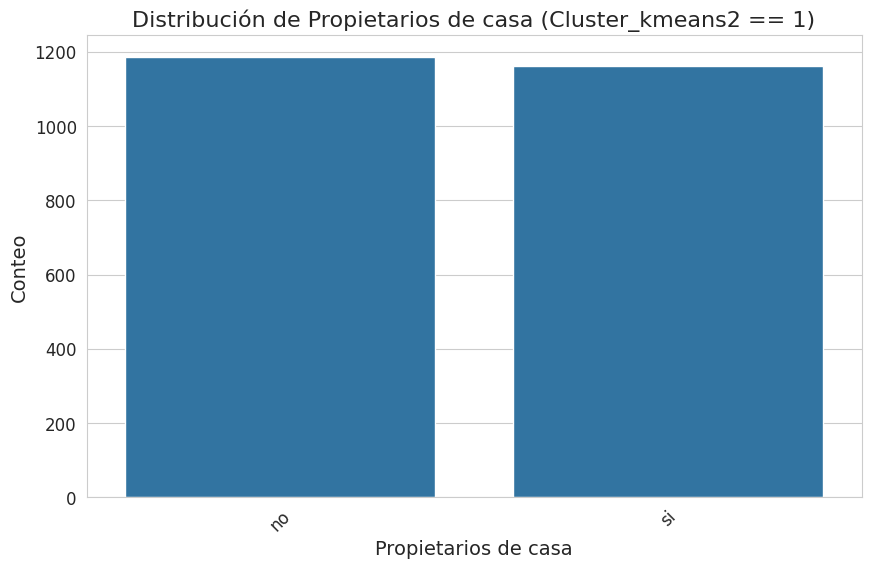

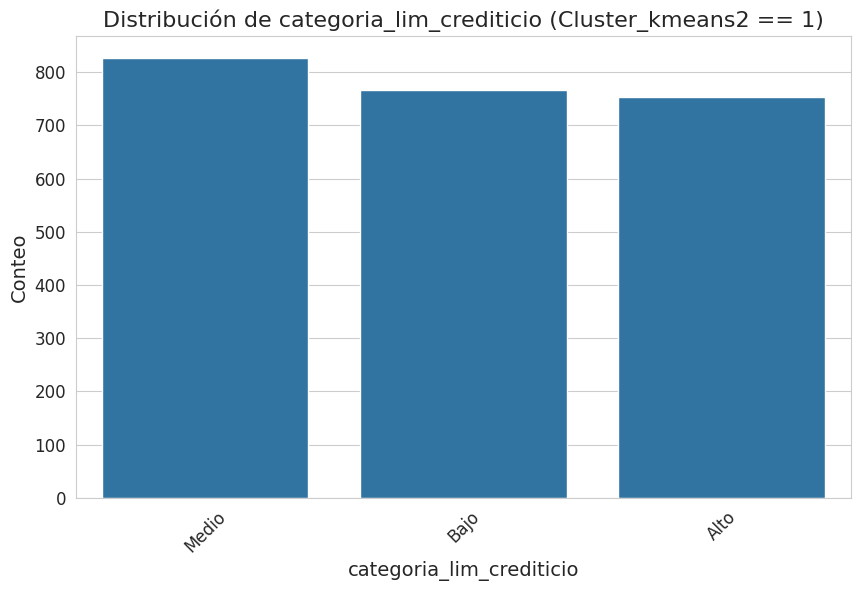

In [ ]:
# Configurar estilo bonito para los gráficos
plt.rcParams.update({
    'axes.titlesize': 16,
    'axes.labelsize': 14,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 12,
    'figure.figsize': (10, 6),
    'axes.grid': True
})
sns.set_style("whitegrid")

# Cargar tu base de datos (reemplazar con tu ruta si es necesario)
# consolidado = pd.read_csv('tu_archivo.csv')

# Filtrar los datos del cluster_kmeans2 == 1
cluster_1_kmeans = consolidado[consolidado['cluster_kmeans2'] == 1]

# Identificar variables cualitativas y cuantitativas
cualitativas = cluster_1_kmeans.select_dtypes(include=['object', 'category']).columns.tolist()
cuantitativas = cluster_1_kmeans.select_dtypes(include=['number']).drop(columns=['cluster_kmeans2']).columns.tolist()

### ANALISIS DESCRIPTIVO ###

# Variables cuantitativas
print("\n--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 1) ---\n")
print(cluster_1_kmeans[cuantitativas].describe().T)

# Variables cualitativas
print("\n--- Análisis descriptivo de variables cualitativas (cluster_kmeans2 == 1) ---\n")
for col in cualitativas:
    print(f"\nFrecuencias para {col}:")
    print(cluster_1_kmeans[col].value_counts(normalize=True) * 100)

### GRAFICOS ###

# Graficar variables cuantitativas: Histogramas
for col in cuantitativas:
    plt.figure(figsize=(10,6))
    sns.histplot(cluster_1_kmeans[col], kde=True, bins=30)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 1)')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.show()

# Graficar variables cualitativas: Barras
for col in cualitativas:
    plt.figure(figsize=(10,6))
    orden = cluster_1_kmeans[col].value_counts().index
    sns.countplot(data=cluster_1_kmeans, x=col, order=orden)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 1)')
    plt.xlabel(col)
    plt.ylabel('Conteo')
    plt.xticks(rotation=45)
    plt.show()



--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 2) ---

                         count          mean           std          min  \
Orden                    689.0  6.074720e+07  1.445252e+06  59115315.25   
Numero calle             689.0  1.552566e+03  1.990023e+03         7.00   
Limite credito           689.0  5.165999e+04  5.857615e+04     17000.00   
Valor total inicial      689.0  0.000000e+00  0.000000e+00         0.00   
Cantidad cuotas          689.0  9.143687e-01  3.955411e+00         0.00   
Valor plan               689.0  1.199000e+05  0.000000e+00    119900.00   
Valor equipo             689.0  0.000000e+00  0.000000e+00         0.00   
Valor equipo mensual     689.0  4.840348e+02  2.141494e+03         0.00   
Descuento                645.0  0.000000e+00  0.000000e+00         0.00   
dias_desde_ingreso       689.0  3.779652e+02  5.374367e+01       265.00   
duracion estado actual   689.0  4.004354e+00  5.862894e+00         0.00   
churn potencial    

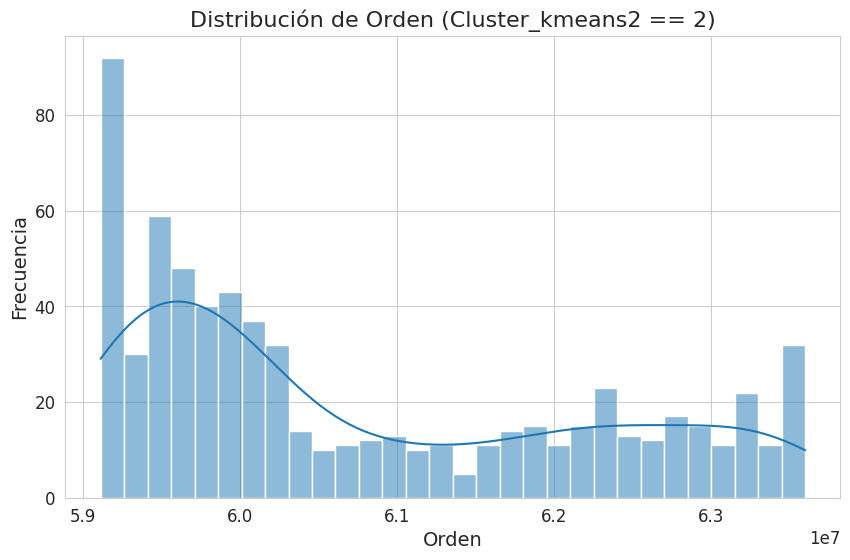

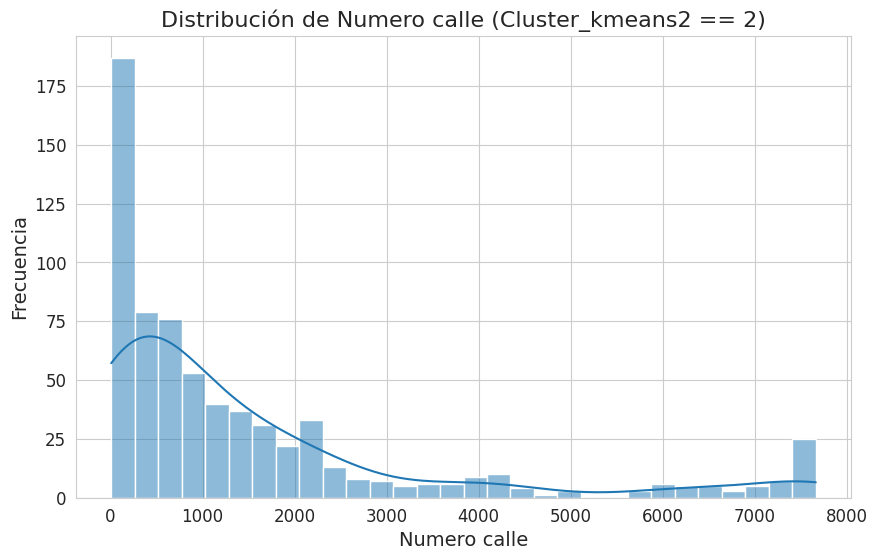

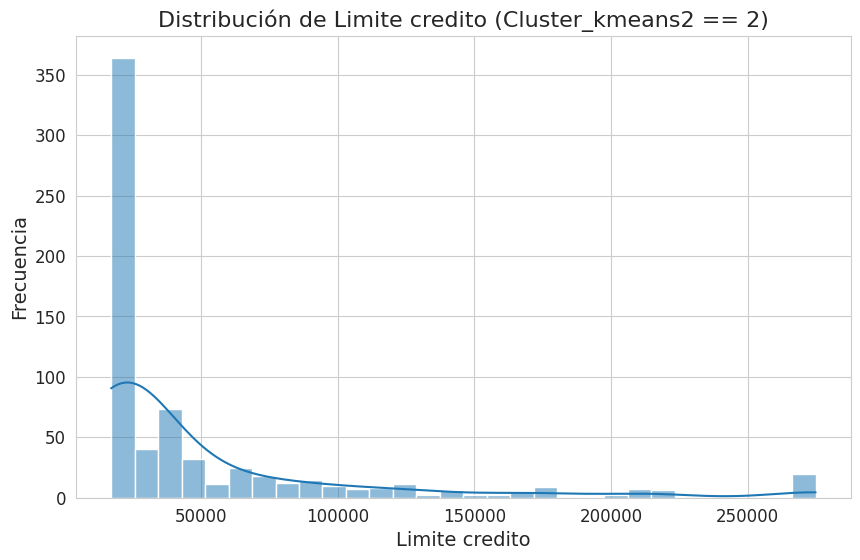

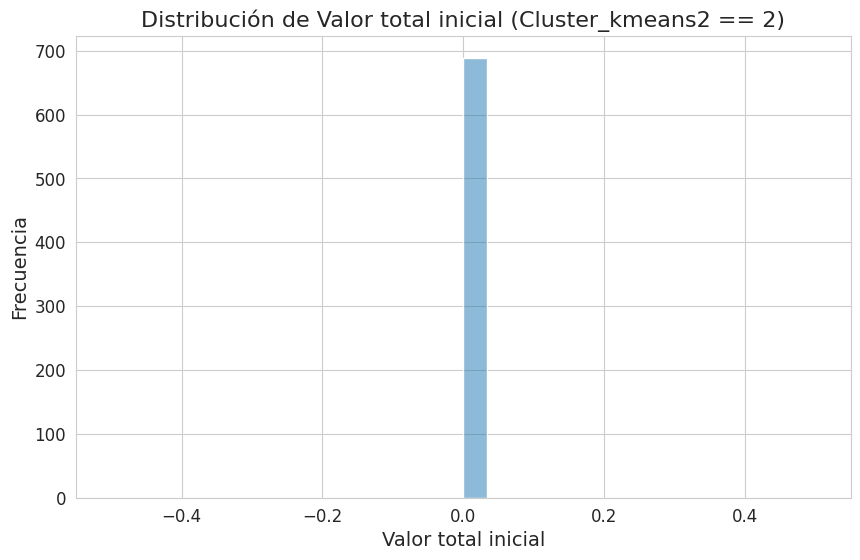

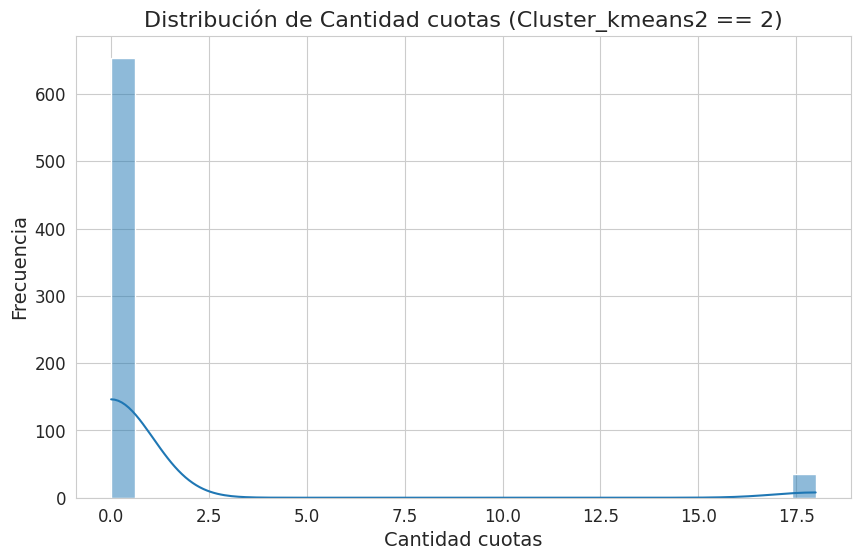

...

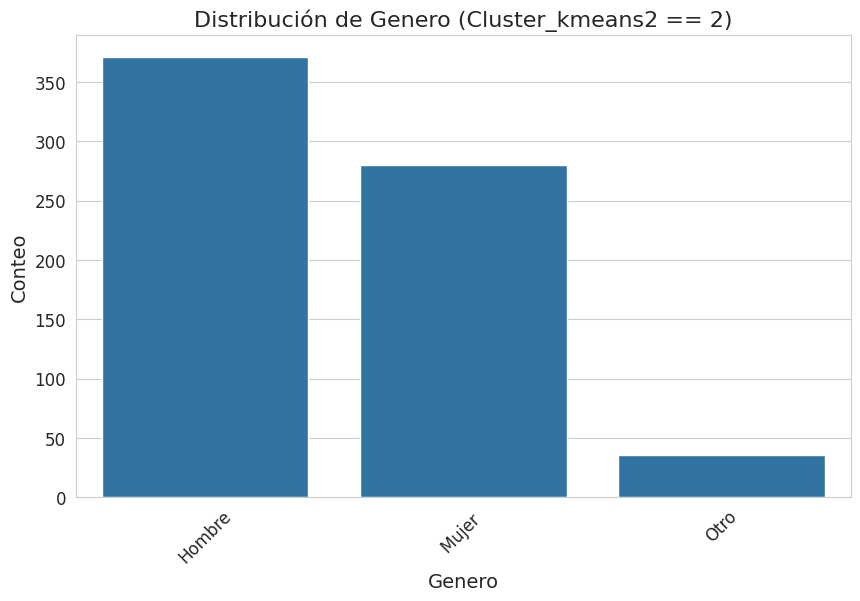

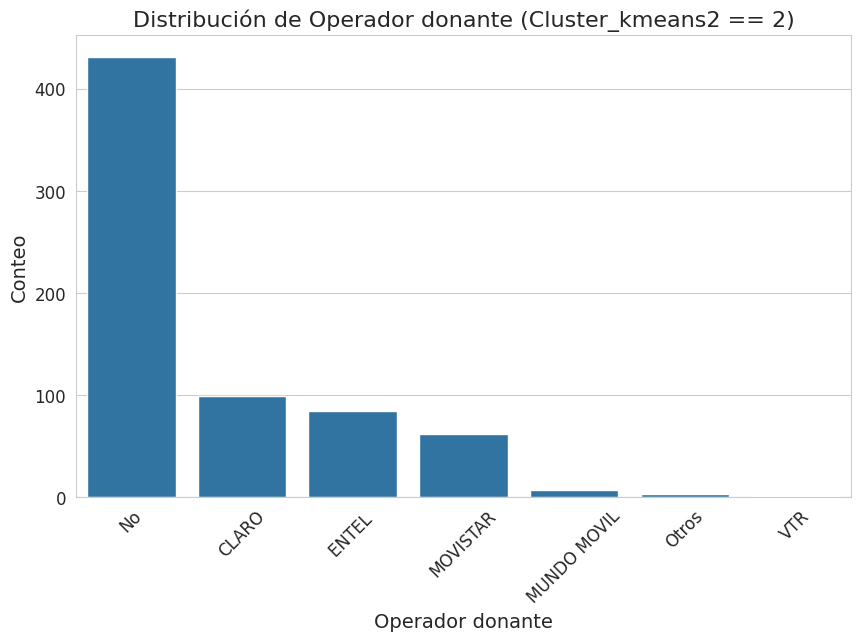

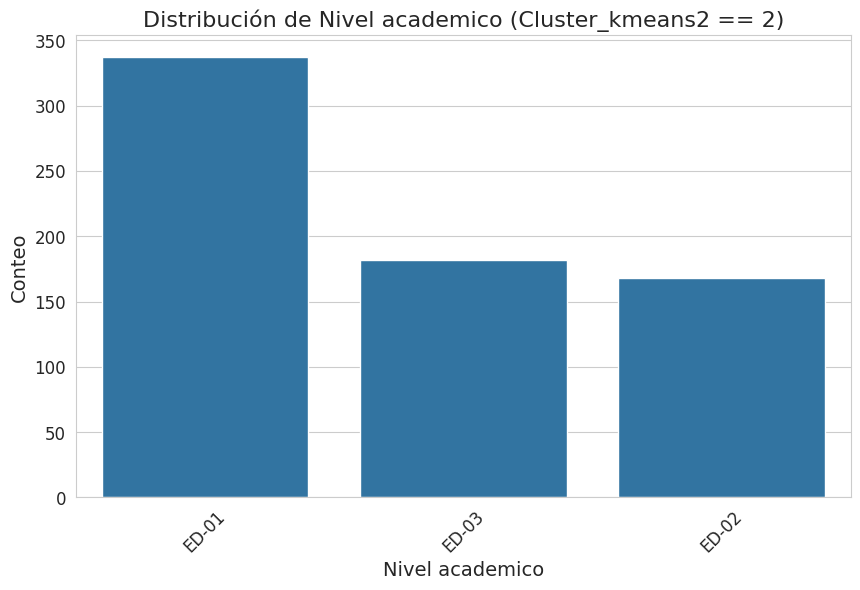

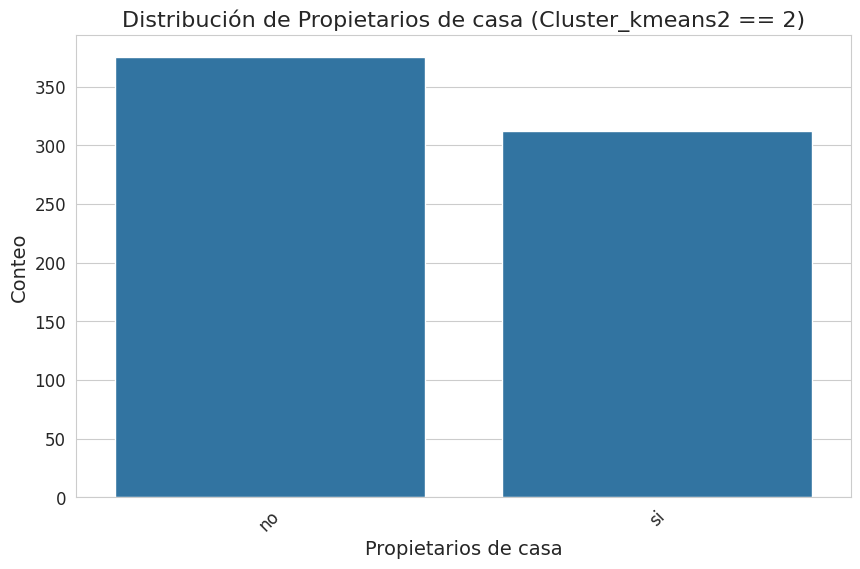

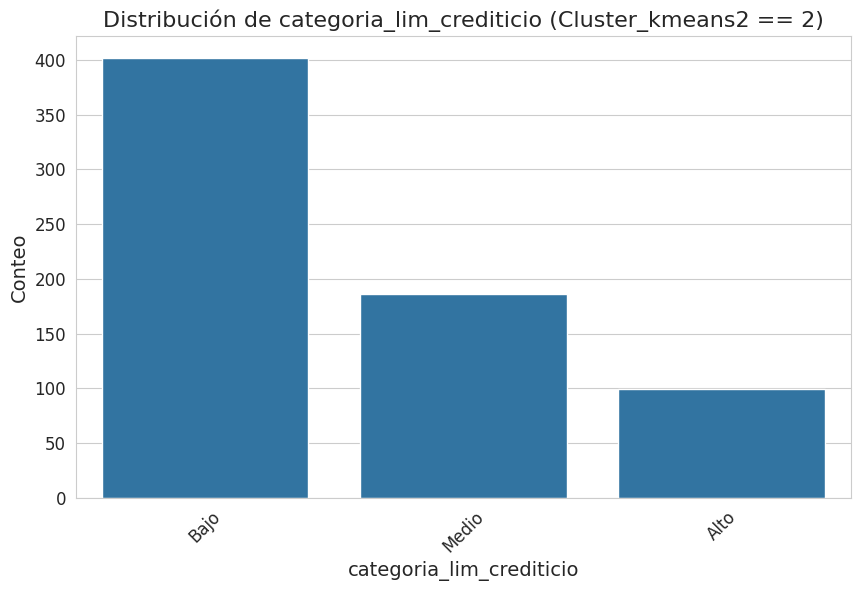

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar estilo bonito para los gráficos
plt.rcParams.update({
    'axes.titlesize': 16,
    'axes.labelsize': 14,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 12,
    'figure.figsize': (10, 6),
    'axes.grid': True
})
sns.set_style("whitegrid")

# Cargar tu base de datos (reemplazar con tu ruta si es necesario)
# consolidado = pd.read_csv('tu_archivo.csv')

# Filtrar los datos del cluster_kmeans2 == 2
cluster_2_kmeans = consolidado[consolidado['cluster_kmeans2'] == 2]

# Identificar variables cualitativas y cuantitativas
cualitativas = cluster_2_kmeans.select_dtypes(include=['object', 'category']).columns.tolist()
cuantitativas = cluster_2_kmeans.select_dtypes(include=['number']).drop(columns=['cluster_kmeans2']).columns.tolist()

### ANALISIS DESCRIPTIVO ###

# Variables cuantitativas
print("\n--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 2) ---\n")
print(cluster_2_kmeans[cuantitativas].describe().T)

# Variables cualitativas
print("\n--- Análisis descriptivo de variables cualitativas (cluster_kmeans2 == 2) ---\n")
for col in cualitativas:
    print(f"\nFrecuencias para {col}:")
    print(cluster_2_kmeans[col].value_counts(normalize=True) * 100)

### GRAFICOS ###

# Graficar variables cuantitativas: Histogramas
for col in cuantitativas:
    plt.figure(figsize=(10,6))
    sns.histplot(cluster_2_kmeans[col], kde=True, bins=30)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 2)')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.show()

# Graficar variables cualitativas: Barras
for col in cualitativas:
    plt.figure(figsize=(10,6))
    orden = cluster_2_kmeans[col].value_counts().index
    sns.countplot(data=cluster_2_kmeans, x=col, order=orden)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 2)')
    plt.xlabel(col)
    plt.ylabel('Conteo')
    plt.xticks(rotation=45)
    plt.show()



--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 3) ---

                          count          mean           std           min  \
Orden                    1826.0  6.192329e+07  1.297520e+06  5.911532e+07   
Numero calle             1826.0  1.629114e+03  2.042143e+03  7.000000e+00   
Limite credito           1826.0  9.131472e+04  8.140489e+04  1.700000e+04   
Valor total inicial      1826.0  0.000000e+00  0.000000e+00  0.000000e+00   
Cantidad cuotas          1826.0  1.458927e+00  4.913800e+00  0.000000e+00   
Valor plan               1826.0  1.698014e+05  9.882200e+02  1.599000e+05   
Valor equipo             1826.0  0.000000e+00  0.000000e+00  0.000000e+00   
Valor equipo mensual     1826.0  8.139650e+02  2.754802e+03  0.000000e+00   
Descuento                1046.0  0.000000e+00  0.000000e+00  0.000000e+00   
dias_desde_ingreso       1826.0  3.344107e+02  4.889245e+01  2.650000e+02   
duracion estado actual   1826.0  4.398138e+00  6.991249e+00  0.000000e+0

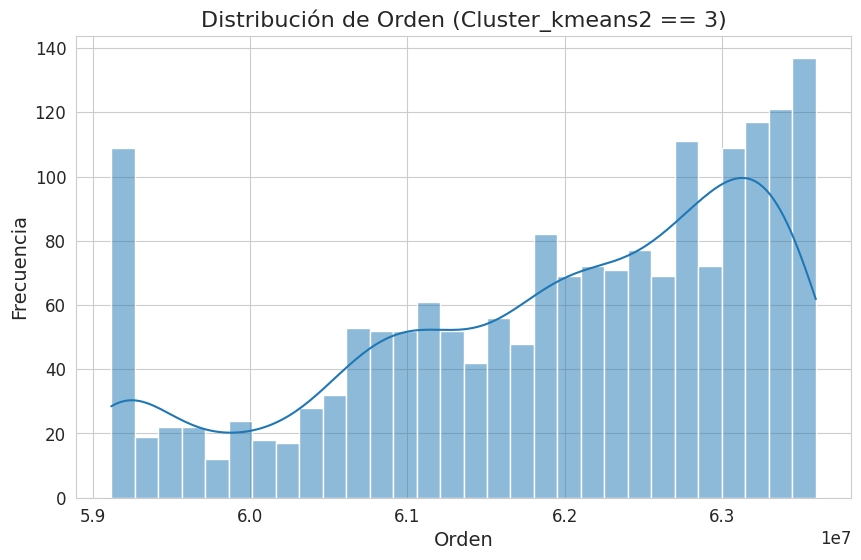

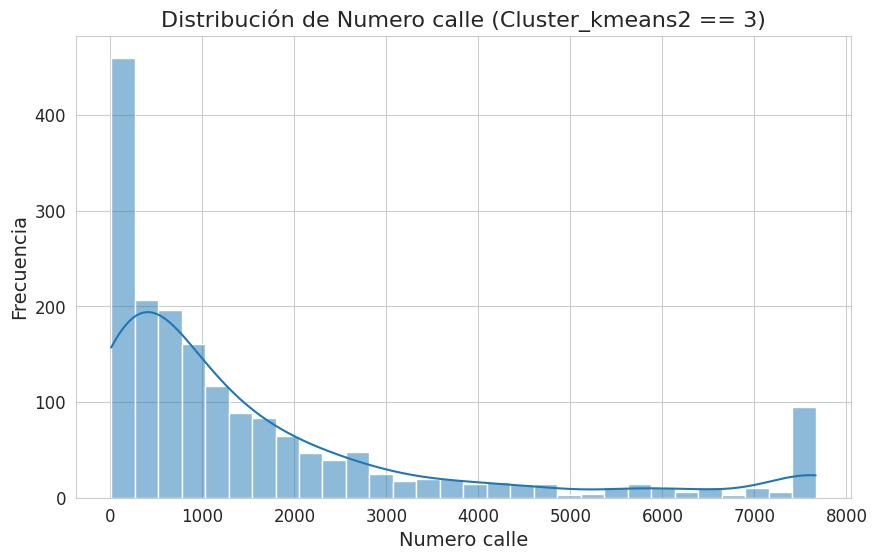

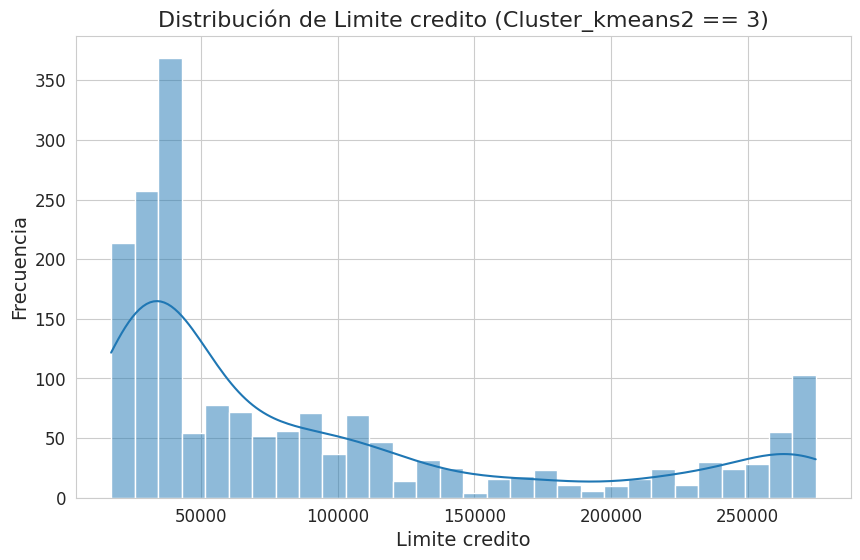

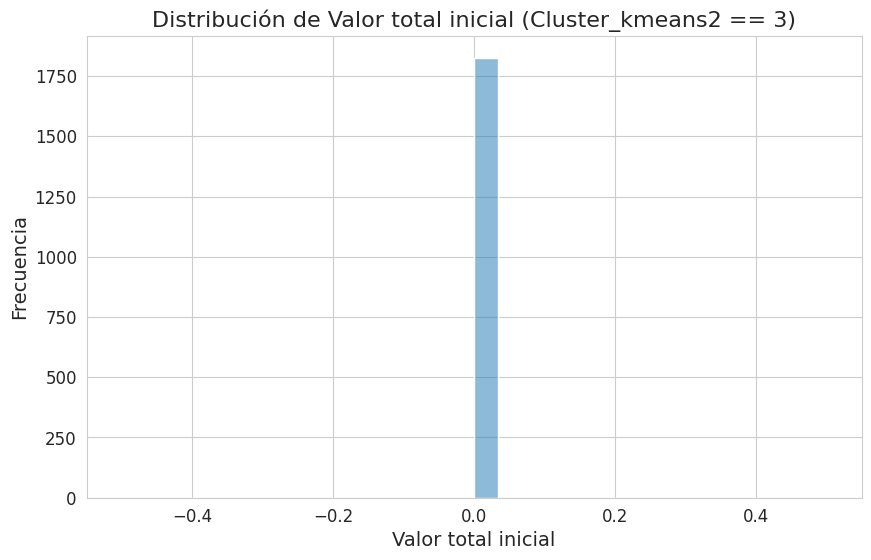

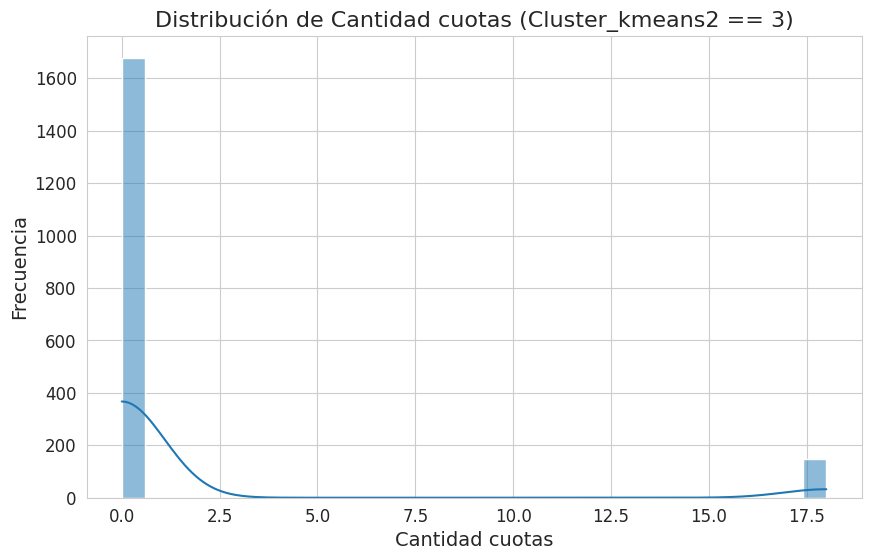

...

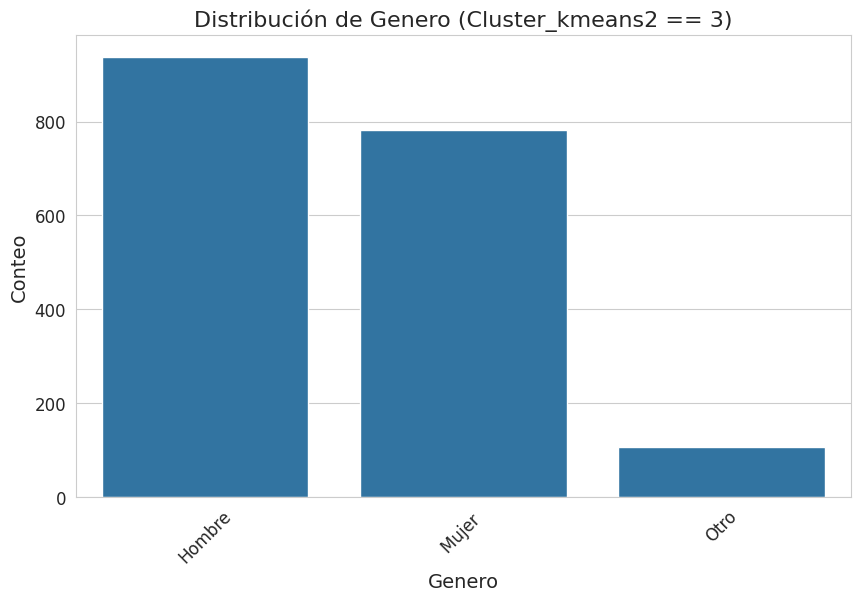

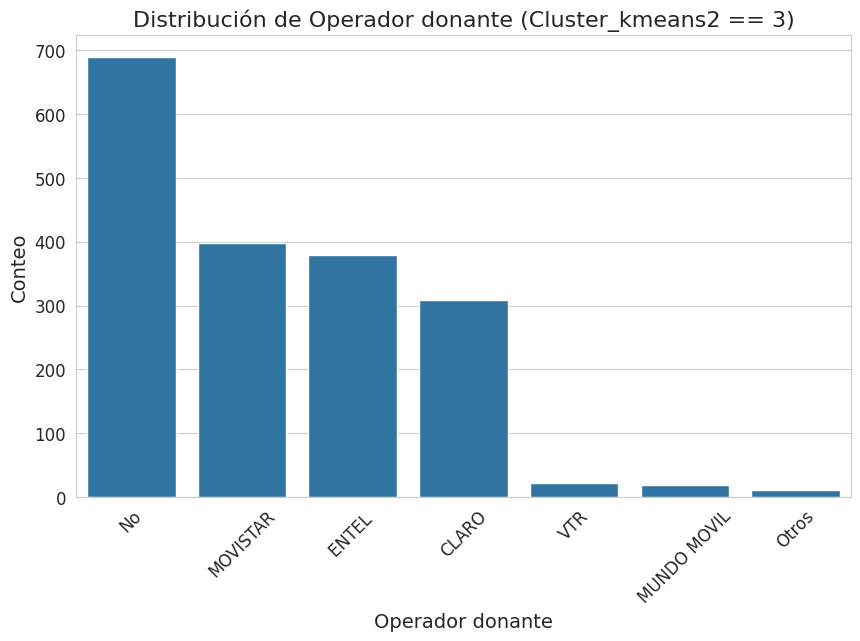

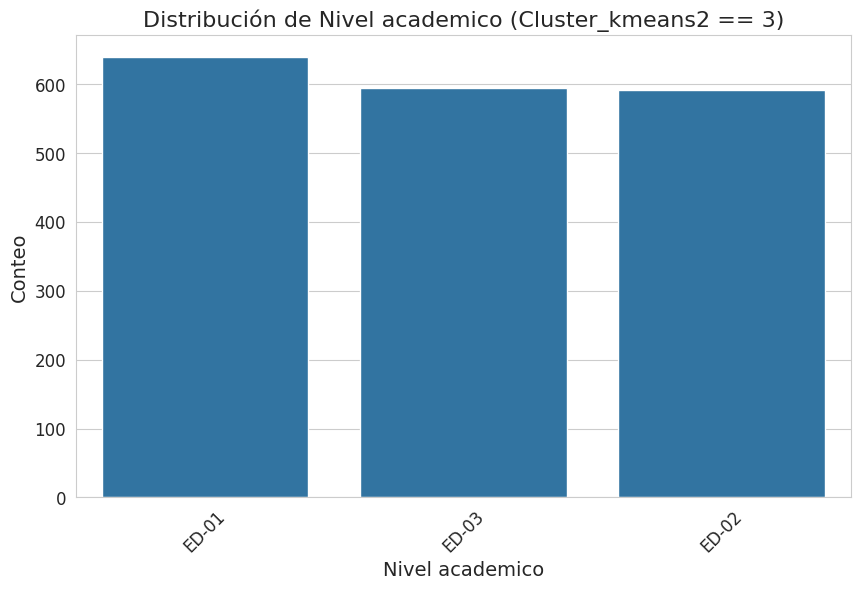

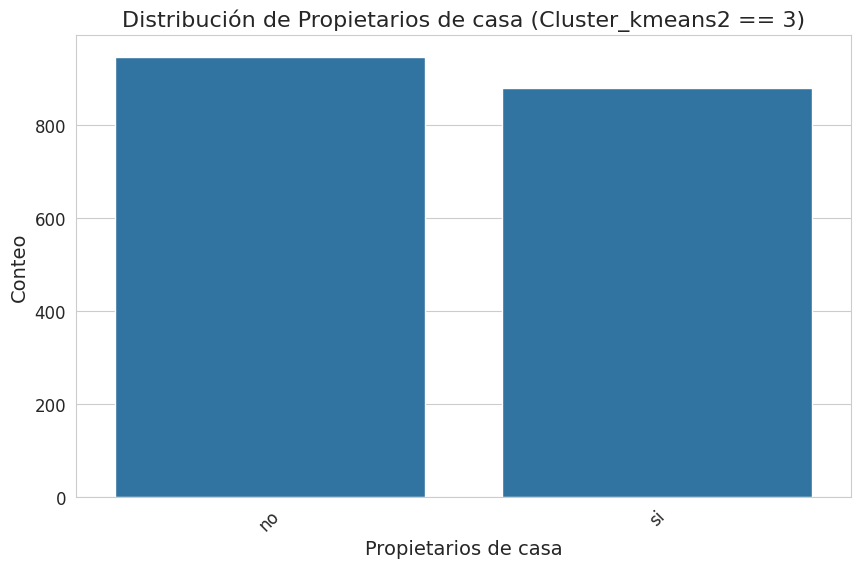

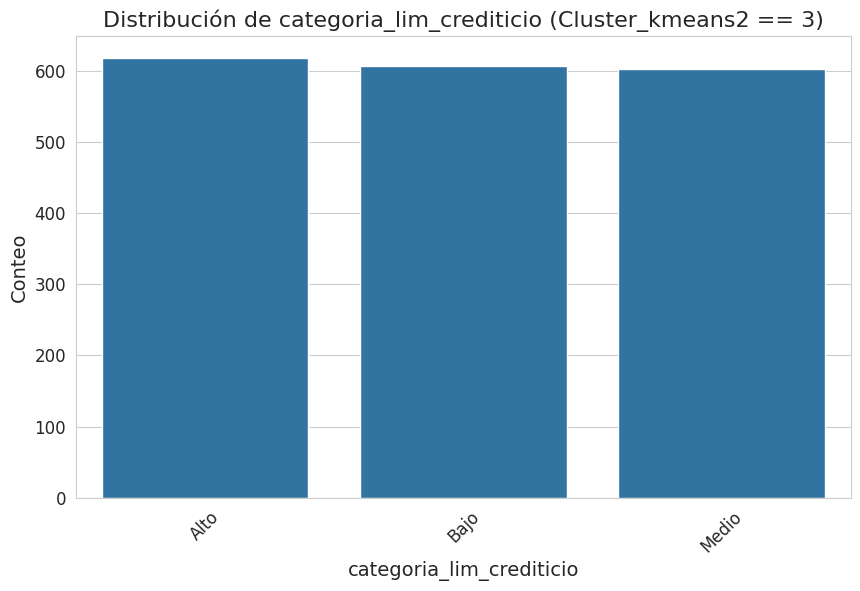

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Configurar estilo bonito para los gráficos
plt.rcParams.update({
    'axes.titlesize': 16,
    'axes.labelsize': 14,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 12,
    'figure.figsize': (10, 6),
    'axes.grid': True
})
sns.set_style("whitegrid")

# Cargar tu base de datos (reemplazar con tu ruta si es necesario)
# consolidado = pd.read_csv('tu_archivo.csv')

# Filtrar los datos del cluster_kmeans2 == 3 (no 2)
cluster_3_kmeans = consolidado[consolidado['cluster_kmeans2'] == 3]

# Identificar variables cualitativas y cuantitativas
cualitativas = cluster_3_kmeans.select_dtypes(include=['object', 'category']).columns.tolist()
cuantitativas = cluster_3_kmeans.select_dtypes(include=['number']).drop(columns=['cluster_kmeans2']).columns.tolist()

### ANALISIS DESCRIPTIVO ###

# Variables cuantitativas
print("\n--- Análisis descriptivo de variables cuantitativas (cluster_kmeans2 == 3) ---\n")
print(cluster_3_kmeans[cuantitativas].describe().T)

# Variables cualitativas
print("\n--- Análisis descriptivo de variables cualitativas (cluster_kmeans2 == 3) ---\n")
for col in cualitativas:
    print(f"\nFrecuencias para {col}:")
    print(cluster_3_kmeans[col].value_counts(normalize=True) * 100)

### GRAFICOS ###

# Graficar variables cuantitativas: Histogramas
for col in cuantitativas:
    plt.figure(figsize=(10,6))
    sns.histplot(cluster_3_kmeans[col], kde=True, bins=30)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 3)')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.show()

# Graficar variables cualitativas: Barras
for col in cualitativas:
    plt.figure(figsize=(10,6))
    orden = cluster_3_kmeans[col].value_counts().index
    sns.countplot(data=cluster_3_kmeans, x=col, order=orden)
    plt.title(f'Distribución de {col} (Cluster_kmeans2 == 3)')
    plt.xlabel(col)
    plt.ylabel('Conteo')
    plt.xticks(rotation=45)
    plt.show()


## 📈 Aplicación modelos

### K-means


In [ ]:
# 🔹 Subset t (Subset 5)
columnas_subset_t = [
    'Genero_label', 'log_promedio_gasto_segmento',
    'log_segmento_plan', 'categoria_lim_crediticio_label',
    'log_duracion_estado_actual', 'log_clv_estimado'
]

print("\n🔍 Evaluando Subset t (Subset 5)")
df_subset_t = consolidado_hiper2[columnas_subset_t].copy()

# 🔹 Escalamiento
df_scaled_t = StandardScaler().fit_transform(df_subset_t)
total_obs_t = df_subset_t.shape[0]


🔍 Evaluando Subset t (Subset 5)


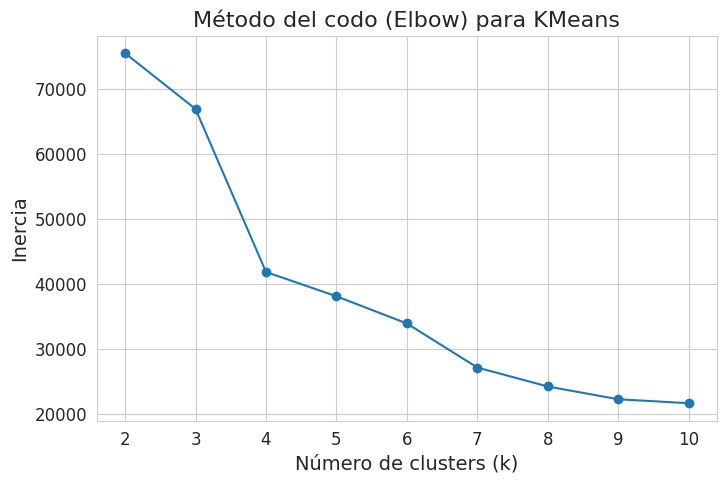

In [ ]:
inertias = []
ks = range(2, 11)
for k in ks:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_scaled_t)
    inertias.append(kmeans.inertia_)

# Graficar el codo
plt.figure(figsize=(8, 5))
plt.plot(ks, inertias, marker='o')
plt.title('Método del codo (Elbow) para KMeans')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Inercia')
plt.grid(True)
plt.show()

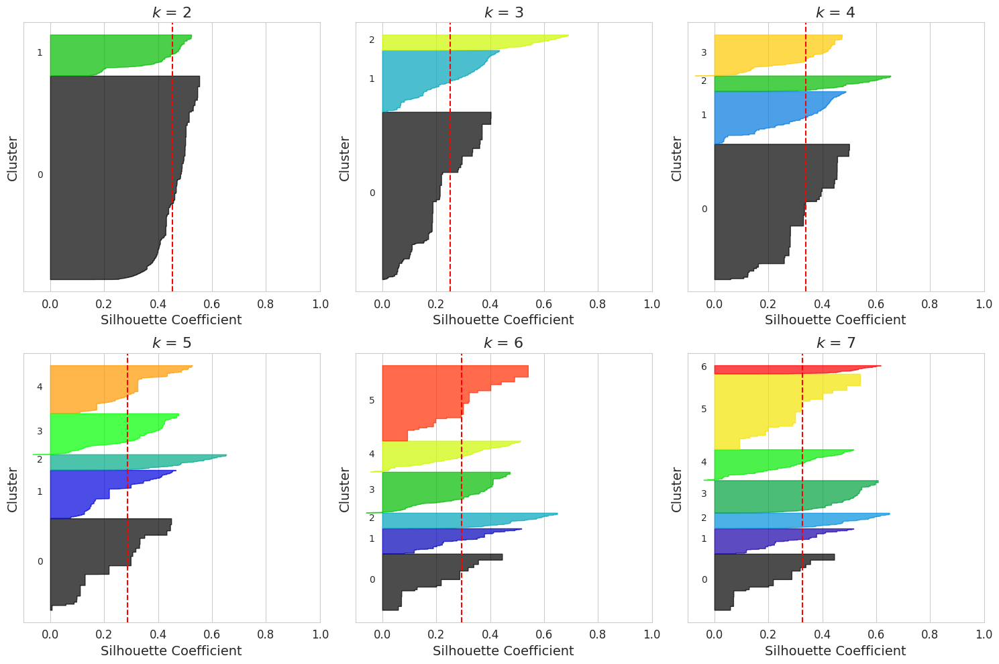

In [ ]:
range_n_clusters = [2, 3, 4, 5, 6, 7]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))
axs = axs.flatten()

for idx, n_clusters in enumerate(range_n_clusters):
    ax = axs[idx]
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(df_scaled_t)

    silhouette_avg = silhouette_score(df_scaled_t, cluster_labels)
    sample_silhouette_values = silhouette_samples(df_scaled_t, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax.fill_betweenx(np.arange(y_lower, y_upper),
                         0, ith_cluster_silhouette_values,
                         facecolor=color, edgecolor=color, alpha=0.7)

        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10  # espacio entre clusters

    ax.set_title(f"$k$ = {n_clusters}")
    ax.set_xlabel("Silhouette Coefficient")
    ax.set_ylabel("Cluster")
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax.set_xlim([-0.1, 1])
    ax.set_yticks([])

plt.tight_layout()
plt.show()

In [ ]:
# 📌 KMeans con 4 clusters
kmeans = KMeans(n_clusters=4, random_state=42)
labels_kmeans = kmeans.fit_predict(df_scaled_t)

sil_k = silhouette_score(df_scaled_t, labels_kmeans)
db_k = davies_bouldin_score(df_scaled_t, labels_kmeans)

print("\n📌 Resultados - KMeans (k = 4):")
print(f"  Silhouette Score = {sil_k:.3f}")
print(f"  Davies-Bouldin Index = {db_k:.3f}")

dist_kmeans = pd.Series(labels_kmeans).value_counts().sort_index()
for cluster_id, count in dist_kmeans.items():
    perc = count / total_obs_t * 100
    print(f"    Cluster {cluster_id} → {count} clientes ({perc:.2f}%)")


📌 Resultados - KMeans (k = 4):
  Silhouette Score = 0.338
  Davies-Bouldin Index = 1.024
    Cluster 0 → 6058 clientes (55.48%)
    Cluster 1 → 2346 clientes (21.49%)
    Cluster 2 → 689 clientes (6.31%)
    Cluster 3 → 1826 clientes (16.72%)


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


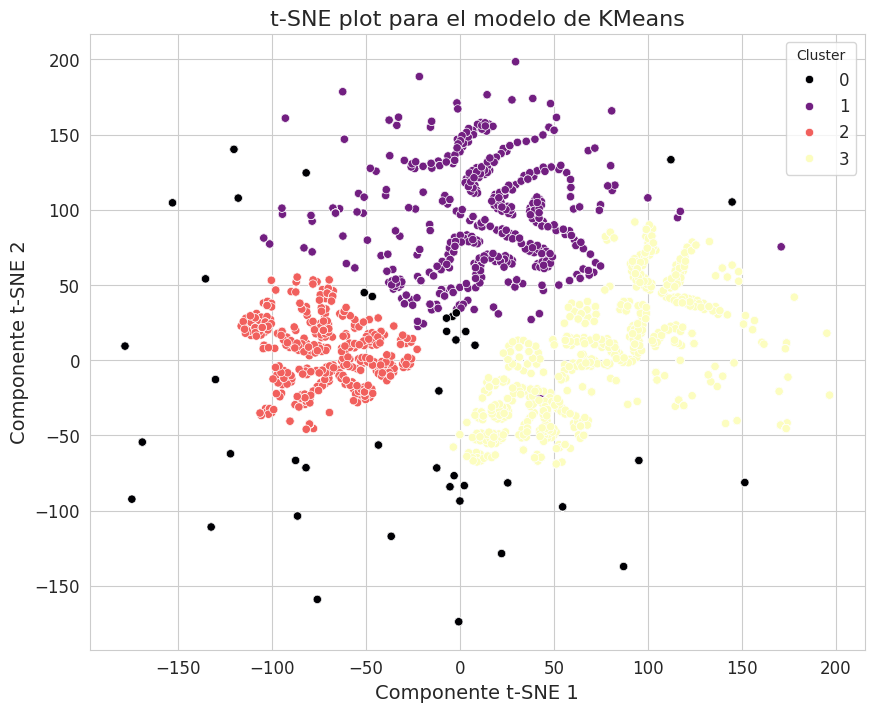

In [ ]:
# Ejecutar t-SNE sobre los datos escalados
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
X_tsne = tsne.fit_transform(df_scaled_t)

# Crear DataFrame con los resultados t-SNE y etiquetas de KMeans
df_tsne = pd.DataFrame(X_tsne, columns=['tSNE_1', 'tSNE_2'])
df_tsne['Cluster'] = labels_kmeans  # usa etiquetas del modelo KMeans

# Gráfico
plt.figure(figsize=(10, 8))
sns.scatterplot(
    x='tSNE_1', y='tSNE_2',
    hue='Cluster',
    palette='magma',
    data=df_tsne,
    legend='full'
)

plt.title('t-SNE plot para el modelo de KMeans')
plt.xlabel('Componente t-SNE 1')
plt.ylabel('Componente t-SNE 2')
plt.legend(title='Cluster')
plt.show()

<ipython-input-118-44a5fd669f11>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=cluster_counts.index, y=cluster_counts.values, palette='deep')


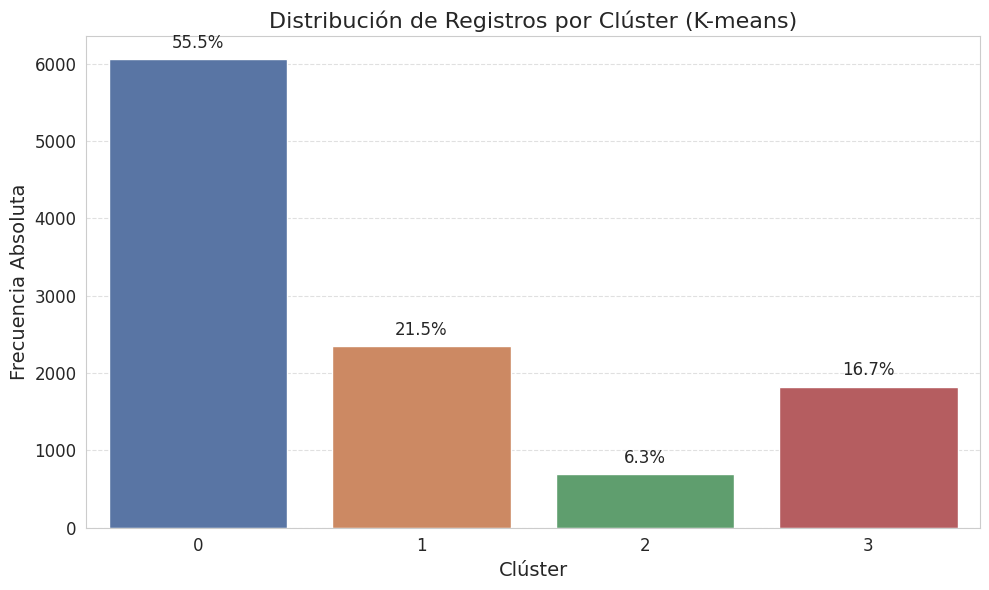

In [ ]:
# Crear DataFrame con etiquetas del modelo KMeans
df_kmeans_dist = pd.DataFrame({'Cluster': labels_kmeans})

# Contar registros por clúster
cluster_counts = df_kmeans_dist['Cluster'].value_counts().sort_index()
cluster_percent = cluster_counts / cluster_counts.sum() * 100

# Gráfico de barras
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=cluster_counts.index, y=cluster_counts.values, palette='deep')

# Etiquetas con porcentaje sobre las barras
for i, count in enumerate(cluster_counts):
    plt.text(i, count + 100, f"{cluster_percent[i]:.1f}%", ha='center', va='bottom', fontsize=12)

plt.title('Distribución de Registros por Clúster (K-means)')
plt.xlabel('Clúster')
plt.ylabel('Frecuencia Absoluta')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

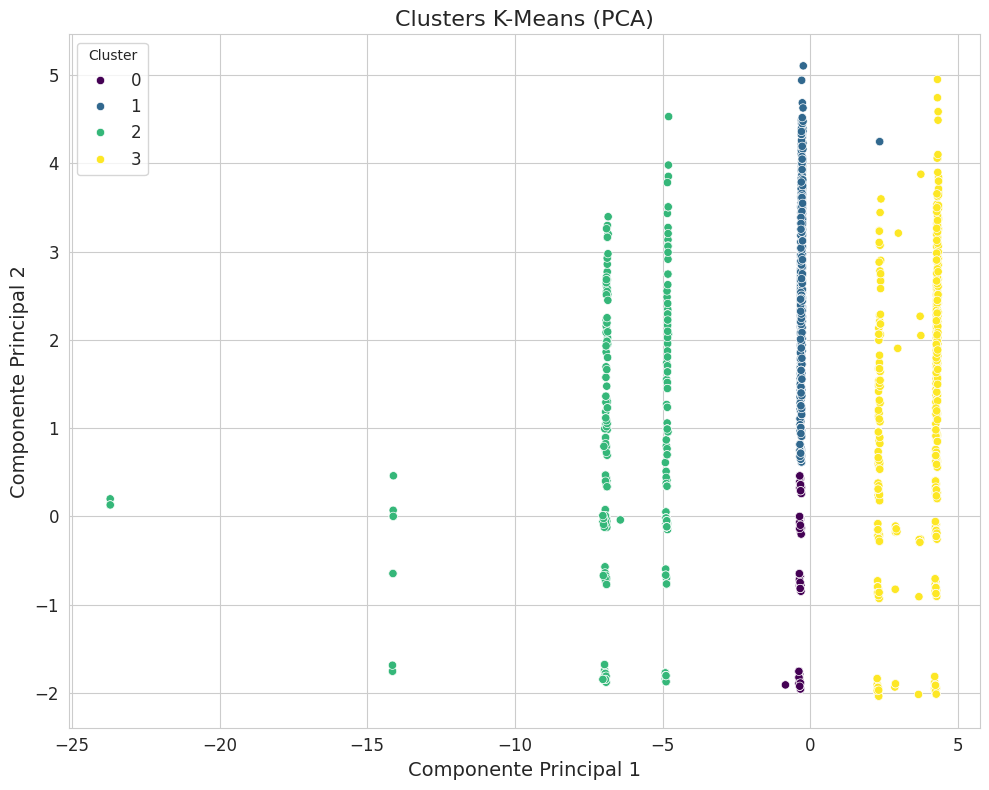

In [ ]:
# Aplicar PCA para reducir a 2 componentes
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(df_scaled_t)

# Crear DataFrame para graficar
df_pca = pd.DataFrame(X_pca, columns=['PCA_1', 'PCA_2'])
df_pca['Cluster'] = labels_kmeans

# Gráfico
plt.figure(figsize=(10, 8))
sns.scatterplot(
    x='PCA_1', y='PCA_2',
    hue='Cluster',
    palette='viridis',
    data=df_pca,
    legend='full'
)

plt.title('Clusters K-Means (PCA)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster')
plt.tight_layout()
plt.show()

### Jerarquico

In [ ]:
# 🔹 Subset t (Subset 5)
columnas_subset_t = [
    'Genero_label', 'log_promedio_gasto_segmento',
    'log_segmento_plan', 'categoria_lim_crediticio_label',
    'log_duracion_estado_actual', 'log_clv_estimado'
]

print("\n🔍 Evaluando Subset t (Subset 5)")
df_subset_t = consolidado_hiper2[columnas_subset_t].copy()

# 🔹 Escalamiento
df_scaled_t = StandardScaler().fit_transform(df_subset_t)
total_obs_t = df_subset_t.shape[0]

# 📌 Clustering Jerárquico con 3 clusters
agglo = AgglomerativeClustering(n_clusters=3)
labels_agglo = agglo.fit_predict(df_scaled_t)

sil_a = silhouette_score(df_scaled_t, labels_agglo)
db_a = davies_bouldin_score(df_scaled_t, labels_agglo)

print("\n📌 Resultados - Clustering Jerárquico (k = 3):")
print(f"  Silhouette Score = {sil_a:.3f}")
print(f"  Davies-Bouldin Index = {db_a:.3f}")

dist_agglo = pd.Series(labels_agglo).value_counts().sort_index()
for cluster_id, count in dist_agglo.items():
    perc = count / total_obs_t * 100
    print(f"    Cluster {cluster_id} → {count} clientes ({perc:.2f}%)")


🔍 Evaluando Subset t (Subset 5)

📌 Resultados - Clustering Jerárquico (k = 3):
  Silhouette Score = 0.497
  Davies-Bouldin Index = 0.918
    Cluster 0 → 8402 clientes (76.95%)
    Cluster 1 → 1828 clientes (16.74%)
    Cluster 2 → 689 clientes (6.31%)


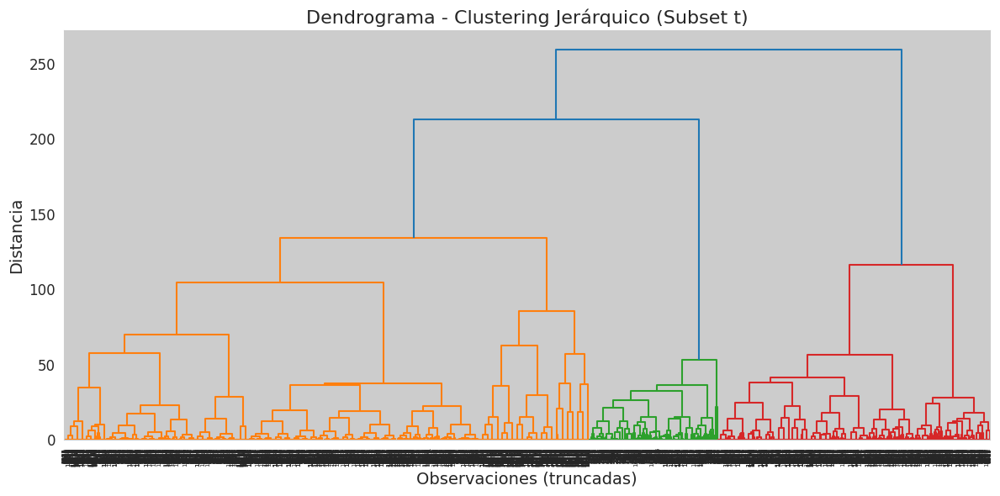

In [ ]:
# Calcular la matriz de enlaces con método ward (puedes probar también 'average', 'complete', etc.)
linked = linkage(df_scaled_t, method='ward')

# Dendrograma
plt.figure(figsize=(12, 6))
dendrogram(linked,
           truncate_mode='level',  # Para no mostrar todos los puntos
           p=30,                   # Número de niveles que se muestran
           distance_sort='descending',
           show_leaf_counts=False)

plt.title("Dendrograma - Clustering Jerárquico (Subset t)")
plt.xlabel("Observaciones (truncadas)")
plt.ylabel("Distancia")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


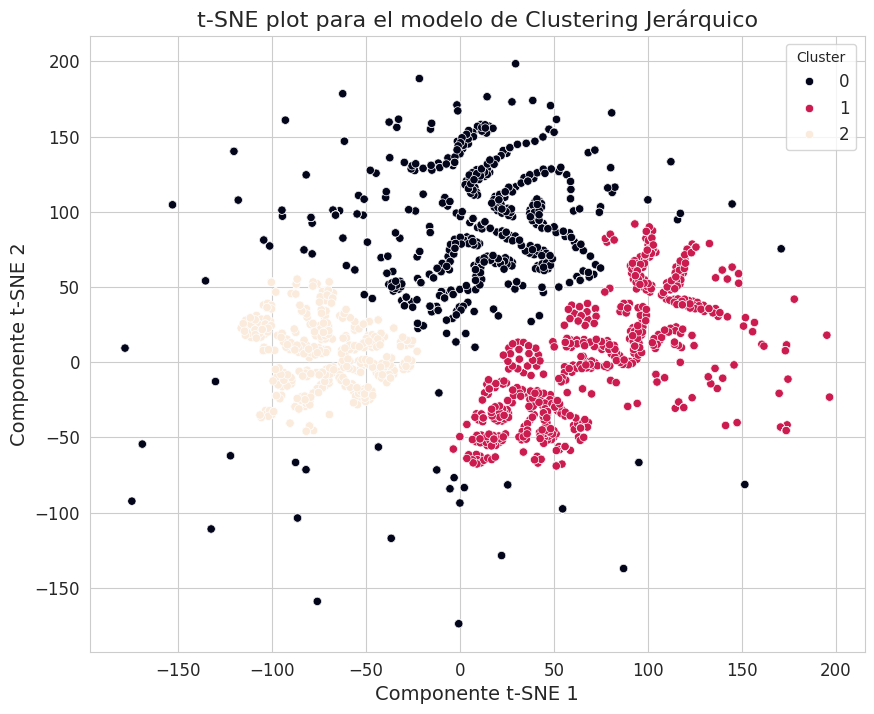

In [ ]:
# Ejecutar t-SNE
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
X_tsne_agglo = tsne.fit_transform(df_scaled_t)

# DataFrame para visualización
df_tsne_agglo = pd.DataFrame(X_tsne_agglo, columns=['tSNE_1', 'tSNE_2'])
df_tsne_agglo['Cluster'] = labels_agglo

# Gráfico
plt.figure(figsize=(10, 8))
sns.scatterplot(
    x='tSNE_1', y='tSNE_2',
    hue='Cluster',
    palette='rocket',
    data=df_tsne_agglo,
    legend='full'
)

plt.title('t-SNE plot para el modelo de Clustering Jerárquico')
plt.xlabel('Componente t-SNE 1')
plt.ylabel('Componente t-SNE 2')
plt.legend(title='Cluster')
plt.show()

<ipython-input-123-5ec79f46e68c>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=cluster_counts_agglo.index, y=cluster_counts_agglo.values, palette='muted')


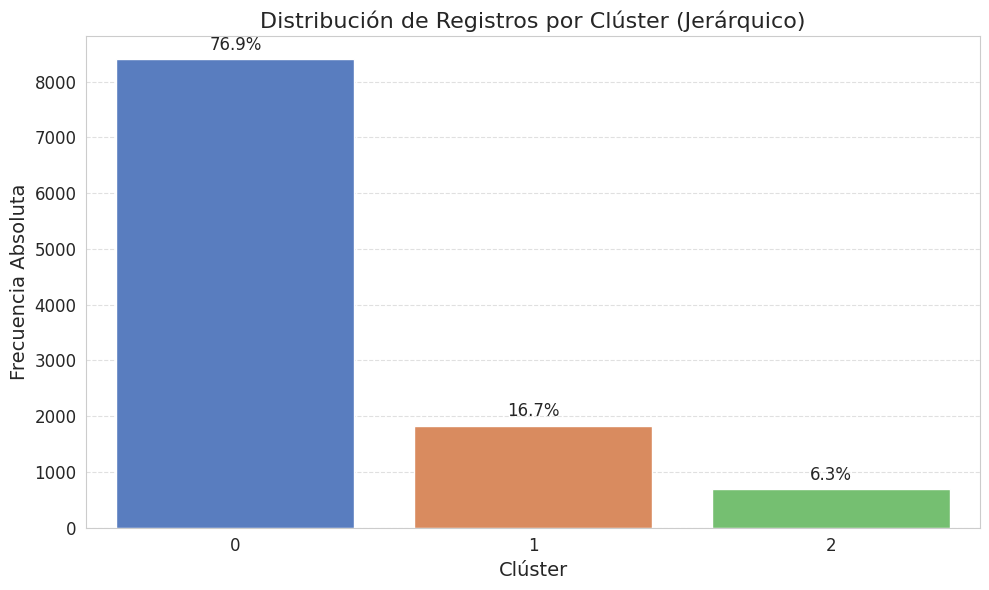

In [ ]:
# Conteo y porcentaje por clúster
df_agglo_dist = pd.DataFrame({'Cluster': labels_agglo})
cluster_counts_agglo = df_agglo_dist['Cluster'].value_counts().sort_index()
cluster_percent_agglo = cluster_counts_agglo / cluster_counts_agglo.sum() * 100

# Gráfico de barras
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=cluster_counts_agglo.index, y=cluster_counts_agglo.values, palette='muted')

# Etiquetas de porcentaje
for i, count in enumerate(cluster_counts_agglo):
    plt.text(i, count + 100, f"{cluster_percent_agglo[i]:.1f}%", ha='center', va='bottom', fontsize=12)

plt.title('Distribución de Registros por Clúster (Jerárquico)')
plt.xlabel('Clúster')
plt.ylabel('Frecuencia Absoluta')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


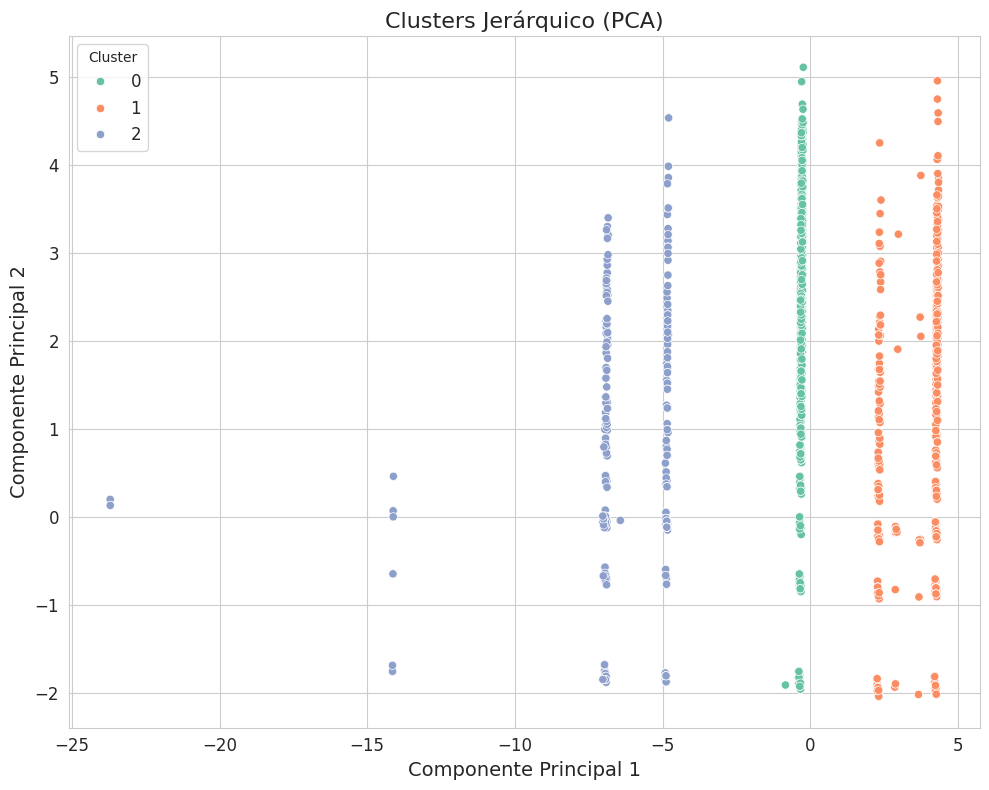

In [ ]:
# Aplicar PCA
pca = PCA(n_components=2, random_state=42)
X_pca_agglo = pca.fit_transform(df_scaled_t)

# DataFrame PCA
df_pca_agglo = pd.DataFrame(X_pca_agglo, columns=['PCA_1', 'PCA_2'])
df_pca_agglo['Cluster'] = labels_agglo

# Gráfico
plt.figure(figsize=(10, 8))
sns.scatterplot(
    x='PCA_1', y='PCA_2',
    hue='Cluster',
    palette='Set2',
    data=df_pca_agglo,
    legend='full'
)

plt.title('Clusters Jerárquico (PCA)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster')
plt.tight_layout()
plt.show()


<ipython-input-125-323eeed1a75d>:14: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


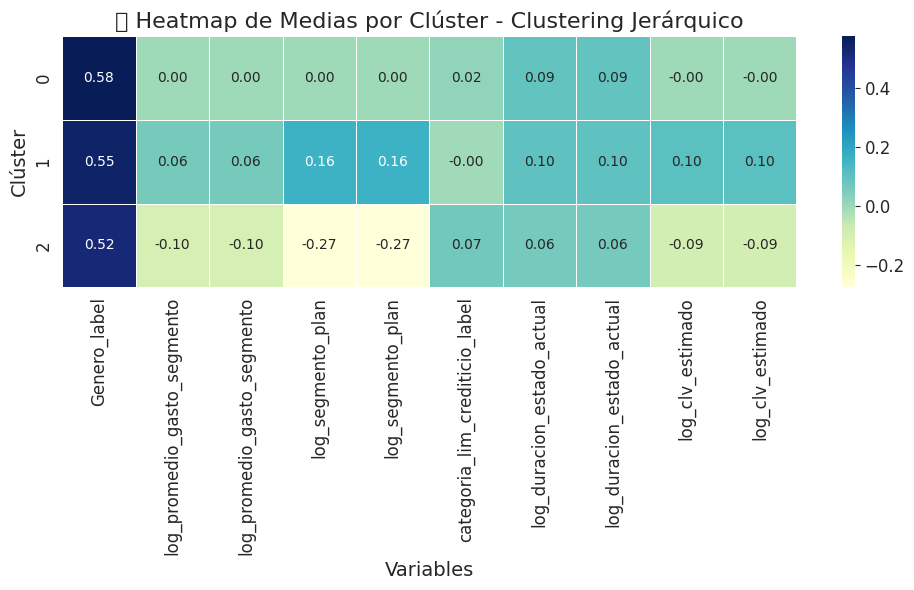

In [ ]:
# Asignar etiquetas de clúster al DataFrame original
df_clustered_agglo = df_subset_t.copy()
df_clustered_agglo['Cluster'] = labels_agglo

# Calcular medias por clúster
cluster_means_agglo = df_clustered_agglo.groupby('Cluster').mean()

# Crear heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(cluster_means_agglo, annot=True, fmt=".2f", cmap="YlGnBu", linewidths=0.5)
plt.title("🔥 Heatmap de Medias por Clúster - Clustering Jerárquico")
plt.xlabel("Variables")
plt.ylabel("Clúster")
plt.tight_layout()
plt.show()


El clustering jerárquico es un método de agrupamiento que organiza los datos en una estructura tipo árbol, permitiendo visualizar relaciones entre grupos en un dendrograma. Funciona de la siguiente manera:

Inicialización: Cada observación comienza como un cluster separado.
Fusión iterativa: En cada paso, los clusters más similares se combinan hasta que todos los puntos forman un solo cluster.
Selección de K clusters: Se corta el dendrograma en un nivel determinado (como K=4 en este caso), generando los grupos finales.


📌 Índice de Silhouette

Evalúa qué tan bien separadas están las observaciones dentro de sus clusters.
Valores cercanos a 1 indican una segmentación clara, mientras que valores bajos sugieren superposición entre clusters.
0.269 es un valor bajo, lo que indica que los clusters pueden no estar bien definidos.

📌 Índice de Davies-Bouldin

Mide la separación entre clusters y su compactación interna.
Un valor más bajo indica clusters bien diferenciados.
1.4221 es un valor moderado, lo que sugiere que algunos clusters podrían estar demasiado dispersos.


El dendrograma muestra cómo se agrupan las observaciones y nos permite visualizar la estructura de los clusters.

